# Init

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm, SymLogNorm, TwoSlopeNorm
import matplotlib.colors as colors
import qcodes as qc
import qcodes.instrument_drivers.nplab_drivers as npd
from scipy.optimize import curve_fit
from scipy.interpolate import interp2d, interp1d
from os import path
import colorcet as cc   # install quickly with "conda install colorcet"
from scipy.interpolate import RectBivariateSpline
from matplotlib import ticker
from scipy.ndimage import gaussian_filter
import matplotlib as mpl
from lmfit import Model
from scipy.signal import find_peaks
import caltechdata_api
from zipfile import ZipFile

In [2]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams['figure.dpi'] = 300
%config InlineBackend.figure_format = 'svg'  # with this, we need to raster the pcolormesh images with rasterized=True
# and save with .svg in the filename. don't worry. The annoying white line/offset in the image doesn't seem to show up if you use dpi=something while saving

In [3]:
# plt.rcParams['font.sans-serif'] = ['Arial',  # make Arial the standard font
#  'DejaVu Sans',
#  'Bitstream Vera Sans',
#  'Computer Modern Sans Serif',
#  'Lucida Grande',
#  'Verdana',
#  'Geneva',
#  'Lucid',
#  'Helvetica',
#  'Avant Garde',
#  'sans-serif']

# plt.rcParams['font.size'] = 12

font = {
                'family': 'Arial',
                'size': 12,
                'serif': 'Times',
                'sans-serif': 'Arial'
            }

plt.rc('font', **font)

In [4]:
# %matplotlib notebook  # this is what I started out using  # or %matplotlib widget in jupyter lab

In [5]:
cd ..

/Users/robertpolski/Documents/NPGroupResearch/Measurements/Triton/qcodes_data


In [6]:
qc.DataSet.default_io.base_location = path.abspath('.')
figfile = path.abspath('.') + '/Figures/TBGWSe2PaperPlots_Robbie/'
BaseTfile = path.abspath('.') + '/Figures/HierarchyCorrelationsPaper/BaseT/'

In [7]:
Peakfile = path.abspath('.') + '/Figures/HierarchyCorrelationsPaper/' + 'Peaks/'

In [ ]:
# For downloading from CaltechDATA
dname = caltechdata_api.download_file('10.22002/D1.20151', 'data.zip')
with ZipFile('data.zip', 'r') as zip:
    zip.extractall()

In [8]:
def plotbox(xmin, xmax, ymin, ymax, xarr, yarr, color):
    plt.hlines([ymin, ymax], xmin, xmax, colors=color)
    plt.vlines([xmin, xmax], ymin, ymax, colors=color)
    print('xints:', npd.val_to_index([xmin, xmax], xarr))
    print('yints:', npd.val_to_index([ymin, ymax], yarr))

# Landau Fans 

## 0.97$^\circ$, Device M08

In [9]:
#Rxx was 38-37, Rxy was 38-44

datafan3837 = qc.load_data('data/2019-10-06/#003_0to8TtwodSweep_0.5nAexcM08_Rxx38-37_Rxy38-44_basetemp_161fieldpts_16-35-30')

Rxx3837 = npd.Rxxfromdata(datafan3837, 0.5e-9, instrument='lockin865')[:, 16:]
Rxy3844 = npd.Rxxfromdata(datafan3837, 0.5e-9, instrument='lockin830')[:, 16:]
sigmaxy3844 = -Rxy3844/(Rxy3844**2 + Rxx3837**2)
gfan3837 = datafan3837.srframe_volt_p1_set[0, 16:]
fieldsfan3837 = datafan3837.triton_field_set_stable_set[:]

Convert Vbg to filling factor (-4 to 4)

In [10]:
sl, b = (-11.09489539598033, 3.831927327596076)
C = -sl*1.602e-19**2/6.626e-34
dBN = 3*8.85e-12/C
V0 = -b/sl
print('effective capacitance: {:.4e}'.format(C))
print('effective hBN thickness: {:.1f} nm'.format(dBN*10**9))
V0 -= 0.015
print('V0: ', V0)

effective capacitance: 4.2973e-04
effective hBN thickness: 61.8 nm
V0:  0.33037750837960844


In [11]:
slf, bf = (-11.684640404016196, -90.57221927031419)
V0fullh = -bf/slf
Vgatefull = V0-V0fullh
print('Full filling voltage difference: {}'.format(Vgatefull))
nfull = (V0 - V0fullh)*C/1.602e-19/10**4
print(nfull/10**12) #10**12 cm^-2
a = 0.246e-9

theta = np.sqrt(np.sqrt(3)*nfull*10**4*a**2/8)*180/np.pi
print('theta: ', theta)

Full filling voltage difference: 8.081768748385855
2.167907319080984
theta:  0.9656359268823933


In [12]:
filling3837 = np.interp(gfan3837, [V0 - Vgatefull*5/4, V0 + Vgatefull*5/4], [-5, 5])

Full size (0 to 8T)

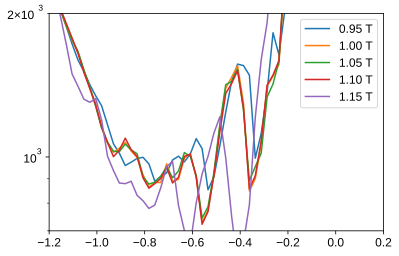

In [13]:
plt.figure()  # you can see here that three curves line up too well with each other: 1.00, 1.05, 1.10. Delete 1.05 and 1.10 and interpolate.
plt.semilogy(filling3837, Rxx3837[19])
plt.semilogy(filling3837, Rxx3837[20])
plt.semilogy(filling3837, Rxx3837[21])
plt.semilogy(filling3837, Rxx3837[22])
plt.semilogy(filling3837, Rxx3837[23])
# plt.semilogy(filling3837, Rxx3837[24])
plt.ylim((0.7e3, 2e3))
plt.xlim((-1.2, 0.2))
plt.legend(['0.95 T', '1.00 T', '1.05 T', '1.10 T', '1.15 T'])

In [14]:
fieldsfan3837[21:23]

array([1.05, 1.1 ])

In [15]:
corrRxx3837 = np.copy(Rxx3837)
corrRxx3837[corrRxx3837 <= 0] = np.min(np.abs(corrRxx3837))

indices = [i not in (21, 22) for i in range(len(fieldsfan3837))]  # deleting 1.05, 1.10 T
Rxx3837func = RectBivariateSpline(filling3837[:-24][::-1], fieldsfan3837[indices], np.flip(corrRxx3837[indices, :-24], axis=1).T, kx=1, ky=1)

Text(0, 0.5, '$\\mu_0$ H (T)')

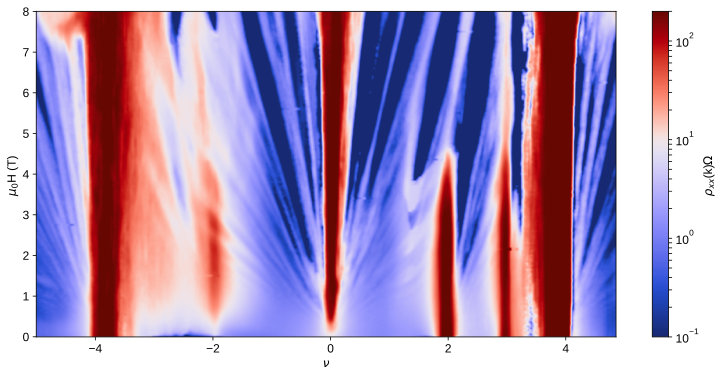

In [16]:
x = np.linspace(-5, 4.85, 1001)
y = np.linspace(0, 8, 1201)
Rxx3837int = gaussian_filter(Rxx3837func(x, y), (1.2, 1.2)).T

fig, ax = plt.subplots(figsize=(13, 6))
p = ax.pcolormesh(x, y, Rxx3837int/1000, norm=npd.DivLogNorm(0.6, vmin=100/1000, vmax=2e5/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
cb = plt.colorbar(p, ticks=ticker.LogLocator(subs=range(10)), ax=ax,  format=ticker.LogFormatterMathtext(), label=r'$\rho$'+'$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('$\mu_0$ H (T)')
# plt.savefig(figfile + 'M08_0p97fan_to8T_log.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, '$\\mu_0$ H (T)')

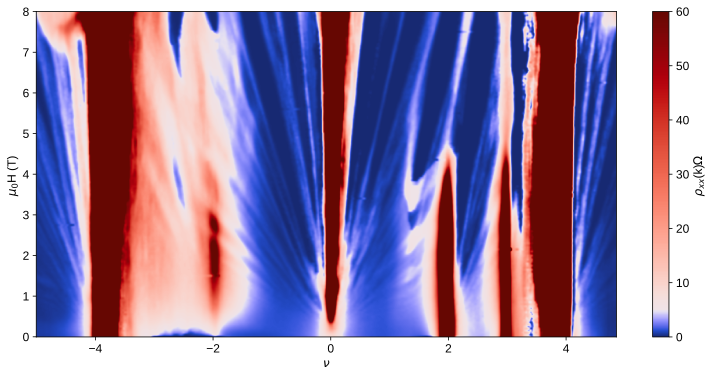

In [17]:
x = np.linspace(-5, 4.85, 1001)
y = np.linspace(0, 8, 1201)
Rxx3837int = gaussian_filter(Rxx3837func(x, y), (1.2, 1.2)).T

fig, ax = plt.subplots(figsize=(13, 6))
p = ax.pcolormesh(x, y, Rxx3837int/1000, norm=colors.TwoSlopeNorm(5000/1000, vmin=0, vmax=0.6e5/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
cb = plt.colorbar(p, ax=ax, label=r'$\rho$'+'$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('$\mu_0$ H (T)')
# plt.savefig(figfile + 'M08_0p97fan_to8T_linear.svg', dpi=300, bbox_inches='tight')

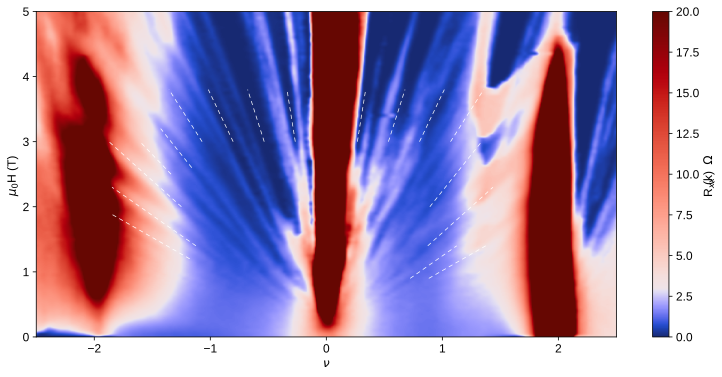

In [18]:
# map out the diagram about the CNP

x = np.linspace(-5, 4.85, 1001)
y = np.linspace(0, 8, 1201)
Rxx3837int = gaussian_filter(Rxx3837func(x, y), (1.2, 1.2)).T

fig, ax = plt.subplots(figsize=(13, 6))
p = ax.pcolormesh(x, y, Rxx3837int/1000, norm=colors.TwoSlopeNorm(3000/1000, vmin=0, vmax=0.2e5/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
cb = plt.colorbar(p, ax=ax, label=r'R'+'$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('$\mu_0$ H (T)')
ax.axis((-2.5, 2.5, 0, 5))

sl, b = (-11.09489539598033, 0)
Vgatefull = 8.081768748385855
slfill = -sl*Vgatefull/4

Bl = 3.8
Bs = 3
LW = 0.7
dashes = (6, 5)
for i in [-8, -6, -4, -2, 2, 4, 6, 8]:
    x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
    plt.plot(x, (x*slfill + b)/i, '--', color='white', lw=LW, dashes=dashes)
    
Bl = 3
Bs = 2.5
i = -12
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, '--', color='white', lw=LW, dashes=dashes)

Bl = 3.2
Bs = 2.6
i = -10
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 3
Bs = 2
i = 10
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

Bl = 2.3
Bs = 1.4
i = 14
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

Bl = 1.4
Bs = 0.9
i = 18
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

Bl = 1.4
Bs = 0.9
i = 22
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 3
Bs = 2
i = -14
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 2.3
Bs = 1.4
i = -18
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

Bl = 1.9
Bs = 1.2
i = -22
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

# plt.savefig(figfile + 'M08_0p97fan_to8T_linear_map5T.svg', dpi=300, bbox_inches='tight')

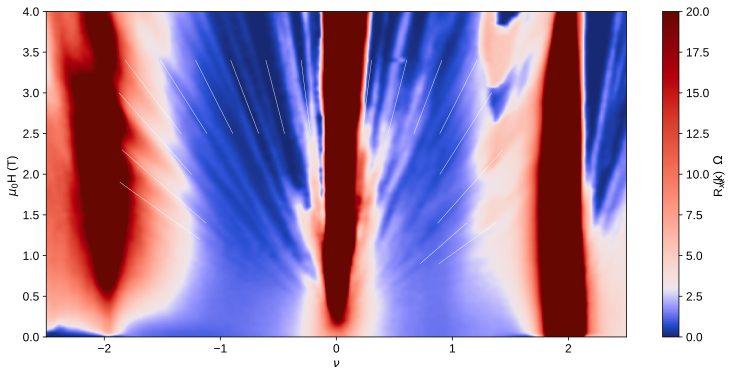

In [19]:
# map out the diagram about the CNP

x = np.linspace(-5, 4.85, 1001)
y = np.linspace(0, 8, 1201)
Rxx3837int = gaussian_filter(Rxx3837func(x, y), (1.2, 1.2)).T

fig, ax = plt.subplots(figsize=(13, 6))
p = ax.pcolormesh(x, y, Rxx3837int/1000, norm=colors.TwoSlopeNorm(3000/1000, vmin=0, vmax=0.2e5/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
cb = plt.colorbar(p, ax=ax, label=r'R'+'$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('$\mu_0$ H (T)')
ax.axis((-2.5, 2.5, 0, 4))

sl, b = (-11.09489539598033, 0)
Vgatefull = 8.081768748385855
slfill = -sl*Vgatefull/4

Bl = 3.4
Bs = 2.5
LW = 0.4
for i in [-12, -10, -8, -6, -4, -2, 2, 4, 6, 8]:
    x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
    
Bl = 3
Bs = 2
i = 10
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)

Bl = 2.3
Bs = 1.4
i = 14
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)

Bl = 1.4
Bs = 0.9
i = 18
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)

Bl = 1.4
Bs = 0.9
i = 22
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
    
Bl = 3
Bs = 2
i = -14
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
    
Bl = 2.3
Bs = 1.4
i = -18
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)

Bl = 1.9
Bs = 1.2
i = -22
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
# plt.savefig(figfile + 'M08_0p97fan_to8T_linear_map4T.svg', dpi=300, bbox_inches='tight')

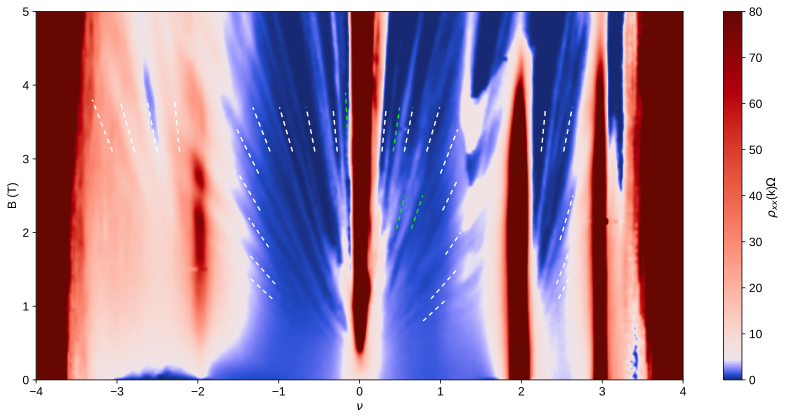

In [20]:
x = np.linspace(-5, 4.85, 1001)
y = np.linspace(0, 8, 1201)
Rxx3837int = gaussian_filter(Rxx3837func(x, y), (1, 1)).T
fig, ax = plt.subplots(figsize=(12, 6))
p = ax.pcolormesh(x, y, Rxx3837int/1000, norm=TwoSlopeNorm(vmin=0, vcenter=4500/1000, vmax=8e4/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
cb = plt.colorbar(p, ax=ax, label=r'$\rho$'+'$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('B (T)')
plt.ylim((0, 5))
plt.yticks(range(6))
# plt.xticks(range(-4, 5), [])
plt.xlim((-4, 4))
plt.tight_layout()

sl, b = (11.09489539598033, 0)
Vgatefull = 8.081768748385855
slfill = sl*Vgatefull/4

# old set of lines
# Bl = 3.4
# Bs = 2.75
# for i in [-6, -4, -2, 2, 4, 6]:
#     x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
#     plt.plot(x, (x*slfill + b)/i, color='white')

# new set of lines
Bl = 3.7
Bs = 3.1
LW = 1.3
boldLW = 1.4
dashes = (3.4, 3) #(6, 5)
bolddashes = (3.4, 3)
oddcolor = tuple(np.array([0, 243, 15])/255)
for i in [-8, -6, -4, -2, 2, 4, 6]:
    x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
    plt.plot(x, (x*slfill + b)/i, '--', color='white', lw=boldLW, dashes=bolddashes)
    
Bl = 3.4
Bs = 2.8
i = 8
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=boldLW, dashes=bolddashes)
    
Bl = 2.8
Bs = 2.3
i = -12
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, '--', color='white', lw=boldLW, dashes=bolddashes)

Bl = 3.4
Bs = 2.8
i = -10
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=boldLW, dashes=bolddashes)
    
Bl = 2.7
Bs = 2.3
i = 10
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=boldLW, dashes=bolddashes)

Bl = 3.9
Bs = 3.3
i = -1
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color=oddcolor, lw=LW, dashes=dashes)

Bl = 3.7
Bs = 3.1
i = 3
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color=oddcolor, lw=LW, dashes=dashes)

Bl = 2.5
Bs = 2.05
i = 5
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color=oddcolor, lw=LW, dashes=dashes)

Bl = 2.5
Bs = 2.05
i = 7
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color=oddcolor, lw=LW, dashes=dashes)

Bl = 2
Bs = 1.7
i = 14
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

Bl = 1.5
Bs = 1.1
i = 18
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

Bl = 1.1
Bs = 0.8
i = 22
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 2.2
Bs = 1.8
i = -14
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 1.7
Bs = 1.3
i = -18
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

Bl = 1.4
Bs = 1.1
i = -22
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

Bl = 3.7
Bs = 3.1
V0half = 2-0.03
b = -V0half*slfill
for i in [2, 4]:
    x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
    plt.plot(x, (x*slfill + b)/i, '--', color='white', lw=boldLW, dashes=bolddashes)

Bl = 2.5
Bs = 1.9
i = 6
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, '--', color='white', lw=boldLW, dashes=bolddashes)

Bl = 1.7
Bs = 1.3
i = 8
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, '--', color='white', lw=boldLW, dashes=bolddashes)

Bl = 1.4
Bs = 1.1
i = 10
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, '--', color='white', lw=boldLW, dashes=bolddashes)

Bl = 3.8
Bs = 3.1
V0half = -2+0.05
b = -V0half*slfill
for i in [-2, -4, -6, -8]:
    x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
    plt.plot(x, (x*slfill + b)/i, '--', color='white', lw=boldLW, dashes=bolddashes)

plt.tight_layout()

# plt.savefig(figfile + 'M08_0p97fan_to5T_filling_linear_withlines.svg', bbox_inches='tight', dpi=300)

Only to 4 T now

(-4.0, 4.0)

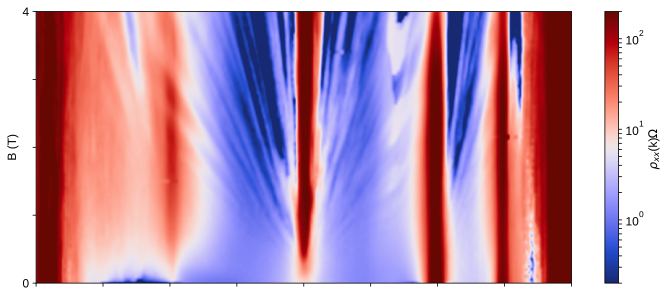

In [21]:
x = np.linspace(-5, 4.85, 1001)
y = np.linspace(0, 8, 1201)
Rxx3837int = gaussian_filter(Rxx3837func(x, y), (1, 1)).T
fig, ax = plt.subplots(figsize=(12, 5))
p = ax.pcolormesh(x, y, Rxx3837int/1000, norm=npd.DivLogNorm(0.5, vmin=200/1000, vmax=2e5/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
cb = plt.colorbar(p, ticks=ticker.LogLocator(subs=range(10)), ax=ax,  format=ticker.LogFormatterMathtext(), label=r'$\rho$'+'$_{xx}$ (k$\Omega$)')
# plt.xlabel(r'$\nu$')
plt.ylabel('B (T)')
plt.ylim((0, 4))
plt.yticks(range(5), [0, '', '', '', 4])
plt.xticks(range(-4, 5), [])
plt.xlim((-4, 4))
# plt.savefig(figfile + 'M08_0p97fan_to4T_filling_log.svg', bbox_inches='tight', dpi=300)

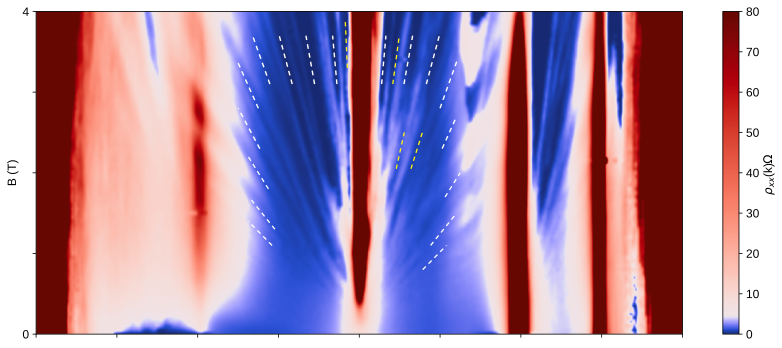

In [23]:
x = np.linspace(-5, 4.85, 1001)
y = np.linspace(0, 8, 1201)
Rxx3837int = gaussian_filter(Rxx3837func(x, y), (1, 1)).T
fig, ax = plt.subplots(figsize=(12, 5))
p = ax.pcolormesh(x, y, Rxx3837int/1000, norm=TwoSlopeNorm(vmin=0, vcenter=4500/1000, vmax=8e4/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
cb = plt.colorbar(p, ax=ax, label=r'$\rho$'+'$_{xx}$ (k$\Omega$)')
# plt.xlabel(r'$\nu$')
plt.ylabel('B (T)')
plt.ylim((0, 4))
plt.yticks(range(5), [0, '', '', '', 4])
plt.xticks(range(-4, 5), [])
plt.xlim((-4, 4))
plt.tight_layout()

sl, b = (11.09489539598033, 0)
Vgatefull = 8.081768748385855
slfill = sl*Vgatefull/4

# old set of lines
# Bl = 3.4
# Bs = 2.75
# for i in [-6, -4, -2, 2, 4, 6]:
#     x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
#     plt.plot(x, (x*slfill + b)/i, color='white')

# new set of lines
Bl = 3.7
Bs = 3.1
LW = 1.3
boldLW = 1.4
dashes = (3.4, 3) #(6, 5)
bolddashes = (3.4, 3)
oddcolor = tuple(np.array([255, 243, 15])/255)
for i in [-8, -6, -4, -2, 2, 4, 6]:
    x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
    plt.plot(x, (x*slfill + b)/i, '--', color='white', lw=boldLW, dashes=bolddashes)
    
Bl = 3.4
Bs = 2.8
i = 8
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=boldLW, dashes=bolddashes)
    
Bl = 2.8
Bs = 2.3
i = -12
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, '--', color='white', lw=boldLW, dashes=bolddashes)

Bl = 3.4
Bs = 2.8
i = -10
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=boldLW, dashes=bolddashes)
    
Bl = 2.7
Bs = 2.3
i = 10
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=boldLW, dashes=bolddashes)

Bl = 3.9
Bs = 3.3
i = -1
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color=oddcolor, lw=LW, dashes=dashes)

Bl = 3.7
Bs = 3.1
i = 3
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color=oddcolor, lw=LW, dashes=dashes)

Bl = 2.5
Bs = 2.05
i = 5
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color=oddcolor, lw=LW, dashes=dashes)

Bl = 2.5
Bs = 2.05
i = 7
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color=oddcolor, lw=LW, dashes=dashes)

Bl = 2
Bs = 1.7
i = 14
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

Bl = 1.5
Bs = 1.1
i = 18
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

Bl = 1.1
Bs = 0.8
i = 22
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 2.2
Bs = 1.8
i = -14
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 1.7
Bs = 1.3
i = -18
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

Bl = 1.4
Bs = 1.1
i = -22
x = np.linspace((Bs*i - b)/slfill, (Bl*i - b)/slfill, 5)
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

plt.tight_layout()

# plt.savefig(figfile + 'M08_0p97fan_to4T_filling_linear_mod2.svg', bbox_inches='tight', dpi=300)

## Device M12, 0.98$^\circ$ or 1.04$^\circ$

In [24]:
sl, b = (-14.42471356, -3.01892036)
V0 = -b/sl
V0 += 0.03
print('CNP: {} V'.format(V0))
C = -1*sl*1.602e-19**2/6.626e-34
print('effective capacitance: {:.4e}'.format(C))
dbn = 3*8.85e-12/C
print('dBN effective: {:.2f} nm'.format(dbn*10**9))
slf, bf = (-14.1749849, -93.04225578)
V0fullh = -bf/slf
Vgatefull = V0-V0fullh
print('Full filling voltage difference: {}'.format(Vgatefull))
nfull = Vgatefull*C/1.602e-19/10**4
print(nfull/10**12) #10**12 cm^-2
a = 0.246e-9

theta = np.sqrt(np.sqrt(3)*nfull*10**4*a**2/8)*180/np.pi
print('theta: ', theta)

multfactor = 1.13
nfull_2 = nfull*multfactor
print(nfull*multfactor/10**12)
theta_2 = np.sqrt(np.sqrt(3)*nfull_2*10**4*a**2/8)*180/np.pi
print('theta_2: ', theta_2)

CNP: -0.17928806297904745 V
effective capacitance: 5.5870e-04
dBN effective: 47.52 nm
Full filling voltage difference: 6.38454649743731
2.226631415733886
theta:  0.9786270725607448
2.5160934997792905
theta_2:  1.0402948477610368


In [25]:
datafan1 = qc.load_data('data/2019-10-31/#017_M12_12-13and13-20_LandauFan_17-58-32')
gfan1213 = datafan1.srframe_volt_p1_set[0, 12:]
fieldsfan1213 = datafan1.triton_field_set_stable_set[:-2]
Rxx1213 = npd.Rxxfromdata(datafan1, 0.5e-9, instrument='lockin865')[:-2, 12:]
Rxy1320 = npd.Rxxfromdata(datafan1, 0.5e-9, instrument='lockin830')[:-2, 12:]

In [26]:
# the data that's better resolved in gate space but a little worse in field and used higher excitation current
datafan2 = qc.load_data('data/2019-11-09/#004_M12_22_20and22_12xy_LandauFan_5nA_8Tto-5T_15-30-05')
gfan2022 = datafan2.srframe_volt_p1_set[0, :]
fieldsfan2022 = datafan2.triton_field_set_stable_set[:81]
Rxx2022 = npd.Rxxfromdata(datafan2, 5e-9, instrument='lockin865')[:81, :]

In [27]:
fieldsfan2022[:81]

array([8. , 7.9, 7.8, 7.7, 7.6, 7.5, 7.4, 7.3, 7.2, 7.1, 7. , 6.9, 6.8,
       6.7, 6.6, 6.5, 6.4, 6.3, 6.2, 6.1, 6. , 5.9, 5.8, 5.7, 5.6, 5.5,
       5.4, 5.3, 5.2, 5.1, 5. , 4.9, 4.8, 4.7, 4.6, 4.5, 4.4, 4.3, 4.2,
       4.1, 4. , 3.9, 3.8, 3.7, 3.6, 3.5, 3.4, 3.3, 3.2, 3.1, 3. , 2.9,
       2.8, 2.7, 2.6, 2.5, 2.4, 2.3, 2.2, 2.1, 2. , 1.9, 1.8, 1.7, 1.6,
       1.5, 1.4, 1.3, 1.2, 1.1, 1. , 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3,
       0.2, 0.1, 0. ])

In [28]:
filling1213 = np.interp(gfan1213, [V0 - Vgatefull*6/4, V0 + Vgatefull*6/4], [-6, 6])

There are perhaps two angles present in this device, as shown in the temperature-dependent data below. The fan outside the negative full filling extrapolated to 0.98$^\circ$, but the temperature dependent data suggest a sequence -1/2, 1/4, 1/2 based on 1.04$^\circ$. I'll plot the graphs both ways here

In [29]:
V02022 = V0 + 0.2
filling2022 = np.interp(gfan2022, [V02022 - Vgatefull*6/4, V02022 + Vgatefull*6/4], [-6, 6])
multfactor = 1.13
filling2022_2 = np.interp(gfan2022, [V02022 - Vgatefull*multfactor*6/4, V02022 + Vgatefull*multfactor*6/4], [-6, 6])

In [30]:
filling1213[-1]

-6.0

Text(0, 0.5, '$\\mu_0$ H (T)')

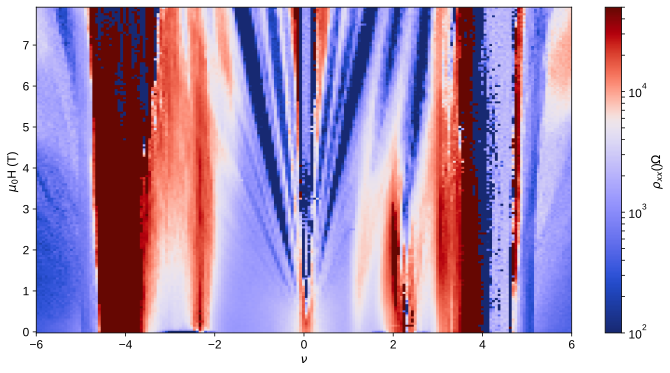

In [33]:
Rxx1213corr = np.copy(Rxx1213)
Rxx1213corr[Rxx1213corr <= 0] = np.min(np.abs(Rxx1213corr))
plt.figure(figsize=(12, 6))
p = plt.pcolormesh(filling1213, fieldsfan1213, Rxx1213corr, norm=npd.DivLogNorm(0.65, vmin=100, vmax=0.5e5), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext(), label=r'$\rho$'+'$_{xx}$ ($\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('$\mu_0$ H (T)')
# plt.xlim((-7, 7))

assuming 0.98$^\circ$

In [34]:
Rxx2022corr = np.copy(Rxx2022)
Rxx2022corr[Rxx2022corr <= 0] = np.min(np.abs(Rxx2022))
Rxx2022func = RectBivariateSpline(filling2022[::-1], fieldsfan2022[::-1], np.flip(Rxx2022corr, axis=(0,1)).T, kx=1, ky=1)
# Rxx2022corrB = gaussian_filter(Rxx2022corr, (1, 0.75))

(0.0, 8.0)

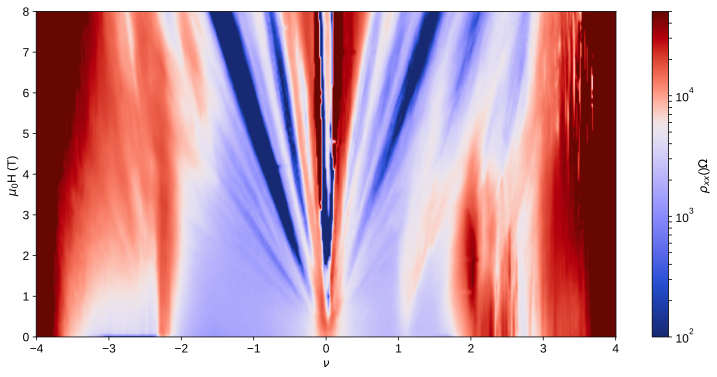

In [35]:
x = np.linspace(-4, 4, 1001)
y = np.linspace(0, 8, 1201)
Rxx = Rxx2022func(x, y)
Rxx = gaussian_filter(Rxx, (0.75, 0.75))

plt.figure(figsize=(13, 6))
plt.pcolormesh(x, y, Rxx.T, norm=npd.DivLogNorm(0.65, vmin=100, vmax=0.5e5), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext(), label=r'$\rho$'+'$_{xx}$ ($\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('$\mu_0$ H (T)')
# plt.xlim((-4, 4))
plt.ylim((0, 8))
# plt.savefig(figfile + 'M12_0p98deg_fan8T_log.svg', bbox_inches='tight', dpi=300)

(0.0, 4.0)

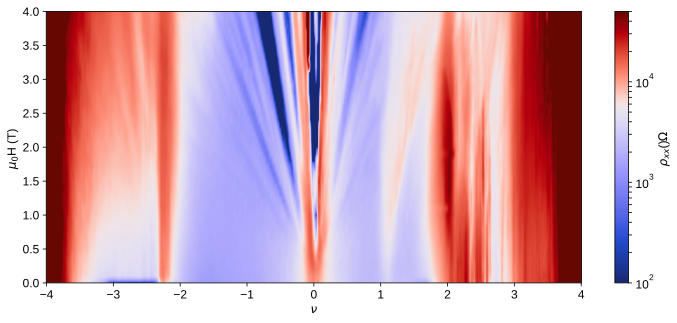

In [36]:
x = np.linspace(-4, 4, 1001)
y = np.linspace(0, 8, 1201)
Rxx = Rxx2022func(x, y)
Rxx = gaussian_filter(Rxx, (0.75, 0.75))

plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, Rxx.T, norm=npd.DivLogNorm(0.65, vmin=100, vmax=0.5e5), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext(), label=r'$\rho$'+'$_{xx}$ ($\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('$\mu_0$ H (T)')
# plt.xlim((-4, 4))
plt.ylim((0, 4))
# plt.savefig(figfile + 'M12_0p98deg_fan4T_log.svg', bbox_inches='tight', dpi=300)

(0.0, 4.0)

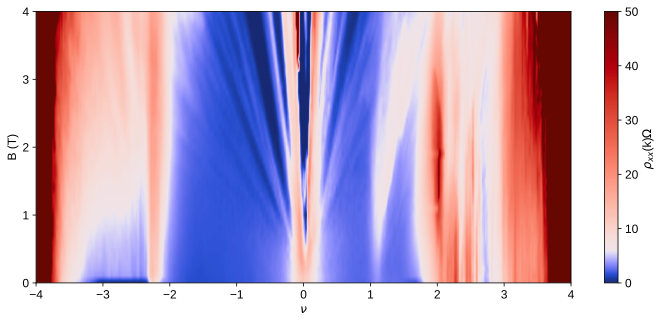

In [38]:
# linear scale
x = np.linspace(-4, 4, 1001)
y = np.linspace(0, 8, 1201)
Rxx = Rxx2022func(x, y)
Rxx = gaussian_filter(Rxx, (0.75, 0.75))
plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, Rxx.T/1000, norm=TwoSlopeNorm(vmin=0, vcenter=6, vmax=5e4/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label=r'$\rho$'+'$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('B (T)')
plt.xlim((-4, 4))
plt.yticks(range(0, 5))
plt.xticks(range(-4, 5))
plt.ylim((0, 4))
# plt.savefig(figfile + 'M12_0p98deg_fan4T_linear.svg', bbox_inches='tight', dpi=300)

assuming 1.04$^\circ$

In [39]:
Rxx2022func_2 = RectBivariateSpline(filling2022_2[::-1], fieldsfan2022[::-1], np.flip(Rxx2022corr, axis=(0,1)).T, kx=1, ky=1)

([<matplotlib.axis.XTick at 0x7ff4d853fdf0>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

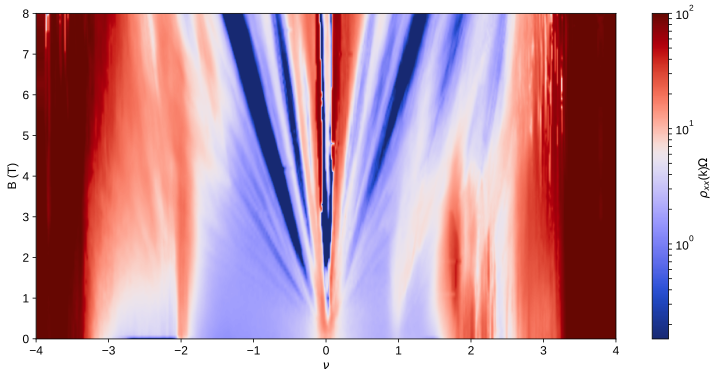

In [40]:
x = np.linspace(-4, 4, 1001)
y = np.linspace(0, 8, 1201)
Rxx = Rxx2022func_2(x, y).T
Rxx = gaussian_filter(Rxx, (0.75, 0.75))
plt.figure(figsize=(13, 6))
plt.pcolormesh(x, y, Rxx/1000, norm=npd.DivLogNorm(0.57, vmin=150/1000, vmax=1e5/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext(), label=r'$\rho$'+'$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('B (T)')
plt.xlim((-4, 4))
plt.xticks(range(-4, 5))
# plt.savefig(figfile + 'M12_1p04deg_fan8T_log.svg', bbox_inches='tight', dpi=300)

(0.0, 4.0)

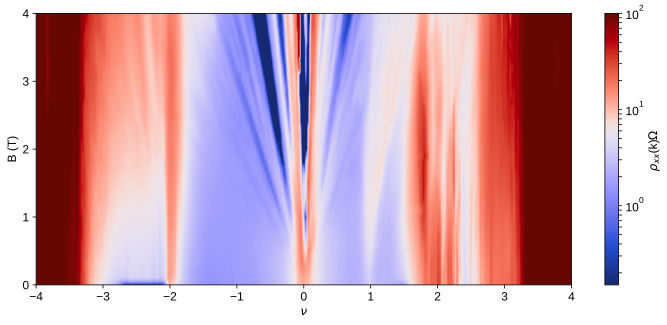

In [41]:
x = np.linspace(-4, 4, 1001)
y = np.linspace(0, 8, 1201)
Rxx = Rxx2022func_2(x, y).T
Rxx = gaussian_filter(Rxx, (0.75, 0.75))
plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, Rxx/1000, norm=npd.DivLogNorm(0.57, vmin=150/1000, vmax=1e5/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext(), label=r'$\rho$'+'$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('B (T)')
plt.xlim((-4, 4))
plt.yticks(range(0, 5))
plt.xticks(range(-4, 5))
plt.ylim((0, 4))
# plt.savefig(figfile + 'M12_1p04deg_fan4T_log.svg', bbox_inches='tight', dpi=300)

(0.0, 4.0)

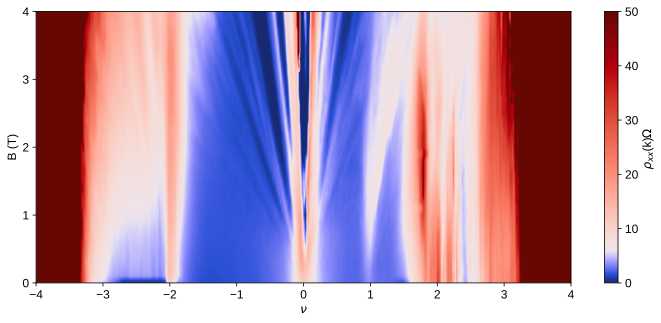

In [42]:
x = np.linspace(-4, 4, 1001)
y = np.linspace(0, 8, 1201)
Rxx = Rxx2022func_2(x, y)
Rxx = gaussian_filter(Rxx, (0.75, 0.75))
plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, Rxx.T/1000, norm=TwoSlopeNorm(vmin=0, vcenter=6, vmax=5e4/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label=r'$\rho$'+'$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('B (T)')
plt.xlim((-4, 4))
plt.yticks(range(0, 5))
plt.xticks(range(-4, 5))
plt.ylim((0, 4))
# plt.savefig(figfile + 'M12_1p04deg_fan4T_linear.svg', bbox_inches='tight', dpi=300)

(0.0, 8.0)

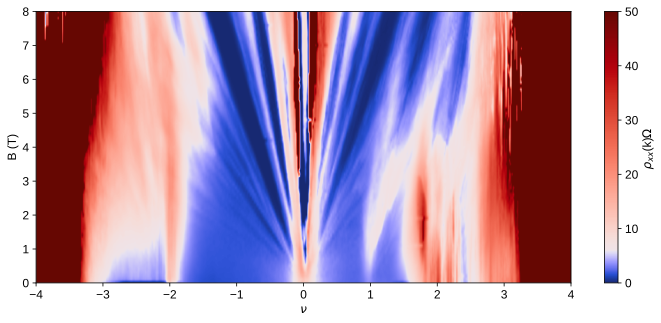

In [43]:
x = np.linspace(-4, 4, 1001)
y = np.linspace(0, 8, 1201)
Rxx = Rxx2022func_2(x, y)
Rxx = gaussian_filter(Rxx, (0.75, 0.75))
plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, Rxx.T/1000, norm=TwoSlopeNorm(vmin=0, vcenter=6, vmax=5e4/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label=r'$\rho$'+'$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('B (T)')
plt.xlim((-4, 4))
# plt.yticks(range(0, 5))
plt.xticks(range(-4, 5))
plt.ylim((0, 8))
# plt.savefig(figfile + 'M12_1p04deg_fan8T_linear.svg', bbox_inches='tight', dpi=300)

## 0.87$^\circ$, device M20, contacts 14-15

In [44]:
# electrodes 14-15 on lockin865, 16-21 on lockin830
datafan1415 = qc.load_data('data/2019-11-29/#003_M20_14_15_865and16_45_830_5.9Tto0T_3nA_13.33Hz_11-42-24')

# Taken later to patch the large filling factor up to 4
dfan1415_2 = qc.load_data('data/2019-12-28/#004_M20_14_15_865and16_21_830_4to0T_3nA_3.9to5Vgate_15-31-20')

In [45]:
Rxx1415 = npd.Rxxfromdata(datafan1415, 3e-9, 'lockin865')
Rxx1415_right = npd.Rxxfromdata(dfan1415_2, 3e-9, 'lockin865')
gfan1415 = datafan1415.srframe_volt_p1_set[0, :]
gfan1415_right = dfan1415_2.srframe_volt_p1_set[:]
fieldsfan1415 = datafan1415.triton_field_set_stable_set[:]
fieldsfan1415_right = dfan1415_2.triton_field_set_stable_set[:]
Rxx1621 = npd.Rxxfromdata(datafan1415, 3e-9, 'lockin830')
gfan1621 = datafan1415.srframe_volt_p1_set[0, :]
fieldsfan1621 = datafan1415.triton_field_set_stable_set[:]

In [46]:
gfan1415[-1]

4.0

In [47]:
gfan1415_right[0, 16]

4.00666666666667

In [48]:
gfan1415_tot = np.concatenate((gfan1415, gfan1415_right[0, 16:]))
Rxx1415_tot = np.hstack((Rxx1415[38:, :], Rxx1415_right[:, 16:]))
Rxx1415_totcorr = np.copy(Rxx1415_tot)
Rxx1415_totcorr[Rxx1415_tot <= 0] = np.min(np.abs(Rxx1415_tot))

In [49]:
Rxx1415_2 = np.copy(Rxx1415)
Rxx1415_2[Rxx1415_2 <= 0] = np.min(np.abs(Rxx1415_2))

In [50]:
sl, b = (17.114662857569453, -4.428590161024674)
V0 = -b/sl
C = sl*1.602e-19**2/6.626e-34
dbn = 8.85e-12*3/C
print('effective capacitance: {:.4e}'.format(C))
print('effective hBN thickness: {:.1f} nm'.format(dbn*10**9))
print('V0: {}'.format(V0))

effective capacitance: 6.6289e-04
effective hBN thickness: 40.1 nm
V0: 0.25876000000000016


There is a slight inconsistency here. If we use the electron half-filling intercept, we get 0.87 deg, and if we use the full filling, we get 0.88. It's not too big of a deal, and the half-filling intercept is easier to extract, so we can use that.

In [51]:
slhalf, bhalf = (17.99913656084725, -42.752452614655176)
V0half = -bhalf/slhalf  # redo this now... # The lines at the full filling didn't match up well unless I subtracted 0.1 from the full-filling gate voltage, so this should give us the proper angle
Vgatefull = (V0half - V0)*2
print('Full filling voltage difference: {}'.format(Vgatefull))
nfull = (Vgatefull)*C/1.602e-19/10**4
print(nfull/10**12) #10**12 cm^-2
a = 0.246e-9

theta = np.sqrt(np.sqrt(3)*nfull*10**4*a**2/8)*180/np.pi
print('theta: ', theta)

Full filling voltage difference: 4.232980388741174
1.7515626870221186
theta:  0.8679723732082049


In [52]:
V0half

2.375250194370587

In [53]:
filling1415 = np.interp(gfan1415, [V0 - Vgatefull, V0 + Vgatefull], [-4, 4])
filling1415_tot = np.interp(gfan1415_tot, [V0 - Vgatefull*6/4, V0 + Vgatefull*6/4], [-6, 6])

In [54]:
[V0 - Vgatefull, V0 + Vgatefull]

[-3.974220388741174, 4.491740388741174]

(-4.0, 4.0)

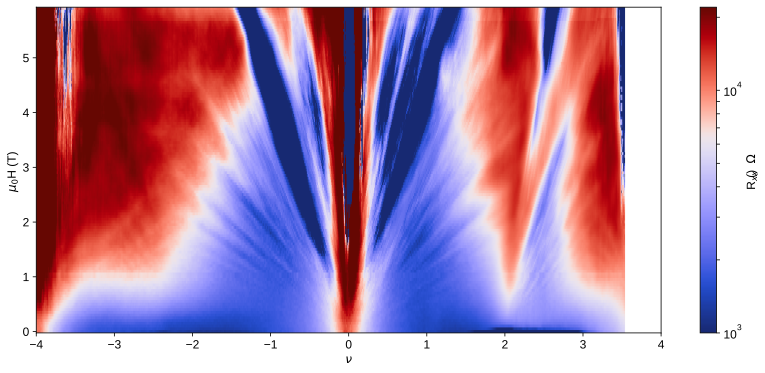

In [55]:
# full 6T graph (don't have the right side to full filling for up to 6T)
cdivlog = npd.DivLogNorm(0.6, 1000, 22000)
plt.figure(figsize=(14, 6))
plt.pcolormesh(filling1415, fieldsfan1415, Rxx1415_2, norm=cdivlog, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext(), label='R$_{xx}$ ($\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('$\mu_0$ H (T)')
plt.xlim((-4, 4))
# plt.savefig(figfile + 'M20_0p87_to6TLandauFan.svg', dpi=300, bbox_inches='tight')

Only to 4T graphs

In [56]:
fields1415to4T = fieldsfan1415[38:]

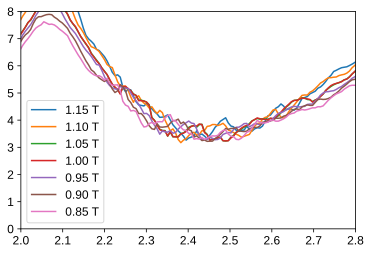

In [57]:
plt.figure()  # you can see here that the 1.05T peak matches with the 1.00T peak
for i in range(7):
    ind = 57 + i
    field = fields1415to4T[ind]
    plt.plot(filling1415_tot, Rxx1415_totcorr[ind, :]/1000, label='{:.2f} T'.format(field))
plt.axis((2, 2.8, 0, 8))
plt.legend()

In [58]:
indices = [i != 59 for i in range(len(fields1415to4T))]  # delete the 1.05T line
Rxx1415func = RectBivariateSpline(filling1415_tot, fields1415to4T[indices][::-1], np.flip(Rxx1415_totcorr[indices, :], axis=0).T)

([<matplotlib.axis.YTick at 0x7ff4c84443a0>,
 [Text(0, 0, '0'),
  Text(0, 1, ''),
  Text(0, 2, ''),
  Text(0, 3, ''),
  Text(0, 4, '4')])

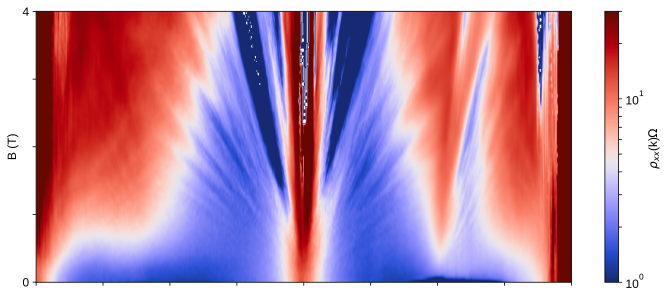

In [59]:
x = np.linspace(-4, 4, 1201)
y = np.linspace(0, 4, 901)
Rxx1415int = gaussian_filter(Rxx1415func(x, y).T, (0.9, 0.9))
cdivlog = npd.DivLogNorm(0.45, 1000/1000, 30000/1000)
plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, Rxx1415int/1000, norm=cdivlog, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext(), label=r'$\rho$' +'$_{xx}$ (k$\Omega$)')
# plt.xlabel(r'$\nu$')
plt.ylabel('B (T)')
plt.xlim((-4, 4))
plt.xticks(range(-4, 5), [])
plt.yticks(range(5), [0, '', '', '', 4])
# plt.savefig(figfile + 'M20_0p87fan_to4T_filling_log.svg', dpi=300, bbox_inches='tight')

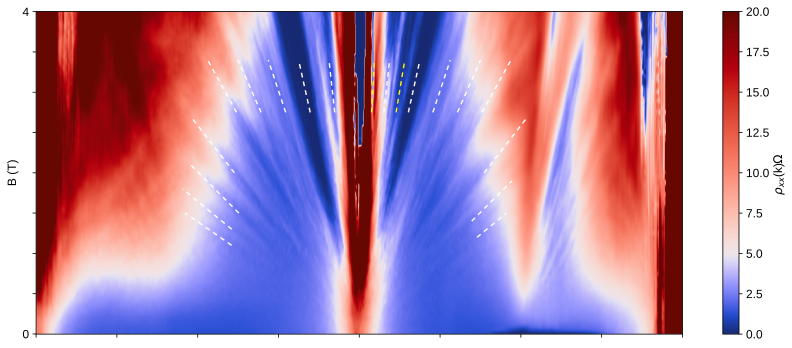

In [60]:
x = np.linspace(-4, 4, 1201)
y = np.linspace(0, 4, 901)
Rxx1415int = gaussian_filter(Rxx1415func(x, y).T, (0.9, 0.9))
cdiv = TwoSlopeNorm(vmin=0, vcenter=5, vmax=20000/1000)
plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, Rxx1415int/1000, norm=cdiv, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label=r'$\rho$' +'$_{xx}$ (k$\Omega$)')
# plt.xlabel(r'$\nu$')
plt.ylabel('B (T)')
plt.xlim((-4, 4))
plt.xticks(range(-4, 5), [])
plt.yticks(np.arange(0, 4.5, 0.5), [0] + ['']*7 + [4])

sl, b = (17.114662857569453, 0)
Vgatefull = 4.232980388741174
slfill = sl*Vgatefull/4

# old lines
# Bl = 3.4
# Bs = 2.75
# for i in [-6, -4, -2, 2, 4, 6]:
#     x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
#     plt.plot(x, (x*slfill + b)/i, color='white')

# new lines
Bl = 3.4
Bs = 2.75
LW = 1.4
dashes = (3.4, 3)
oddcolor = tuple(np.array([255, 243, 15])/255)
for i in [-10, -8, -6, -4, -2, 2, 4, 6, 8, 10]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 3.4
Bs = 2.75
for i in [1, 3]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color=oddcolor, lw=LW, dashes=dashes)
    
Bl = 2.7
Bs = 2
for i in [-14, 14]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 2.1
Bs = 1.5
i = -18
x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 1.9
Bs = 1.4
i = 18
x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 1.8
Bs = 1.3
i = -22
x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

Bl = 1.5
Bs = 1.1
i = -26
x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

Bl = 1.5
Bs = 1.2
i = 22
x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

plt.tight_layout()

# plt.savefig(figfile + 'M20_0p87fan_to4T_filling_linear_mod2.svg', dpi=300, bbox_inches='tight')

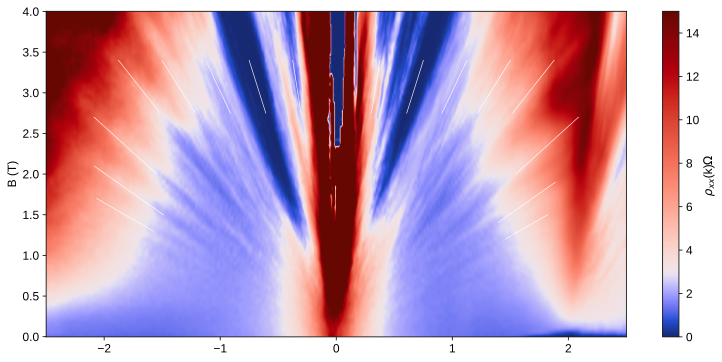

In [62]:
x = np.linspace(-4, 4, 1201)
y = np.linspace(0, 4, 901)
Rxx1415int = gaussian_filter(Rxx1415func(x, y).T, (0.9, 0.9))
cdiv = TwoSlopeNorm(vmin=0, vcenter=3, vmax=15000/1000)
plt.figure(figsize=(13, 6))
plt.pcolormesh(x, y, Rxx1415int/1000, norm=cdiv, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label=r'$\rho$' +'$_{xx}$ (k$\Omega$)')
# plt.xlabel(r'$\nu$')
plt.ylabel('B (T)')
plt.xlim((-2.5, 2.5))
# plt.xticks(range(-4, 5), [])
# plt.yticks(np.arange(0, 4.5, 0.5), [0] + ['']*7 + [4])

sl, b = (17.114662857569453, 0)
Vgatefull = 4.232980388741174
slfill = sl*Vgatefull/4

Bl = 3.4
Bs = 2.75
LW = 0.6
for i in [-10, -8, -6, -4, -2, 2, 4, 6, 8, 10]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
    
Bl = 2.7
Bs = 2
LW = 0.6
for i in [-14, 14]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
    
Bl = 2.1
Bs = 1.5
LW = 0.6
i = -18
x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
    
Bl = 1.9
Bs = 1.4
LW = 0.6
i = 18
x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
    
Bl = 1.7
Bs = 1.3
LW = 0.6
i = -22
x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)

Bl = 1.5
Bs = 1.2
LW = 0.6
i = 22
x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)

# plt.savefig(figfile + 'M20_0p87fan_to4T_filling_linearmap.svg', dpi=300, bbox_inches='tight')

## 0.79$^\circ$, device M20, contacts 16-21

In [63]:
Rxx1621_2 = np.copy(Rxx1621)
Rxx1621_2[Rxx1621_2 <= 0] = np.min(np.abs(Rxx1621_2[Rxx1621 > 0]))

In [64]:
sl, b = (16.992629165630916, -4.454275668221137)
V0 = -b/sl
C = sl*1.602e-19**2/6.626e-34
dbn = 8.85e-12*3/C
print('effective capacitance: {:.4e}'.format(C))
print('effective hBN thickness: {:.1f} nm'.format(dbn*10**9))
print('V0: {}'.format(V0))

effective capacitance: 6.5816e-04
effective hBN thickness: 40.3 nm
V0: 0.26212986965138396


In [65]:
slfull, bfull = (-19.73450247935806, 74.15691506286662)
V0full = -bfull/slfull
Vgatefull = V0full - V0  # This one was a bit uneven, so the negative side full filling didn't line up perfectly (it was slightly closer to the CNP), but this seems close enough
print('Full filling voltage difference: {}'.format(Vgatefull))
nfull = (Vgatefull)*C/1.602e-19/10**4
print(nfull/10**12) #10**12 cm^-2
a = 0.246e-9

theta = np.sqrt(np.sqrt(3)*nfull*10**4*a**2/8)*180/np.pi
print('theta: ', theta)

Full filling voltage difference: 3.495599272009696
1.4361284978831588
theta:  0.7859405741943927


In [66]:
filling1621 = np.interp(gfan1621, [V0 - Vgatefull*6/4, V0 + Vgatefull*6/4], [-6, 6])

(-2.0, 0.0, 0.0, 2000.0)

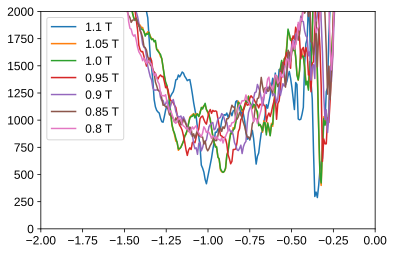

In [67]:
plt.figure()  # you can see here that 1.05 and 1.0 T are the same
for i in range(7):
    ind = 96 + i
    field = fieldsfan1621[ind]
    plt.plot(filling1621, Rxx1621_2[ind, :], label='{} T'.format(field))

plt.legend()
plt.axis((-2, 0, 0, 2000))

In [68]:
indices = [i != 97 for i in range(len(fieldsfan1621))]  # delete 1.05 and interpolate

In [69]:
Rxx1621func = RectBivariateSpline(filling1621, fieldsfan1621[indices][::-1], np.flip(Rxx1621_2[indices, :], axis=0).T, kx=1, ky=1)

Up to 6 T

Text(0, 0.5, 'B (T)')

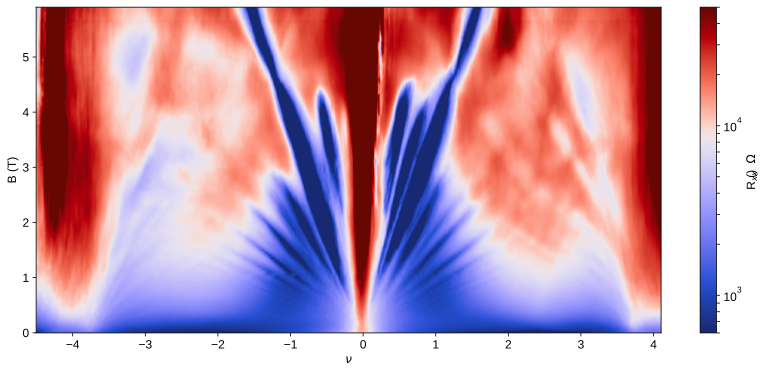

In [70]:
x = np.linspace(-4.5, 4.1, 1200)
y = np.linspace(0, 5.9, 1200)
cdivlog = npd.DivLogNorm(0.6, 600, 50000)
Rxx1621int = gaussian_filter(Rxx1621func(x, y).T, (1.1, 1.1))
plt.figure(figsize=(14, 6))
plt.pcolormesh(x, y, Rxx1621int, norm=cdivlog, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext(), label='R$_{xx}$ ($\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('B (T)')
# plt.xlim((-4, 4))
# plt.savefig(figfile + 'M20_0p79deg_fanto6TRxx.svg', dpi=300, bbox_inches='tight')

In [71]:
1*1.4361284978831588/4

0.3590321244707897

1.20 is not a value in the array
Plotted 1.20 instead
1.2022518765638024
0.95 is not a value in the array
Plotted 0.95 instead
0.92 is not a value in the array
Plotted 0.92 instead
1.05 is not a value in the array
Plotted 1.05 instead


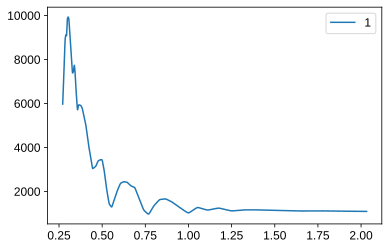

In [72]:
indx = npd.val_to_index([1.2], x)[0]
print(x[indx])
plt.figure()
N = 750
plt.plot(1/y[100:N], Rxx1621int[100:N, indx])
indx = npd.val_to_index([0.95], x)[0]
# plt.plot(1/y[150:N], Rxx1621int[150:N, indx])
indx = npd.val_to_index([0.92], x)[0]
# plt.plot(1/y[150:N], Rxx1621int[150:N, indx])
indx = npd.val_to_index([1.05], x)[0]
# plt.plot(1/y[150:N], Rxx1621int[150:N, indx])

plt.legend([1, 0.95, 0.92, 1.05])

Just to 4 T

([<matplotlib.axis.YTick at 0x7ff4b86ac8e0>,
 [Text(0, 0, '0'),
  Text(0, 1, ''),
  Text(0, 2, ''),
  Text(0, 3, ''),
  Text(0, 4, '4')])

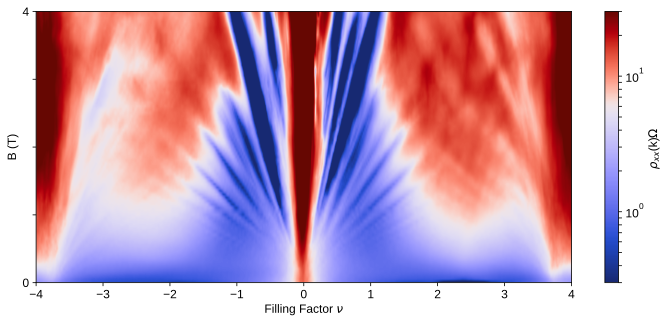

In [75]:
x = np.linspace(-4.5, 4.1, 1200)
y = np.linspace(0, 5.9, 1200)
cdivlog = npd.DivLogNorm(0.65, 300/1000, 30000/1000)
plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, Rxx1621int/1000, norm=cdivlog, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext(), label=r'$\rho$' + '$_{xx}$ (k$\Omega$)')
plt.xlabel(r'Filling Factor $\nu$')
plt.ylabel('B (T)')
plt.xlim((-4, 4))
plt.ylim((0, 4))
plt.yticks(range(5), [0, '', '', '', 4])
# plt.savefig(figfile + 'M20_0p79fan_to4T_filling_log.svg', dpi=300, bbox_inches='tight')

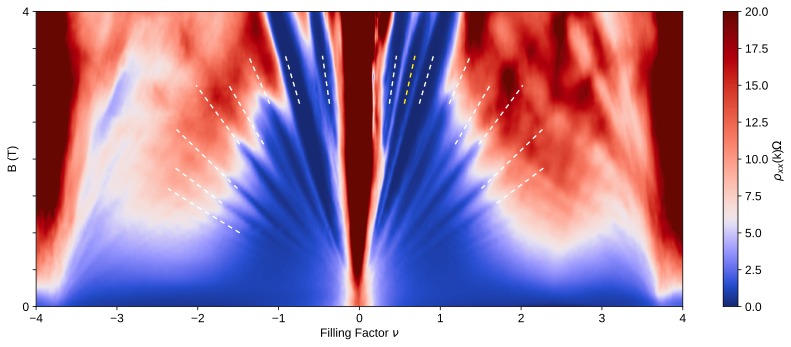

In [76]:
x = np.linspace(-4.5, 4.1, 1200)
y = np.linspace(0, 5.9, 1200)
cdivlog = TwoSlopeNorm(vmin=0, vcenter=6, vmax=20000/1000)
plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, Rxx1621int/1000, norm=cdivlog, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label=r'$\rho$' + '$_{xx}$ (k$\Omega$)')
plt.xlabel(r'Filling Factor $\nu$')
plt.ylabel('B (T)')
plt.xlim((-4, 4))
plt.ylim((0, 4))
plt.yticks(np.arange(0, 4.5, 0.5), [0] + ['']*7 + [4])
plt.tight_layout()

sl, b = (16.992629165630916, 0)
Vgatefull = 3.495599272009696
slfill = sl*Vgatefull/4

## old lines
# Bl = 3.4
# Bs = 2.75
# for i in [-6, -4, -2, 2, 4, 6]:
#     x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
#     plt.plot(x, (x*slfill + b)/i, color='white')

# new lines
Bl = 3.4
Bs = 2.75
LW = 1.4
dashes = (3.4, 3)
oddcolor = tuple(np.array([255, 243, 15])/255)
for i in [-6, -4, -2, 2, 4, 6]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 3.4
Bs = 2.75
for i in [3]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color=oddcolor, lw=LW, dashes=dashes)
    
Bl = 3
Bs = 2.2
for i in [-10, -8, 8, 10]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 2.4
Bs = 1.6
for i in [-14, 14]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 1.9
Bs = 1.4
for i in [-18, 18]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 1.6
Bs = 1
for i in [-22]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

plt.tight_layout()

# plt.savefig(figfile + 'M20_0p79fan_to4T_filling_linear_mod2.svg', dpi=300, bbox_inches='tight')

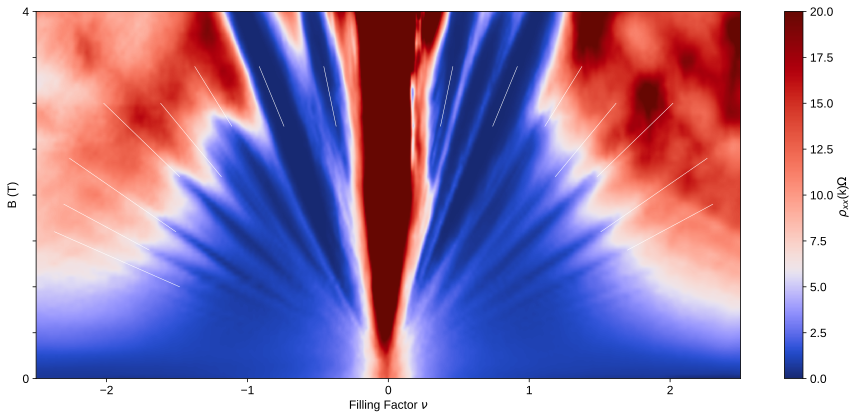

In [77]:
x = np.linspace(-4.5, 4.1, 1200)
y = np.linspace(0, 5.9, 1200)
cdivlog = TwoSlopeNorm(vmin=0, vcenter=6, vmax=20000/1000)
plt.figure(figsize=(13, 6))
plt.pcolormesh(x, y, Rxx1621int/1000, norm=cdivlog, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label=r'$\rho$' + '$_{xx}$ (k$\Omega$)')
plt.xlabel(r'Filling Factor $\nu$')
plt.ylabel('B (T)')
plt.xlim((-2.5, 2.5))
plt.ylim((0, 4))
plt.yticks(np.arange(0, 4.5, 0.5), [0] + ['']*7 + [4])
plt.tight_layout()

sl, b = (16.992629165630916, 0)
Vgatefull = 3.495599272009696
slfill = sl*Vgatefull/4

Bl = 3.4
Bs = 2.75
LW = 0.5
for i in [-6, -4, -2, 2, 4, 6]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
    
Bl = 3
Bs = 2.2
for i in [-10, -8, 8, 10]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
    
Bl = 2.4
Bs = 1.6
for i in [-14, 14]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
    
Bl = 1.9
Bs = 1.4
for i in [-18, 18]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
    
Bl = 1.6
Bs = 1
for i in [-22]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)

# plt.savefig(figfile + 'M20_0p79fan_to4T_filling_linearmap.svg', dpi=300, bbox_inches='tight')

## 0.83 degree part of M20

In [78]:
dp83 = qc.load_data('data/2019-12-05/#007_M20_865_21-45_830_16-45_Rxy_twodfan_0p5nA_22-32-09')
gp83 = dp83.srframe_volt_p1_set[0, :]
bp83 = dp83.triton_field_set_stable_set[40:]  # only from 5T down
Rp83 = npd.Rxxfromdata(dp83, 0.5e-9, 'lockin865')[40:, :]

# some data to 7T (actually -7T, so it may not line up well. We'll see)
dp83_2 = qc.load_data('data/2019-12-08/#002_M20_865_16-15_830_16-45_Rxy_twodfan_0p5nA_ton7T_16-49-13')
gp83_2 = dp83_2.srframe_volt_p1_set[0, :]
bp83_2 = dp83_2.triton_field_set_stable_set[50:]*-1  #from 5-7T
Rp83_2 = npd.Rxxfromdata(dp83_2, 0.5e-9, 'lockin865')[50:, :]

bp83_full = np.concatenate((bp83[::-1], bp83_2))
Rp83_full = np.vstack((np.flip(Rp83, axis=0), Rp83_2))

(-4.0, 4.0)

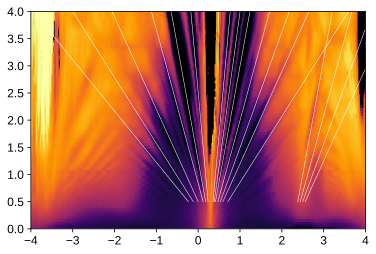

In [79]:
plt.figure()
plt.pcolormesh(gp83, bp83, Rp83, cmap='inferno', norm=SymLogNorm(2000, vmin=0, vmax=1e5), rasterized=True)
plt.ylim(0, 4)

sl0 = 16.992629165630916  #from the 0.79 degree data CNP
V0 = 0.296
Bl = 7
Bs = 0.5
b = -V0*sl0
for i in [-18, -14, -10, -6, -4, -2, 2, 3, 4, 6, 8, 10, 14]:
    x = np.array([(Bs*i - b)/sl0, (Bl*i - b)/sl0])
    plt.plot(x, (x*sl0 + b)/i, color='white', lw=0.5)

# V0f = -3.58
# bf = -V0f*sl0
# for i in [4, 6, 8, 10, 14, 18, 22]:
#     x = np.array([(Bs*i - bf)/sl0, (Bl*i - bf)/sl0])
#     plt.plot(x, (x*sl0 + bf)/i, color='white', lw=0.5)
    
V0h = 2.265
bf = -V0h*sl0
for i in [4, 6, 8, 10]:
    x = np.array([(Bs*i - bf)/sl0, (Bl*i - bf)/sl0])
    plt.plot(x, (x*sl0 + bf)/i, color='white', lw=0.5)
    
plt.xlim(-4, 4)

From this CNP and half filling data, we get

In [80]:
sl0 = 16.992629165630916  #from the 0.79 degree data CNP
V0 = 0.296
Vgatefull = (V0h - V0)*2
C = sl0*1.602e-19**2/6.626e-34
dbn = 8.85e-12*3/C
print('effective capacitance: {:.4e}'.format(C))
print('effective hBN thickness: {:.1f} nm'.format(dbn*10**9))
print('V0: {}'.format(V0))
print('Full filling voltage difference: {}'.format(Vgatefull))
nfull = (Vgatefull)*C/1.602e-19/10**4
print(nfull/10**12) #10**12 cm^-2
a = 0.246e-9

theta = np.sqrt(np.sqrt(3)*nfull*10**4*a**2/8)*180/np.pi
print('theta: ', theta)

effective capacitance: 6.5816e-04
effective hBN thickness: 40.3 nm
V0: 0.296
Full filling voltage difference: 3.938
1.61788396912339
theta:  0.8341933925864526


In [81]:
nugatep83 = np.interp(gp83, [V0 - Vgatefull*6/4, V0 + Vgatefull*6/4], [-6, 6])

In [82]:
Rp83corr = np.copy(Rp83)
Rp83corr[Rp83 <= 0] = np.min(np.abs(Rp83[Rp83 > 0]))

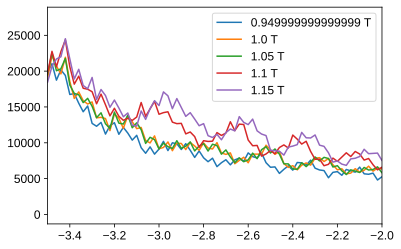

In [83]:
plt.figure()
for i in range(5):
    indx = 81 - i
    b = bp83[indx]
    plt.plot(gp83, Rp83[indx, :], label=f'{b} T')
plt.xlim(-3.5, -2)
plt.legend()

In [84]:
bp83[79]

1.05

In [85]:
indices = [i != 79 for i in range(len(bp83))]  # delete 1.05 and interpolate
Rp83func = RectBivariateSpline(nugatep83, bp83[indices][::-1], np.flip(Rp83[indices, :], axis=0).T, kx=1, ky=1)

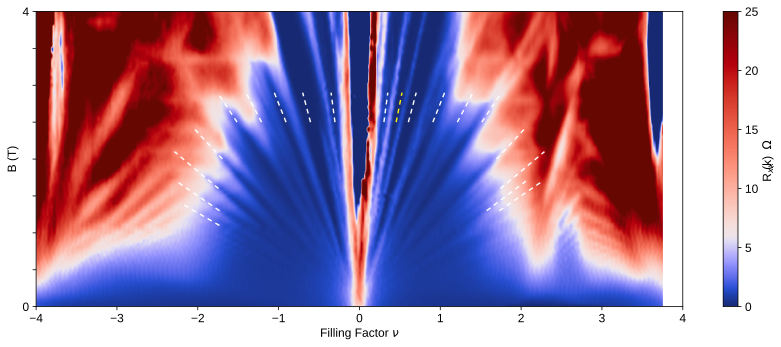

In [86]:
x = np.linspace(-4.4, 3.75, 1000)
y = np.linspace(0, 5, 800)
cdivlog = TwoSlopeNorm(vmin=0, vcenter=6, vmax=25000/1000)
plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, gaussian_filter(Rp83func(x, y).T, (1, 1))/1000, norm=cdivlog, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel('Filling Factor $\\nu$')
plt.ylabel('B (T)')
plt.xlim((-4, 4))
plt.ylim((0, 4))
plt.yticks(np.arange(0, 4.5, 0.5), [0] + ['']*7 + [4])

sl, b = (16.992629165630916, 0)
Vgatefull = 3.8880000000000003
slfill = sl*Vgatefull/4

## old lines
# Bl = 3.4
# Bs = 2.75
# for i in [-6, -4, -2, 2, 4, 6]:
#     x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
#     plt.plot(x, (x*slfill + b)/i, color='white')

Bl = 2.9
Bs = 2.5
LW = 1.4
dashes = (3.4, 3)
oddcolor = tuple(np.array([255, 243, 15])/255)
for i in [-10, -8, -6, -4, -2, 2, 4, 6, 8, 10]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 2.9
Bs = 2.5
for i in [3]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color=oddcolor, lw=LW, dashes=dashes)
    
Bl = 2.4
Bs = 2
for i in [-14, 14]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 2.1
Bs = 1.6
for i in [-18, 18]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 1.7
Bs = 1.3
for i in [-22, 20, 22]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 1.4
Bs = 1.1
for i in [-26]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

plt.tight_layout()


# plt.savefig(figfile + 'M20_0p83_landaufanto4T_mod2.svg', dpi=300, bbox_inches='tight')

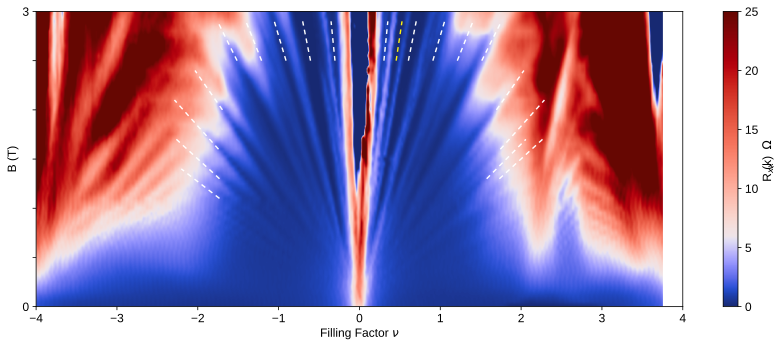

In [87]:
x = np.linspace(-4.4, 3.75, 1000)
y = np.linspace(0, 5, 800)
cdivlog = TwoSlopeNorm(vmin=0, vcenter=6, vmax=25000/1000)
plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, gaussian_filter(Rp83func(x, y).T, (1, 1))/1000, norm=cdivlog, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel('Filling Factor $\\nu$')
plt.ylabel('B (T)')
plt.xlim((-4, 4))
plt.ylim((0, 3))
plt.yticks(np.arange(0, 3.5, 0.5), [0] + ['']*5 + [3])

sl, b = (16.992629165630916, 0)
Vgatefull = 3.8880000000000003
slfill = sl*Vgatefull/4

# # old lines
# Bl = 3
# Bs = 2.5
# for i in [-6, -4, -2, 2, 4, 6]:
#     x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
#     plt.plot(x, (x*slfill + b)/i, color='white')

Bl = 2.9
Bs = 2.5
LW = 1.4
dashes = (3.4, 3)
oddcolor = tuple(np.array([255, 243, 15])/255)
for i in [-10, -8, -6, -4, -2, 2, 4, 6, 8, 10]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 2.9
Bs = 2.5
for i in [3]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color=oddcolor, lw=LW, dashes=dashes)
    
Bl = 2.4
Bs = 2
for i in [-14, 14]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 2.1
Bs = 1.6
for i in [-18, 18]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 1.7
Bs = 1.3
for i in [-22, 20, 22]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 1.4
Bs = 1.1
for i in [-26]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW, dashes=dashes)

plt.tight_layout()


# plt.savefig(figfile + 'M20_0p83_landaufanto3T_mod2.svg', dpi=300, bbox_inches='tight')

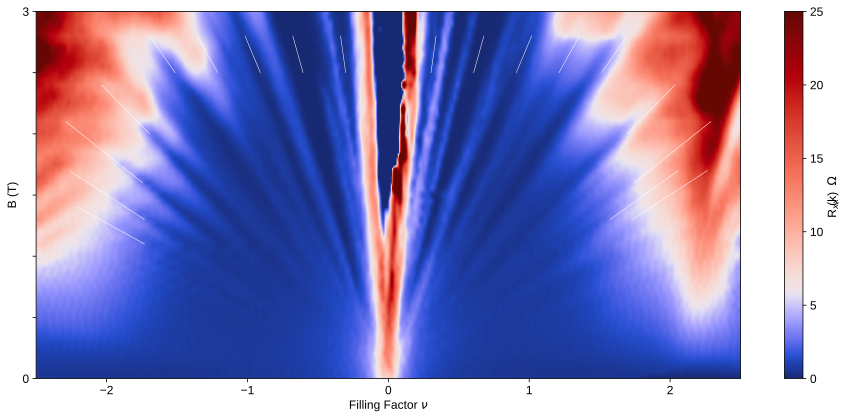

In [88]:
x = np.linspace(-4.4, 3.75, 1000)
y = np.linspace(0, 5, 800)
cdivlog = TwoSlopeNorm(vmin=0, vcenter=6, vmax=25000/1000)
plt.figure(figsize=(13, 6))
plt.pcolormesh(x, y, gaussian_filter(Rp83func(x, y).T, (1, 1))/1000, norm=cdivlog, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel('Filling Factor $\\nu$')
plt.ylabel('B (T)')
plt.xlim((-2.5, 2.5))
plt.ylim((0, 3))
plt.yticks(np.arange(0, 3.5, 0.5), [0] + ['']*5 + [3])

sl, b = (16.992629165630916, 0)
Vgatefull = 3.8880000000000003
slfill = sl*Vgatefull/4

Bl = 2.8
Bs = 2.5
LW = 0.5
for i in [-10, -8, -6, -4, -2, 2, 4, 6, 8, 10]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
    
Bl = 2.4
Bs = 2
LW = 0.5
for i in [-14, 14]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
    
Bl = 2.1
Bs = 1.6
LW = 0.5
for i in [-18, 18]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
    
Bl = 1.7
Bs = 1.3
LW = 0.5
for i in [-22, 20, 22]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)
    
Bl = 1.4
Bs = 1.1
LW = 0.5
for i in [-26]:
    x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
    plt.plot(x, (x*slfill + b)/i, color='white', lw=LW)

plt.tight_layout()

# plt.savefig(figfile + 'M20_0p83_landaufanto3Tmap.svg', dpi=300, bbox_inches='tight')

(0.0, 5.0)

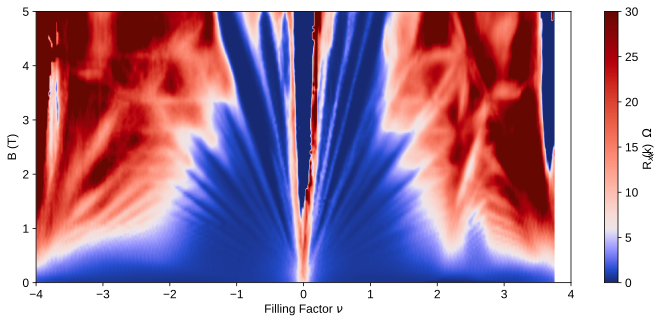

In [89]:
x = np.linspace(-4.4, 3.75, 1000)
y = np.linspace(0, 5, 800)
cdivlog = TwoSlopeNorm(vmin=0, vcenter=6, vmax=30000/1000)
plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, gaussian_filter(Rp83func(x, y).T, (1, 1))/1000, norm=cdivlog, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel('Filling Factor $\\nu$')
plt.ylabel('B (T)')
plt.xlim((-4, 4))
plt.ylim((0, 5))
# plt.savefig(figfile + 'M20_0p83_landaufanto5T.svg', dpi=300, bbox_inches='tight')

In [90]:
len(bp83_full)

121

In [91]:
Rp83_full.shape

(121, 401)

(0.0, 7.0)

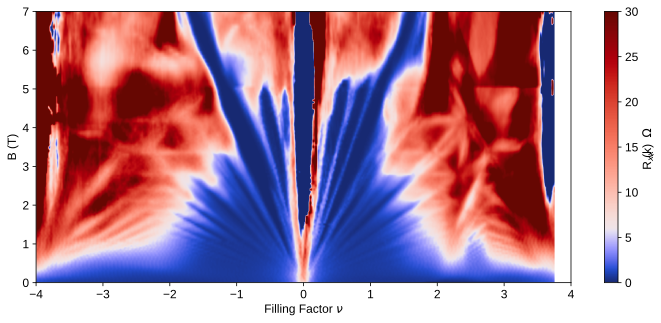

In [92]:
indices_full = [i != 21 for i in range(len(bp83_full))]  # delete 1.05 and interpolate
Rp83_fullfunc = RectBivariateSpline(nugatep83, bp83_full[indices_full], Rp83_full[indices_full, :].T, kx=1, ky=1)

x = np.linspace(-4.1, 3.75, 1000)
y = np.linspace(0, 7, 1000)
cdivlog = TwoSlopeNorm(vmin=0, vcenter=6, vmax=30000/1000)
plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, gaussian_filter(Rp83_fullfunc(x, y).T, (1, 1))/1000, norm=cdivlog, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel('Filling Factor $\\nu$')
plt.ylabel('B (T)')
plt.xlim((-4, 4))
plt.ylim((0, 7))
# plt.savefig(figfile + 'M20_0p83_landaufanto7T.svg', dpi=300, bbox_inches='tight')

# Quantization of Rxy

## 0.79 degree area (contacts 16-45).

This was done with a little extra averaging: 0.3s TC, wait time after gate: 2.4s, 0.35s wait time between 5 measurements that are then averaged.

In [93]:
drxypos1 = qc.load_data('data/2020-01-08/#013_M20_16-45_Rxy_2nA_0p3sTC_avg5_14-57-59')  #1.5 to 3 T
drxyneg1 = qc.load_data('data/2020-01-08/#014_M20_16-45_Rxy_2nA_0p3sTC_avg5_negfield_19-36-32')  #-1.5 to -3 T

# over a smaller range to capture just a few plateaus.
drxypos2 = qc.load_data('data/2020-01-09/#002_M20_16-45_Rxy_2nA_0p3sTC_avg5_posfield_07-05-11')  #1.25 to 0.5 T
drxyneg2 = qc.load_data('data/2020-01-09/#001_M20_16-45_Rxy_2nA_0p3sTC_avg5_negfield_00-41-51') #-1.25 to -0.5 T

In [94]:
drxypos1

DataSet:
   location = 'data/2020-01-08/#013_M20_16-45_Rxy_2nA_0p3sTC_avg5_14-57-59'
   <Type>   | <array_id>                  | <array.name>     | <array.shape>
   Setpoint | triton_field_set_stable_set | field_set_stable | (4,)
   Setpoint | srframe_volt_p1_set         | volt_p1          | (4, 541)
   Measured | lockin830_Xav               | lockin830_Xav    | (4, 541)
   Measured | lockin830_Y                 | Y                | (4, 541)
   Measured | lockin865_Xav               | lockin865_Xav    | (4, 541)
   Measured | lockin865_Y                 | Y                | (4, 541)

In [95]:
rxygate1 = drxypos1.srframe_volt_p1_set[0, :]
Rxypos = (drxypos1.lockin830_Xav[:] + drxypos1.lockin865_Xav[:])/2/2e-9
Rxyneg = (drxyneg1.lockin830_Xav[:] + drxyneg1.lockin865_Xav[:])/2/2e-9
Rxysymm = (Rxypos - Rxyneg)/2

In [96]:
rxygate2 = drxypos2.srframe_volt_p1_set[0, :]
Rxypos2 = (drxypos2.lockin830_Xav[:] + drxypos2.lockin865_Xav[:])/2/2e-9
Rxyneg2 = (drxyneg2.lockin830_Xav[:] + drxyneg2.lockin865_Xav[:])/2/2e-9
Rxysymm2 = (Rxypos2 - Rxyneg2)/2

In [97]:
V0 = 0.26212986965138396
Vgatefull = 3.495599272009696
fillingrxy1 = np.interp(rxygate1, [V0 - Vgatefull, V0 + Vgatefull], [-4, 4])
fillingrxy2 = np.interp(rxygate2, [V0 - Vgatefull, V0 + Vgatefull], [-4, 4])

In [98]:
esqh = 1.602e-19**2/6.626e-34

In [99]:
drxypos2.triton_field_set_stable_set

DataArray[4]: triton_field_set_stable_set
array([1.25, 1.  , 0.75, 0.5 ])

In [100]:
drxyneg2.triton_field_set_stable_set

DataArray[4]: triton_field_set_stable_set
array([-1.25, -1.  , -0.75, -0.5 ])

[Text(-1.0, 0, '-1'),
 Text(-0.5, 0, ''),
 Text(0.0, 0, '0'),
 Text(0.5, 0, ''),
 Text(1.0, 0, '1')]

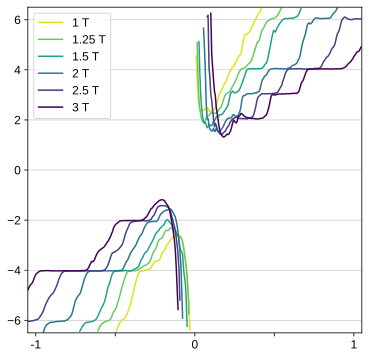

In [101]:
N = 6  #number of curves
cyclemap = np.flip(plt.get_cmap('viridis')([i/(N-0.75) for i in range(N)]), axis=0)
# cyclemap = cc.cm.linear_protanopic_deuteranopic_kbw_5_98_c40([i/(N) for i in range(N)])

fig, ax = plt.subplots(figsize=(6, 6), facecolor='white', dpi=300)
# nav = 3
xmin = -1.05
xmax = 1.05
ymin = -6.5
ymax = 6.5



ax.plot(np.ma.masked_outside(fillingrxy2, xmin, xmax), np.ma.masked_outside(1/gaussian_filter(Rxysymm2[1, :] + 0.1, 0.8)/esqh, ymin, ymax), color=cyclemap[0])
ax.plot(np.ma.masked_outside(fillingrxy2, xmin, xmax), np.ma.masked_outside(1/gaussian_filter(Rxysymm2[0, :] + 0.1, 0.8)/esqh, ymin, ymax), color=cyclemap[1])

for i in range(Rxysymm.shape[0]):
    ax.plot(np.ma.masked_outside(fillingrxy1, xmin, xmax), np.ma.masked_outside(1/gaussian_filter(Rxysymm[i, :] + 0.1, 0.6)/esqh, ymin, ymax), color=cyclemap[i + 2])
#     plt.plot(rxygate1, 1/Rxypos[i, :]/esqh)

ax.hlines(np.arange(-6, 8, 2), xmin=-1.05, xmax=1.05, lw=0.5, color='gray', alpha=0.6)

ax.legend(['1 T', '1.25 T', '1.5 T', '2 T', '2.5 T', '3 T'])
ax.set_ylim((ymin, ymax))
ax.set_xlim((xmin, xmax))
ax.set_xticks(np.arange(-1, 1.5, 0.5))
ax.set_xticklabels([-1, '', 0, '', 1])
# plt.ylabel('$R_{xy}^{-1}$ ($e^2/h$)')
# plt.xlabel('Filling factor $\\nu$')
# plt.savefig(figfile + 'M20_0p79_Rxy1tp3T_vector.svg', bbox_inches='tight', dpi=300)

### Check the Hall density with the lower-field data at +/- 0.5T

(-1.7, 1.0)

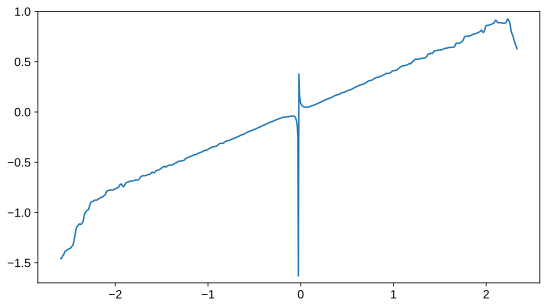

In [102]:
plt.figure(figsize=(9, 5))
plt.plot(fillingrxy2, 500e-3/(1.602e-19*gaussian_filter(Rxysymm2[-1, :], 1))/10**16)  # in 10^12 cm^-2
# plt.plot(fillingrxy2, 750e-3/(1.602e-19*gaussian_filter(Rxysymm2[-2, :], 1))/10**16)
# plt.plot(fillingrxy2, 1/(1.602e-19*gaussian_filter(Rxysymm2[-3, :], 1))/10**16)
# plt.plot(fillingrxy2, 1.25/(1.602e-19*gaussian_filter(Rxysymm2[-4, :], 1))/10**16)  #checked the fields up to 1.25, and they agree well
plt.ylim(-1.7, 1)

## 0.97 degree device, mostly copied from Stevan's plot

In [103]:
datafan = qc.load_data('data/2019-10-06/#003_0to8TtwodSweep_0.5nAexcM08_Rxx38-37_Rxy38-44_basetemp_161fieldpts_16-35-30')

Rxxfan = datafan.lockin865_X[:, :]/0.5e-9
Rxyfan3844 = datafan.lockin830_X[:, :]/0.5e-9
gfan3844 = datafan.srframe_volt_p1_set[0, :]
fieldsfan3844 = datafan.triton_field_set_stable_set[:]
esqh = 1.602e-19**2/6.626e-34

In [104]:
v0m8= 0.34537750837960857
Vgatefull = 8.081768748385855

filling3844 = np.interp(gfan3844, [v0m8 - Vgatefull*6/4, v0m8 + Vgatefull*6/4], [-6, 6])

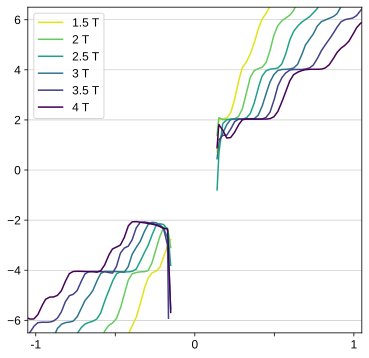

In [105]:
N = 6  #number of curves
cyclemap = np.flip(plt.get_cmap('viridis')([i/(N-0.75) for i in range(N)]), axis=0)

fig, ax = plt.subplots(figsize=(6, 6), facecolor='white', dpi=300)
Conductance3844=1/(Rxyfan3844+0.01)/esqh

Conductance3844m=gaussian_filter(Conductance3844, sigma=0.6)

Bindx=[30, 40, 50, 60, 70, 80]
xmin = -1.05
xmax = 1.05
ymin = -6.5
ymax = 6.5

xcenterleft = -0.15
xcenterright = 0.14


for i, indx in enumerate(Bindx):
    conductanceinterp = interp1d(filling3844, -Conductance3844m[indx, :])
    fill = np.linspace(xmin, xmax, 901)
    Bb= fieldsfan3844[indx]
    label1 = f'B={Bb} T'
    ax.plot(np.ma.masked_inside(np.ma.masked_outside(fill, xmin, xmax), xcenterleft, xcenterright), np.ma.masked_outside(conductanceinterp(fill), ymin, ymax), color=cyclemap[i])

ax.set_ylim([-6.5,6.5])
ax.set_xlim([-1.05,1.05])
# ax.grid("True")
ax.hlines(np.arange(-6, 8, 2), xmin=-1.05, xmax=1.05, lw=0.5, color='gray', alpha=0.6)
# ax.set_title("RxyM08-38-44")
ax.set_xticks(np.arange(-1, 1.5, 0.5))
ax.set_xticklabels([-1, '', 0, '', 1])
ax.legend(['1.5 T', '2 T', '2.5 T', '3 T', '3.5 T', '4 T'])
# ax.set_ylabel('$R_{xy}^{-1}$ ($e^2/h$)')
# plt.savefig(figfile + 'M08_0p97_Rxy1p5tp4T_vector.svg', bbox_inches='tight', dpi=300)

# T dependence

In [106]:
def SCdomepts(x, R, T, Tidx, xidxstart, xidxstop):
    print('Normalizing temperature', T[Tidx])
    xx = []
    yy = []
    for i in np.arange(xidxstart, xidxstop):
        norm_T = R[:,i]/R[Tidx,i]
        ss = -1
        for j in np.arange(norm_T.shape[0]):
            if norm_T[j]>0.5:
                ss=1
                break
        if ss>0:
            xx.append(x[i])
            yy.append(T[j])

    f = interp1d( xx[::2], yy[::2], kind = 'linear')
    xnew = np.linspace(xx[0],xx[-2], 100)
    return xnew, f(xnew)

## M08 to 10K

In [107]:
baseTdata = qc.load_data('data/2019-10-10/#003_M08_38-37_basetemp_-.08mT_0.2nA_09-02-47')
Tdata = qc.load_data('data/2019-10-10/#006_M08_-.8mT_0.2nA_T-bgtwod_11-08-50')

In [108]:
T = np.concatenate(([0.025], Tdata.triton_pid_setpoint_set[:20]))
Tgates = Tdata.srframe_volt_p1_set[0, :]
R3837_2 = np.vstack((npd.Rxxfromdata(baseTdata, 0.2e-9, 'lockin865'), npd.Rxxfromdata(Tdata, 0.2e-9, 'lockin865')[:20, :]))

In [109]:
# 1-2K data
T12_0 = qc.load_data('data/2019-10-16/#005_M08_-.8mT_0.2nA_T-bgtwod_1p1to1p3K_16-39-57') #1.1-1.3
T12_1 = qc.load_data('data/2019-10-16/#003_M08_-.8mT_0.2nA_T-bgtwod_1p4to1p9K_14-36-33') #1.4-1.5
T12_2 = qc.load_data('data/2019-10-16/#004_M08_-.8mT_0.2nA_T-bgtwod_1p6to1p9K_15-21-10') #1.6-1.9

midT = np.arange(1.1, 2.0, 0.1)
# maybe don't include the last few points since they were taken when the temperature was likely higher
R3837_m_2 = np.vstack((npd.Rxxfromdata(T12_0, 0.2e-9, 'lockin865'), npd.Rxxfromdata(T12_1, 0.2e-9, 'lockin865')[:2, :], npd.Rxxfromdata(T12_2, 0.2e-9, 'lockin865')[:, :]))    #[:2, :], npd.Rxxfromdata(T12_2, 0.2e-9, 'lockin865')[:-3, :]))

In [110]:
dHT2 = qc.load_data('data/2019-10-11/#001_M08_-.8mT_0.2nA_T-bgtwod_7p2to10K_08-58-32')
dHT1 = qc.load_data('data/2019-10-10/#007_M08_-.8mT_0.2nA_T-bgtwod_3to10K_17-35-51')  #actually 2-10K

In [111]:
R3837_h1_2 = npd.Rxxfromdata(dHT1, 0.2e-9, 'lockin865')[:51, :]
hT1 = dHT1.triton_pid_setpoint_set[:51]
Tgates3837 = dHT1.srframe_volt_p1_set[0, :]

R3837_h2_2 = npd.Rxxfromdata(dHT2, 0.2e-9, 'lockin865')
hT2 = dHT2.triton_pid_setpoint_set[:]

hT = np.concatenate((hT1, hT2[1:]))
R3837_H_2 = np.vstack((R3837_h1_2, R3837_h2_2[1:, :]))

In [112]:
# combine all together
Tall3837 = np.concatenate((T, midT, hT))
R3837_all_2 = np.vstack((R3837_2, R3837_m_2, R3837_H_2))

In [113]:
Vgatefull = 8.081768748385855
nfull = 2.167907319080984
V0tempind = np.argmax(R3837_all_2[0, 200:240])
V0temp = Tgates3837[200 + V0tempind-2]
filling3837_T = np.interp(Tgates3837, [V0temp - Vgatefull*6/4, V0temp + Vgatefull*6/4], [-6, 6])

In [114]:
R3837func = RectBivariateSpline(filling3837_T, Tall3837, R3837_all_2.T, kx=1, ky=1)

(0.0, 20.0)

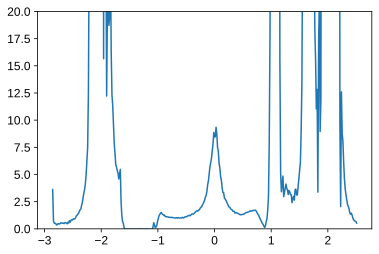

In [115]:
# base temp sweep
nT3837 = np.interp(Tgates3837, [V0temp - Vgatefull*6/4, V0temp + Vgatefull*6/4], [-6/4*nfull, 6/4*nfull])
plt.figure()
plt.plot(nT3837, R3837_all_2[0, :]/1000)
plt.ylim(0, 20)
# plt.xlim(-0.3, 0.3)

# np.savetxt(BaseTfile + 'M08_0p97_RxxvsN.txt', np.vstack((nT3837, R3837_all_2[0, :])), fmt='%.8e', header='electron density (in 10^12 cm^-2) vs Rxx at base temp')

Calculate the SC domes

(-4.0, 4.0)

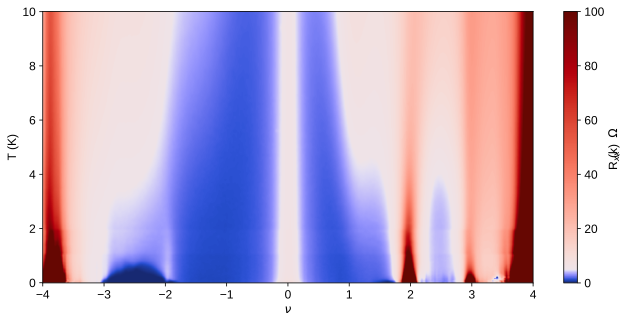

In [116]:
x = np.linspace(-5, 5, 1001)
y = np.linspace(0, 10, 801)
R3837int = gaussian_filter(R3837func(x, y).T, (0.8, 0.8))

plt.figure(figsize=(11,5))
coff = TwoSlopeNorm(vcenter=5, vmin=0, vmax=100)
plt.pcolormesh(x, y, R3837int/1000, norm=coff, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)#cc.cm.diverging_bwg_20_95_c41)
plt.ylabel('T (K)')
plt.xlabel(r'$\nu$')
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlim((-4, 4))

# plt.savefig(figfile+'M08_to10K_Temp_linear.svg', bbox_inches='tight', dpi=300)

In [117]:
x = np.linspace(-5, 5, 1001)
y = np.linspace(0, 10, 801)
R3837int = gaussian_filter(R3837func(x, y).T, (0.8, 0.8))

(-4.0, 4.0)

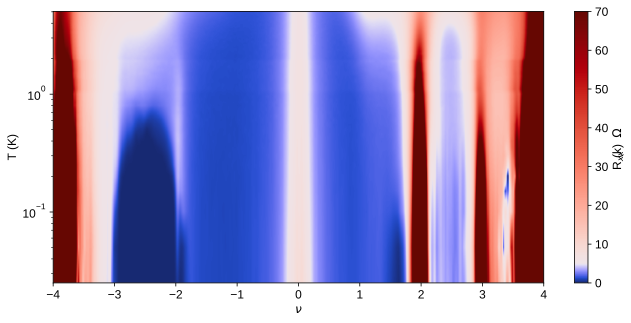

In [119]:
# try a log-T plot
x = np.linspace(-5, 5, 1001)
ylog = np.logspace(-1.6, 0.7, 600)
R3837intlog = gaussian_filter(R3837func(x, ylog).T, (0.8, 0.8))

plt.figure(figsize=(11,5))
coff = TwoSlopeNorm(vcenter=5, vmin=0, vmax=70)
plt.pcolormesh(x, ylog, R3837intlog/1000, norm=coff, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)#cc.cm.diverging_bwg_20_95_c41)
plt.yscale('log')
plt.ylabel('T (K)')
plt.xlabel(r'$\nu$')
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlim((-4, 4))

# plt.savefig(figfile+'M08_to10K_Temp_linear_logT.svg', bbox_inches='tight', dpi=300)

$d\rho/dT$

In [120]:
x = np.linspace(-5, 5, 1001)
y = np.linspace(0, 10, 401)
dT = y[1] - y[0]
R3837int = gaussian_filter(R3837func(x, y).T, (0.8, 0.8))
R3837deriv = np.gradient(R3837int, dT, axis=0)

Text(0, 0.5, 'T (K)')

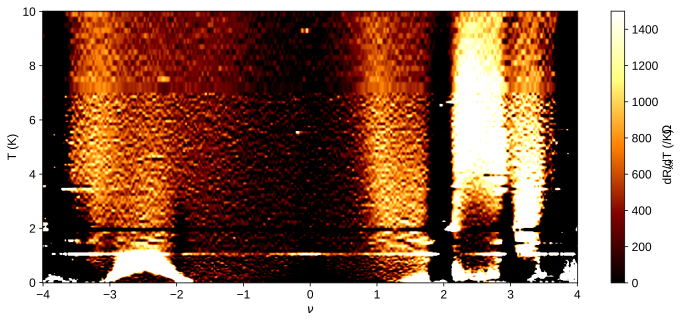

In [121]:
plt.figure(figsize=(12, 5)) # note that I didn't look up the amount of squares in this device, so these values are order 2 too large
plt.pcolormesh(x[100:-100], y, R3837deriv[:, 100:-100], cmap='afmhot', vmin=0, vmax=1500, rasterized=True)
plt.colorbar(label='dR$_{xx}$/dT ($\Omega$/K)')
plt.xlabel('$\\nu$')
plt.ylabel('T (K)')

Text(0, 0.5, 'T (K)')

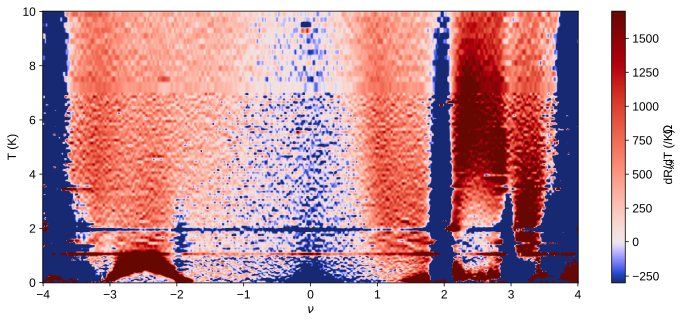

In [122]:
plt.figure(figsize=(12, 5)) # note that I didn't look up the amount of squares in this device, so these values are order 2 too large
plt.pcolormesh(x[100:-100], y, R3837deriv[:, 100:-100], cmap=cc.cm.diverging_bwr_20_95_c54, norm=TwoSlopeNorm(0, -300, 1700), rasterized=True)
plt.colorbar(label='dR$_{xx}$/dT ($\Omega$/K)')
plt.xlabel('$\\nu$')
plt.ylabel('T (K)')

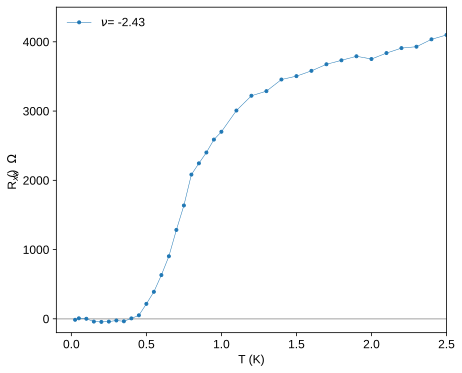

In [123]:
plt.figure(figsize=(7, 6))
gi1 = 106
gi2 = 110
gi3 = 115
fgi1 = filling3837_T[gi1]
fgi2 = filling3837_T[gi2]
fgi3 = filling3837_T[gi3]
xmin, xmax = -0.1, 2.5
ymin, ymax = -200, 4500

# plt.plot(np.ma.masked_outside(Tall3837, xmin, xmax), np.ma.masked_outside(R3837_all_2[:, gi1], ymin, ymax), '.-', lw=0.5, label='$\\nu$ = {:.2f}'.format(fgi1))
# plt.plot(np.ma.masked_outside(Tall3837, xmin, xmax), np.ma.masked_outside(R3837_all_2[:, gi2], ymin, ymax), '.-', lw=0.5, label='$\\nu$ = {:.2f}'.format(fgi2))
plt.plot(np.ma.masked_outside(Tall3837, xmin, xmax), np.ma.masked_outside(R3837_all_2[:, gi3], ymin, ymax), '.-', lw=0.5, label='$\\nu$ = {:.2f}'.format(fgi3))

plt.axis((xmin, xmax, ymin, ymax))
plt.hlines(0, xmin, xmax, color='gray', alpha=0.5)
plt.xlabel('T (K)')
plt.ylabel('R$_{xx}$ ($\Omega$)')
plt.legend(frameon=False, loc='upper left')

# ax = plt.axes((0.57, 0.22, 0.3, 0.4))
# xmin, xmax = -0.1, 1
# ymin, ymax = -100, 450
# # ax.plot(np.ma.masked_outside(Tall3837, xmin, xmax), np.ma.masked_outside(R3837_all_2[:, gi1], ymin, ymax), '.-', lw=0.5)
# # ax.plot(np.ma.masked_outside(Tall3837, xmin, xmax), np.ma.masked_outside(R3837_all_2[:, gi2], ymin, ymax), '.-', lw=0.5)
# plt.plot(np.ma.masked_outside(Tall3837, xmin, xmax), np.ma.masked_outside(R3837_all_2[:, gi3], ymin, ymax), '.-', lw=0.5)
# ax.axis((xmin, xmax, ymin, ymax))

# plt.savefig(figfile + 'M08_0p97_SC_Tlines.svg', dpi=300, bbox_inches='tight')

I made a function to find the superconducting dome points

Normalizing temperature 2.0
Normalizing temperature 1.0


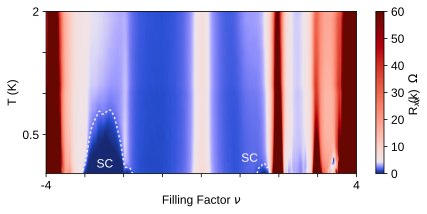

In [125]:
x = np.linspace(-5, 5, 1001)
y = np.linspace(0.025, 10, 801)
R3837int = gaussian_filter(R3837func(x, y).T, (0.8, 0.8))

plt.figure(figsize = (2*3.14961, 3.14961)) ### 40x80 mm
coff = TwoSlopeNorm(vcenter=4.5, vmin=0, vmax=60)
plt.pcolormesh(x, y, R3837int/1000, norm=coff, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)#cc.cm.diverging_bwg_20_95_c41)
plt.ylabel('T (K)')
plt.xlabel('Filling Factor $\\nu$')#, fontname='Arial', fontsize=12)
plt.ylim((0.025, 2))
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.yticks([0.5, 1, 1.5, 2], [0.5, '', '', 2])
plt.xticks(np.arange(-4, 5), [-4] + ['']*7 + [4])
plt.xlim((-4, 4))
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)


LW = 1.3
d = (1.7, 1.9)
# hole-side SC pocket###############################
scx1, scy1 = SCdomepts(filling3837_T, R3837_all_2, Tall3837, 30, 87, 145)
plt.plot(scx1, gaussian_filter(scy1, 1.3), linewidth=LW, color='white', linestyle='dashed', dashes=d)
##################################################

# electron-side SC pocket########################
scx2, scy2 = SCdomepts(filling3837_T, R3837_all_2, Tall3837, 20, 271, 288)
plt.plot(scx2, gaussian_filter(scy2, 1.3), linewidth=LW, color='white', linestyle='dashed', dashes=d)
##################################################
plt.text(-2.7, 0.1, 'SC', color='w')
plt.text(1.03, 0.17, 'SC', color='w')

plt.tight_layout()

# plt.savefig(figfile+'M08_to2K_Temp_linear.svg', bbox_inches='tight', dpi=300)

In [126]:
print('Max Tc: {} K'.format(np.max(scy1)))

Max Tc: 0.8 K


(-300.0, 7000.0)

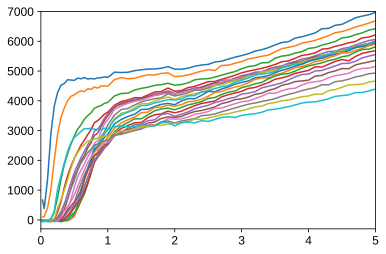

In [127]:
plt.figure()
for i in range(20):
    plt.plot(Tall3837, R3837_all_2[:, 92 +2*i])
    
plt.xlim(0, 5)
plt.ylim(-300, 7000)

In [128]:
# electron side
print('Max Tc: {} K'.format(np.max(scy2)))

Max Tc: 0.15 K


(-300.0, 8000.0)

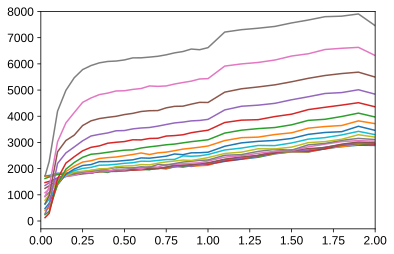

In [129]:
plt.figure()
for i in range(18):
    plt.plot(Tall3837, R3837_all_2[:, 266 + i])
    
plt.xlim(0, 2)
plt.ylim(-300, 8000)

Find the Tc based on the half the max resistance

Hole side

In [130]:
filling3837_T[115]

-2.425211684498476

(-0.1, 4.0, -0.1, 5.0)

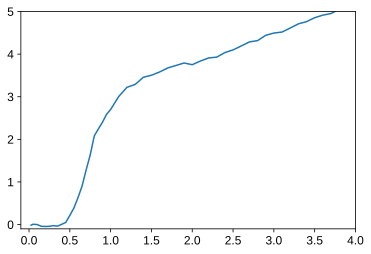

In [131]:
plt.figure()
plt.plot(Tall3837, R3837_all_2[:, 115]/1000)
# plt.plot(Tall3837, R3837_all_2[:, 130]/1000)
plt.axis((-0.1, 4, -0.1, 5))

In [132]:
def halfTc(temps, Rxx, n1, m1, n2, m2, pad=0.25):
    plt.plot(temps[n1:m1], Rxx[n1:m1])
    sl1, b1 = np.polyfit(temps[n1:m1], Rxx[n1:m1], 1)
    x1 = np.linspace(temps[n1] - pad, temps[m1] + pad, 3)
    plt.plot(x1, sl1*x1 + b1, 'k--', lw=0.7)

    plt.plot(temps[n2:m2], Rxx[n2:m2])
    sl2, b2 = np.polyfit(temps[n2:m2], Rxx[n2:m2], 1)
    x2 = np.linspace(temps[n2] - pad, temps[m2] + pad, 3)
    plt.plot(x2, sl2*x2 + b2, 'k--', lw=0.7)
    
    RN = (b1*sl2 - b2*sl1)/(sl2 - sl1)
    Tc = np.interp(RN/2, Rxx[n1:m1+5], temps[n1:m1+5])
    Tc10 = np.interp(RN*0.1, Rxx[n1-6:m1+5], temps[n1-6:m1+5])
    Tc90 = np.interp(RN*0.9, Rxx[n1:m1+10], temps[n1:m1+10])
    return Tc, Tc10, Tc90, RN/2


0.7422891789473113 1.5821537928783491


(-0.1, 5.0, -0.1, 5.0)

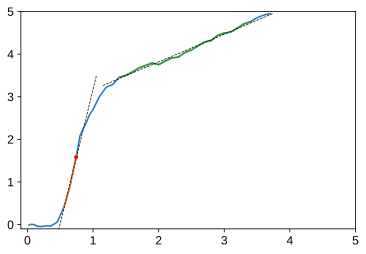

In [133]:
plt.figure()

xmin, xmax = -0.1, 5
ymin, ymax = -0.1, 5
# for i in range(9):
plt.plot(np.ma.masked_outside(Tall3837, xmin, xmax), np.ma.masked_outside(R3837_all_2[:, 115]/1000, ymin, ymax))

Tc, Tc10, Tc90, Rhalf = halfTc(Tall3837, R3837_all_2[:, 115]/1000, 11, 16, 24, 45)
plt.plot([Tc], [Rhalf], '.r')
print(Tc, Rhalf)

plt.axis((xmin, xmax, ymin, ymax))

In [134]:
print(Tc, Tc10, Tc90, Rhalf)

0.7422891789473113 0.528931964137081 1.0478914176156426 1.5821537928783491


Electron side

In [135]:
filling3837_T[279]

1.6333058283357094

(-0.1, 2.5, -0.1, 5.0)

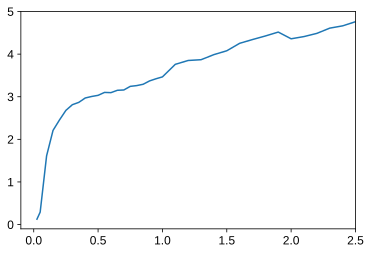

In [136]:
plt.figure()
plt.plot(Tall3837, R3837_all_2[:, 279]/1000)
# plt.plot(Tall3837, R3837_all_2[:, 282]/1000)
plt.axis((-0.1, 2.5, -0.1, 5))

In [137]:
def halfTc(temps, Rxx, n1, m1, n2, m2, pad=0.25):
    plt.plot(temps[n1:m1], Rxx[n1:m1])
    sl1, b1 = np.polyfit(temps[n1:m1], Rxx[n1:m1], 1)
    x1 = np.linspace(temps[n1] - pad, temps[m1] + pad, 3)
    plt.plot(x1, sl1*x1 + b1, 'k--', lw=0.7)

    plt.plot(temps[n2:m2], Rxx[n2:m2])
    sl2, b2 = np.polyfit(temps[n2:m2], Rxx[n2:m2], 1)
    x2 = np.linspace(temps[n2] - pad, temps[m2] + pad, 3)
    plt.plot(x2, sl2*x2 + b2, 'k--', lw=0.7)
    
    RN = (b1*sl2 - b2*sl1)/(sl2 - sl1)
    Tc = np.interp(RN/2, Rxx[n1:m1+5], temps[n1:m1+5])
    Tc10 = np.interp(RN*0.1, Rxx[n1-1:m1+5], temps[n1-1:m1+5])
    Tc90 = np.interp(RN*0.9, Rxx[n1:m1+5], temps[n1:m1+5])
    return Tc, Tc10, Tc90, RN/2

0.08910973144369079 0.045995439836860864 0.18605242288405255 1.325759254996833


(-0.1, 2.5, -0.1, 5.0)

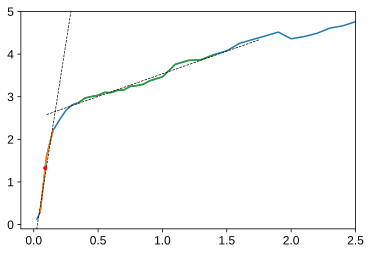

In [138]:
plt.figure()

xmin, xmax = -0.1, 2.5
ymin, ymax = -0.1, 5
# for i in range(9):
plt.plot(np.ma.masked_outside(Tall3837, xmin, xmax), np.ma.masked_outside(R3837_all_2[:, 279]/1000, ymin, ymax))

Tc, Tc10, Tc90, Rhalf = halfTc(Tall3837, R3837_all_2[:, 279]/1000, 1, 4, 7, 25)
plt.plot([Tc], [Rhalf], '.r')
print(Tc, Tc10, Tc90, Rhalf)

plt.axis((xmin, xmax, ymin, ymax))

In [139]:
print(Tc, Rhalf)

0.08910973144369079 1.325759254996833


## Now the gaps of the 1/2 and 3/4 filling

In [140]:
m1, b1 = np.polyfit(1/Tall3837[35:71], np.log(1/R3837_all_2[35:71, 293]), 1)
m2, b2 = np.polyfit(1/Tall3837[7:30], np.log(1/R3837_all_2[7:30, 333]), 1)

Text(4, 3.0000000000000004e-05, '$\\Delta_{1/2} = $ 0.656 meV\n$\\Delta_{3/4} = $ 0.078 meV')

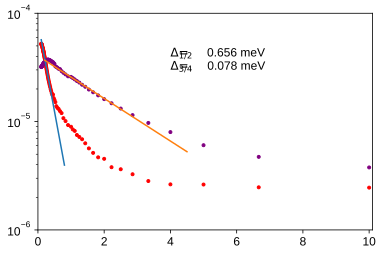

In [141]:
plt.figure(figsize=(6, 4))
plt.semilogy(1/Tall3837, 1/R3837_all_2[:, 293], 'r.', label='$\\nu = +1/2$')
plt.semilogy(1/Tall3837, 1/R3837_all_2[:, 333], '.', color='purple',  label='$\\nu = +3/4$')
x1 = np.array(np.linspace(0.1, 0.8, 20))
plt.semilogy(x1, np.exp(m1*x1 + b1))
x2 = np.array(np.linspace(0.2, 4.5, 20))
plt.semilogy(x2, np.exp(m2*x2 + b2))
# plt.xlabel('1/T (K$^{-1}$)')
# plt.ylabel('$\sigma$ (S)')
plt.axis([0, 10.1, 10**-6, 10**-4])
s1 = '$\Delta_{1/2} = $' + ' {:.3f} meV'.format(-m1*1.381e-23/1.602e-19*1000*2)
s2 = '$\Delta_{3/4} = $' + ' {:.3f} meV'.format(-m2*1.381e-23/1.602e-19*1000*2)
plt.text(4, 3*10**-5, s1+'\n'+s2)

# plt.savefig(figfile + 'M08_half_threequart_gapsize_Arrh', dpi=300)

## CNP T-dependence M08 0.97$^\circ$

In [142]:
filling3837_T[213] # cnp

0.0

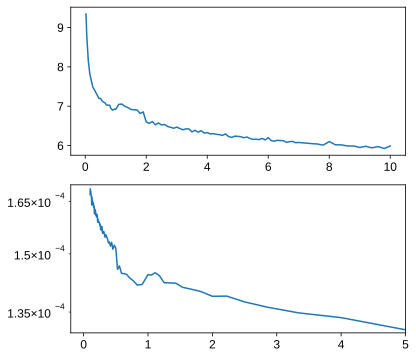

In [143]:
fig, ax = plt.subplots(2, 1, figsize=(6, 6))
ax[0].plot(Tall3837, R3837_all_2[:, 215]/1000)
ax[1].plot(1/Tall3837, 1/R3837_all_2[:, 215])
ax[1].axis([-0.2, 5, 1.3e-4, 1.7e-4])
ax[1].set_yscale('log')
ax[1].yaxis.set_minor_locator(plt.MaxNLocator(4))
# ax[1].set_yticks((1.3e-4, 1.5e-4, 1.7e-4))
# ax[1].yaxis.set_minor_formatter(plt.NullFormatter())

## M20

Here, the electrodes were mixed up a bit. The 0.87 degree data (15-14) was placed on lockin865 and the 0.83 degree data (16-15) was placed on lockin830 (the 0.79 degree data is on electrodes 16-21, and it's not measured in these particular data files)

In [144]:
dtempbase = qc.load_data('data/2019-12-24/#003_M20_15-16_865_15-14_830_gatesweepbasetemp_0p4nA_14-26-12')
dtemp_1 = qc.load_data('data/2019-12-24/#004_M20_15-16_865_15-14_830_gateTsweepto1K_0p4nA_14-49-37')
dtemp_2 = qc.load_data('data/2019-12-24/#005_M20_15-16_865_15-14_830_gateTsweep1p1to1p4K_0p4nA_22-04-45')
dtemp_3 = qc.load_data('data/2019-12-24/#006_M20_15-16_865_15-14_830_gateTsweep1p5to2K_0p4nA_23-31-43')
dtemp_4 = qc.load_data('data/2019-12-26/#001_M20_15-16_865_15-14_830_gateTsweep2p2to10K_0p4nA_11-10-10')
dtemp_5 = qc.load_data('data/2019-12-27/#001_M20_15-16_865_15-14_830_gateTsweep11to30K_0p4nA_01-39-29')
dtemp_6 = qc.load_data('data/2019-12-27/#002_M20_15-16_865_15-14_830_gateTsweep31to40K_0p4nA_11-14-22')
dtemp_7 = qc.load_data('data/2019-12-27/#003_M20_15-16_865_15-14_830_gateTsweep41to50K_0p4nA_14-11-39')

## Start with 0.87$^\circ$

In [513]:
temps = np.concatenate(([0.025], dtemp_1.triton_pid_setpoint_set, dtemp_2.triton_pid_setpoint_set[:], dtemp_3.triton_pid_setpoint_set, dtemp_4.triton_pid_setpoint_set[:], dtemp_5.triton_pid_setpoint_set, dtemp_6.triton_pid_setpoint_set[:], dtemp_7.triton_pid_setpoint_set[:]))
tgate = dtempbase.srframe_volt_p1_set[:]
R1514 = np.vstack((npd.Rxxfromdata(dtempbase, 0.4e-9), npd.Rxxfromdata(dtemp_1, 0.4e-9), npd.Rxxfromdata(dtemp_2, 0.4e-9), npd.Rxxfromdata(dtemp_3, 0.4e-9), npd.Rxxfromdata(dtemp_4, 0.4e-9), npd.Rxxfromdata(dtemp_5, 0.4e-9), npd.Rxxfromdata(dtemp_6, 0.4e-9), npd.Rxxfromdata(dtemp_7, 0.4e-9)))

In [146]:
R1514corr = np.copy(R1514)
R1514corr[R1514 <= 0] = np.min(np.abs(R1514[R1514 > 0]))

In [147]:
tgate_corr = tgate[:-2]  # need to correct for a gate offset at 11K
R1514corr = R1514corr[:, :-2]
R1514corr[71:, :] = R1514[71:, 2:]

In [148]:
Vgatefull1514 = 4.232980388741174
V01514 = 0.25876000000000016 - 0.03
nfull = 1.7515626870221186

In [149]:
nugate1514 = np.interp(tgate_corr, [V01514 - Vgatefull1514*6/4, V01514 + Vgatefull1514*6/4], [-6, 6])

In [150]:
R1514Tfunc_1 = RectBivariateSpline(nugate1514, temps, R1514corr.T, kx=1, ky=1)  # for 

In [151]:
nT1514 = np.interp(tgate_corr, [V01514 - Vgatefull1514*6/4, V01514 + Vgatefull1514*6/4], [-6/4*nfull, 6/4*nfull])

(0.03, 300)

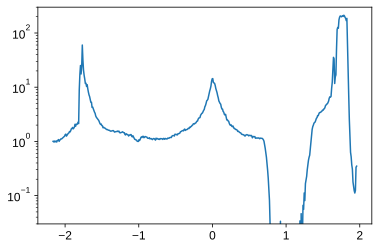

In [152]:
# base temp sweep
nT1514 = np.interp(tgate_corr, [V01514 - Vgatefull1514*6/4, V01514 + Vgatefull1514*6/4], [-6/4*nfull, 6/4*nfull])
plt.figure()
plt.semilogy(nT1514, R1514corr[0, :]/1000)
plt.ylim(0.03, 300)

# np.savetxt(BaseTfile + 'M20_0p87_RxxvsN.txt', np.vstack((nT1514, R1514corr[0, :])), fmt='%.8e', header='electron density (in 10^12 cm^-2) vs Rxx at base temp')

Low temp SC

Normalizing temperature 2.0


Text(2.1, 0.1, 'SC')

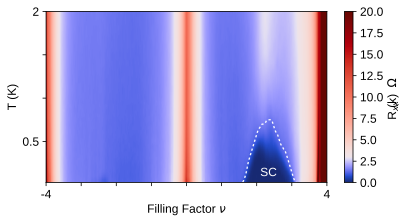

In [156]:
x = np.linspace(-5, 5, 1001)
y = np.linspace(0.025, 10, 801)
R1514Tint = gaussian_filter(R1514Tfunc_1(x, y).T, (0.8, 0.8))

plt.figure(figsize = (2*3.14961, 3.14961)) ### 40x80 mm
coff = TwoSlopeNorm(vcenter=3, vmin=0, vmax=20)
plt.pcolormesh(x, y, R1514Tint/1000, norm=coff, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)#cc.cm.diverging_bwg_20_95_c41)
plt.ylabel('T (K)')
plt.xlabel('Filling Factor $\\nu$')#, fontname='Arial', fontsize=12)
plt.ylim((0.025, 2))
plt.colorbar(label='R$_{xx}$ (k$\Omega$)', ticks=np.arange(0, 22.5, 2.5))
plt.yticks([0.5, 1, 1.5, 2], [0.5, '', '', 2])
plt.xticks(np.arange(-4, 5), [-4] + ['']*7 + [4])
plt.xlim((-4, 4))
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)


LW = 1.3
d = (1.7, 1.9)
# electron-side SC pocket###############################
# scx, scy = SCdomepts(nugate1514, R1514corr, temps, 25, 348, 427)
# plt.plot(scx, gaussian_filter(scy, 0), linewidth=LW, color='white', linestyle='dashed', dashes=d)
scx, scy = SCdomepts(nugate1514, R1514corr, temps, 30, 346, 430)
plt.plot(scx, gaussian_filter(scy, 1.3), linewidth=LW, color='w', linestyle='dashed', dashes=d)
##################################################

plt.text(2.1, 0.1, 'SC', color='w')
# plt.savefig(figfile + 'M20_0p87_to2Ktemp_linear.svg', dpi=300, bbox_inches='tight')

In [157]:
print('Max Tc: {} K'.format(np.max(scy)))

Max Tc: 0.75 K


In [158]:
mind = np.argmax(scy)
print('Max filling: nu = {:.3f}'.format(nugate1514[348 + mind]))

Max filling: nu = 2.468


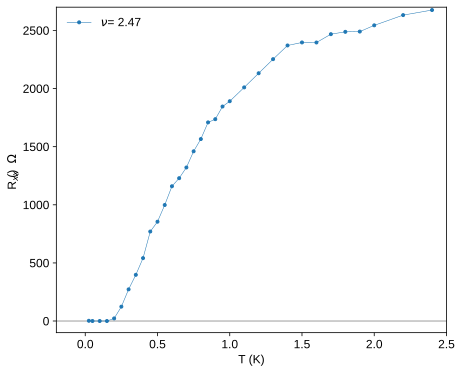

In [159]:
plt.figure(figsize=(7,6))

xmin, xmax = -0.2, 2.5
ymin, ymax = -100, 2700
# plt.plot(temps, R1514corr[:, 380], '.-', lw=0.5)
plt.plot(np.ma.masked_outside(temps, xmin, xmax), np.ma.masked_outside(R1514corr[:, 348 + mind], ymin, ymax), '.-', lw=0.5, label='$\\nu$ = {:.2f}'.format(nugate1514[348+mind]))
    
plt.xlim(xmin, xmax)
plt.ylim(ymin, ymax)
plt.hlines(0, xmin, xmax, color='gray', alpha=0.5)
plt.xlabel('T (K)')
plt.ylabel('R$_{xx}$ ($\Omega$)')
plt.legend(frameon=False, loc='upper left')

# xmin, xmax = -0.1, 0.4
# ymin, ymax = -50, 140
# ax = plt.axes((0.53, 0.22, 0.33, 0.37))
# ax.plot(np.ma.masked_outside(temps, xmin, xmax), np.ma.masked_outside(R1514corr[:, 348 + mind], ymin, ymax), '.-', lw=0.5)
# ax.axis((-0.1, 0.4, -50, 140))

# plt.savefig(figfile + 'M20_0p87_SC_Tlines.svg', dpi=300, bbox_inches='tight')

Find the Tc

Hole side. Is there anything?

In [160]:
nugate1514[379]

2.221829334483852

(-0.1, 1.0, -0.1, 2.0)

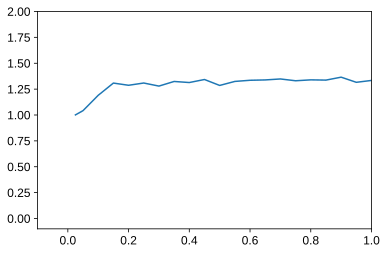

In [161]:
plt.figure() # this is all. Not enough to declare SC
plt.plot(temps, R1514corr[:, 139]/1000)
# plt.plot(Tall3837, R3837_all_2[:, 130]/1000)
plt.axis((-0.1, 1, -0.1, 2))

Electron side

In [162]:
nugate1514[143]

-2.2383850454874747

(-0.1, 4.0, -0.1, 4.0)

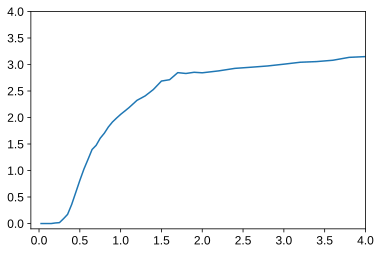

In [163]:
plt.figure()
plt.plot(temps, R1514corr[:, 379]/1000)
# plt.plot(temps, R1514corr[:, 370]/1000)

plt.axis((-0.1, 4, -0.1, 4))

In [164]:
def halfTc(temps, Rxx, n1, m1, n2, m2, pad=0.25):
    plt.plot(temps[n1:m1], Rxx[n1:m1])
    sl1, b1 = np.polyfit(temps[n1:m1], Rxx[n1:m1], 1)
    x1 = np.linspace(temps[n1] - pad, temps[m1] + pad, 3)
    plt.plot(x1, sl1*x1 + b1, 'k--', lw=0.7)

    plt.plot(temps[n2:m2], Rxx[n2:m2])
    sl2, b2 = np.polyfit(temps[n2:m2], Rxx[n2:m2], 1)
    x2 = np.linspace(temps[n2] - pad, temps[m2] + pad, 3)
    plt.plot(x2, sl2*x2 + b2, 'k--', lw=0.7)
    
    RN = (b1*sl2 - b2*sl1)/(sl2 - sl1)
    Tc = np.interp(RN/2, Rxx[n1:m1+5], temps[n1:m1+5])
    Tc10 = np.interp(RN*0.1, Rxx[n1-3:m1+5], temps[n1-3:m1+5])
    Tc90 = np.interp(RN*0.9, Rxx[n1:m1+12], temps[n1:m1+12])
    return Tc, Tc10, Tc90, RN/2


0.6262759138419757 0.3738042069363306 1.235965823488625 1.3076046371910053


(-0.1, 5.0, -0.1, 5.0)

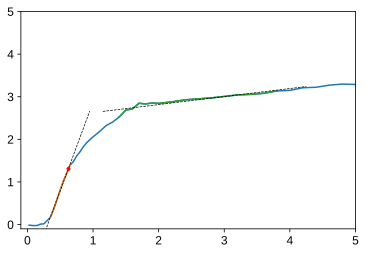

In [165]:
plt.figure()

xmin, xmax = -0.1, 5
ymin, ymax = -0.1, 5
# for i in range(9):
plt.plot(np.ma.masked_outside(temps, xmin, xmax), np.ma.masked_outside(R1514[:, 379]/1000, ymin, ymax))

Tc, Tc10, Tc90, Rhalf = halfTc(temps, R1514[:, 379]/1000, 7, 14, 24, 40)
plt.plot([Tc], [Rhalf], '.r')
print(Tc, Tc10, Tc90, Rhalf)

plt.axis((xmin, xmax, ymin, ymax))

In [166]:
print(Tc, Rhalf)

0.6262759138419757 1.3076046371910053


High temp and gaps

(0.025, 40.0)

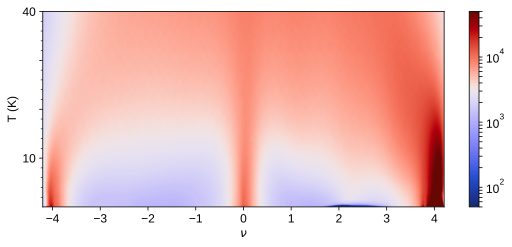

In [168]:
x = np.linspace(-4.2, 4.2, 1000)
y = np.linspace(0.025, 50, 1000)
plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R1514Tfunc_1(x, y).T, (0.8, 0.8)), norm=npd.DivLogNorm(0.6, vmin=50, vmax=0.5e5), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext())
plt.ylabel('T (K)')
plt.yticks([10, 20, 30, 40], [10, '', '', 40])
plt.minorticks_on()
plt.tick_params(axis='x', which='minor', bottom=False)
plt.xlabel(r'$\nu$')
plt.ylim((0.025, 40))

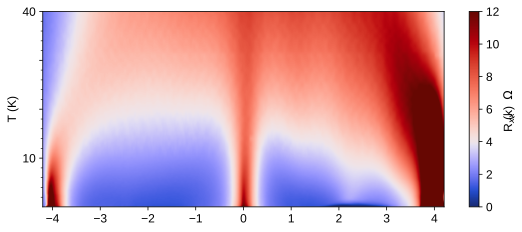

In [169]:
x = np.linspace(-4.2, 4.2, 1000)
y = np.linspace(0.025, 50, 600)
plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R1514Tfunc_1(x, y).T, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vmin=0, vcenter=4, vmax=12), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.ylabel('T (K)')
# plt.xlabel(r'$\nu$')
plt.ylim((0.025, 40))
plt.yticks([10, 20, 30, 40], [10, '', '', 40])
plt.minorticks_on()
plt.tick_params(axis='x', which='minor', bottom=False)
# plt.savefig(figfile + 'M20_0p87_Tempgateto40K_linear.svg', dpi=300, bbox_inches='tight')

d$\rho$/dT

In [170]:
nulin = np.linspace(-4.2, 4.2, 1001)
Tlin = np.linspace(0.025, 40, 300)
dT = Tlin[1] - Tlin[0]
R1514lin = R1514Tfunc_1(nulin, Tlin).T
R1514deriv = np.gradient(gaussian_filter(R1514lin, (2.5, 2)), dT, axis=0)
sqs = 30.55/10.01

1.50 is not a value in the array
Plotted 1.50 instead
1.80 is not a value in the array
Plotted 1.80 instead
xints: [679, 714]
15.00 is not a value in the array
Plotted 15.00 instead
38.00 is not a value in the array
Plotted 37.99 instead
yints: [112, 284]
-2.00 is not a value in the array
Plotted -2.00 instead
-1.60 is not a value in the array
Plotted -1.60 instead
xints: [262, 310]
15.00 is not a value in the array
Plotted 15.00 instead
38.00 is not a value in the array
Plotted 37.99 instead
yints: [112, 284]


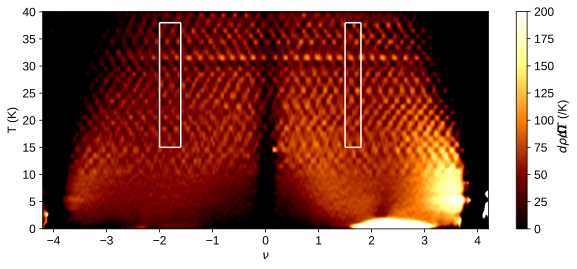

In [171]:
plt.figure(figsize=(10, 4))
plt.pcolormesh(nulin, Tlin, R1514deriv/sqs, cmap='afmhot', vmin=0, vmax=200, rasterized=True)
plt.colorbar(label='$d\\rho/dT$ ($\Omega$/K)')
plt.xlabel('$\\nu$')
plt.ylabel('T (K)')
plotbox(1.5, 1.8, 15, 38, nulin, Tlin, color='white')
plotbox(-2, -1.6, 15, 38, nulin, Tlin, color='white')

In [172]:
# electrons
np.average(R1514deriv[112:284, 679:714]/sqs), np.std(R1514deriv[112:284, 679:714]/sqs, ddof=1)

(53.074411183389564, 16.777734943700246)

In [173]:
# holes
np.average(R1514deriv[112:284, 262:310]/sqs), np.std(R1514deriv[112:284, 262:310]/sqs, ddof=1)

(43.0953026615629, 13.79524906917669)

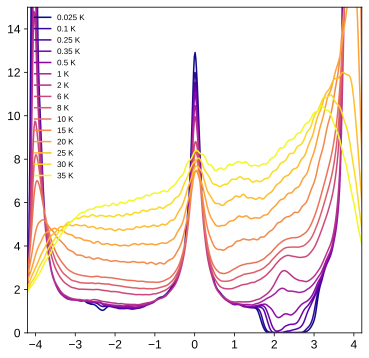

In [174]:
fig1 = plt.figure(figsize=(6, 6), facecolor= 'white', dpi=300)
ax1 = fig1.add_subplot(111)

Tselect = [0.025, 0.1, 0.25, 0.35, 0.5, 1, 2, 6, 8, 10, 15, 20, 25, 30, 35]
line_selection=npd.val_to_index([0.025, 0.1, 0.25, 0.35, 0.5, 1, 2, 6, 8, 10, 15, 20, 25, 30, 35], temps)

for n, i in enumerate(line_selection):
    Temp = Tselect[n]
    label1=f"{Temp} K"
    ax1.plot(nugate1514, gaussian_filter(R1514corr[i,:], 1.8)/1000, label=label1, rasterized=True)

plt.xlim(-4.2, 4.2)
plt.ylim(0, 15)


colormap = plt.cm.plasma #nipy_spectral, Set1,Paired   
colors = [colormap(i) for i in np.linspace(0, 1,len(ax1.lines))]
for i,j in enumerate(ax1.lines):
    j.set_color(colors[i])

# need to add legend 
ax1.legend(loc=2, prop={'size': 8}, frameon=False)
# plt.savefig(figfile + 'M20_0p87_Tempgatepickedplots.svg', dpi=300, bbox_inches='tight')

## Find peaks on the electron side

Fit the electron-side peaks

In [175]:
window = 8
ind1, ind2 = npd.val_to_index([1.8, 2.5], nugate1514)
startT2, endT2 = 28, len(temps)-44
T2 = []
nu2peakind = []
nu2peak = []
nu2peakR = []
for i in range(startT2, endT2):
    try:
        # First the simple peak fit (use a gaussian filter to get rid of smaller bumps)
        R = gaussian_filter(R1514corr[i, ind1:ind2]/1000, 0.7)
        pind = int(find_peaks(R, prominence=0.02, distance=30)[0][0] + ind1)
        nu2peakind.append(pind)
        T2.append(temps[i])
        # Then do a quadratic fit and take the peak
        a, b, c = np.polyfit(nugate1514[pind-window:pind+window], gaussian_filter(R1514corr[i, pind-window:pind+window], 0.7), 2)
        xpeak = -b/(2*a)
        nu2peak.append(xpeak)
        nu2peakR.append(a*xpeak**2 + b*xpeak + c)
    except:
        continue

window = 9
ind1, ind2 = npd.val_to_index([0.7, 1.6], nugate1514)      
startT1, endT1 = 70, len(temps)
T1 = []
nu1peakind = []
nu1peak = []
nu1peakR = []
for i in range(startT1, endT1):
    try:
        R = gaussian_filter(R1514corr[i, ind1:ind2]/1000, 2.5)
        pind = int(find_peaks(R, prominence=0.01, distance=3)[0][0] + ind1)
        nu1peakind.append(pind)
        T1.append(temps[i])
        a, b, c = np.polyfit(nugate1514[pind-window:pind+window], gaussian_filter(R1514corr[i, pind-window:pind+window], 1.5), 2)
        xpeak = -b/(2*a)
        nu1peak.append(xpeak)
        nu1peakR.append(a*xpeak**2 + b*xpeak + c)
    except:
        continue

1.80 is not a value in the array
Plotted 1.81 instead
2.50 is not a value in the array
Plotted 2.51 instead
0.70 is not a value in the array
Plotted 0.69 instead
1.60 is not a value in the array
Plotted 1.60 instead


(-0.5, 3.5)

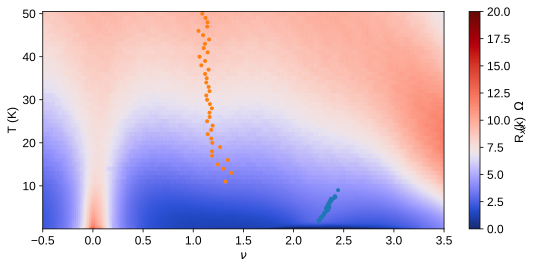

In [176]:
fig, ax = plt.subplots(1, 1, figsize=(9, 4))
norm = TwoSlopeNorm(7, 0, 20)
p = ax.pcolormesh(nugate1514, temps, R1514corr/1000, norm=norm, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
ax.set_ylabel('T (K)')
ax.set_xlabel('$\\nu$')
fig.colorbar(p, ax=ax, label='R$_{xx}$ (k$\Omega$)')
ax.plot(nu2peak, T2, '.')
ax.plot(nu1peak, T1, '.')
ax.set_xlim(-0.5, 3.5)

(0.4, 3.4, 0.0, 11.0)

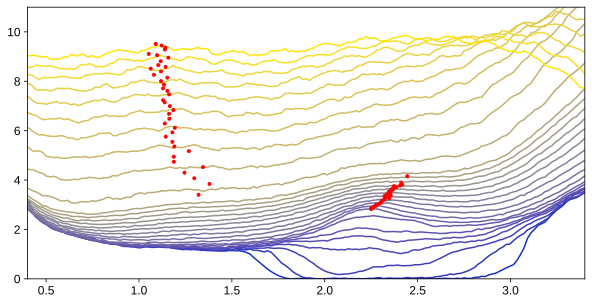

In [177]:
N = 28
colors = plt.get_cmap('cet_bjy')([i/(N-1) for i in range(N)])

fig, ax = plt.subplots(1, 1, figsize=(10, 5))
for i in range(N):
    indx = i*4
    ax.plot(nugate1514, gaussian_filter(R1514corr[indx, :]/1000, 0.5), color=colors[i], label='{:.2f} K'.format(temps[indx]))


ax.plot(nu1peak, np.array(nu1peakR)/1000, '.r')
ax.plot(nu2peak, np.array(nu2peakR)/1000, '.r')
ax.axis((0.4, 3.4, 0, 11))
# l = plt.legend()

In [178]:
# np.savetxt(Peakfile+'M20_0p87_nu1peaks.txt', np.vstack((T1, nu1peak, nu1peakR)).T, fmt='%.8e', header='columns: Temperatures (K), nu, Resistance (ohms)')
# np.savetxt(Peakfile+'M20_0p87_nu2peaks.txt', np.vstack((T2, nu2peak, nu2peakR)).T, fmt='%.8e', header='columns: Temperatures (K), nu, Resistance (ohms)')

## Get the gaps

First load the lmfit fitting function routine

In [179]:
def fit_function(x, sigma1, sigma2, delta, t0): # here x is 1/(temperature *boltzman constant)
    sigma=sigma1*np.exp(-delta/2*x)+sigma2*np.exp(-np.power((t0*x),1.0/3))
    
    return sigma


def fit_function2(x, sigma1, sigma2, delta): # here x is 1/(temperature *boltzman constant)
    sigma=sigma1*np.exp(-delta/2*x)+sigma2
    return sigma



sigmamodel=Model(fit_function)
sigmamodel2=Model(fit_function2)
print('parameter names: {}'.format(sigmamodel.param_names))
print('independent variables: {}'.format(sigmamodel.independent_vars))

print('parameter names: {}'.format(sigmamodel2.param_names))
print('independent variables: {}'.format(sigmamodel2.independent_vars))

parameter names: ['sigma1', 'sigma2', 'delta', 't0']
independent variables: ['x']
parameter names: ['sigma1', 'sigma2', 'delta']
independent variables: ['x']


In [180]:
n1 = -39
n1_b = -35
n2 = None
vfullnind = npd.val_to_index([-4.03], tgate_corr)[0]
sl, b = np.polyfit(1/temps[n1:n2], np.log(1/R1514corr[n1:n2, vfullnind]), 1)

vfullpind = npd.val_to_index([4.56], tgate_corr)[0]
sl2, b2 = np.polyfit(1/temps[n1_b:n2], np.log(1/R1514corr[n1_b:n2, vfullpind]), 1)

-4.03 is not a value in the array
Plotted -4.04 instead


Just linear fits

Text(0, 0.5, '$\\sigma$ (S)')

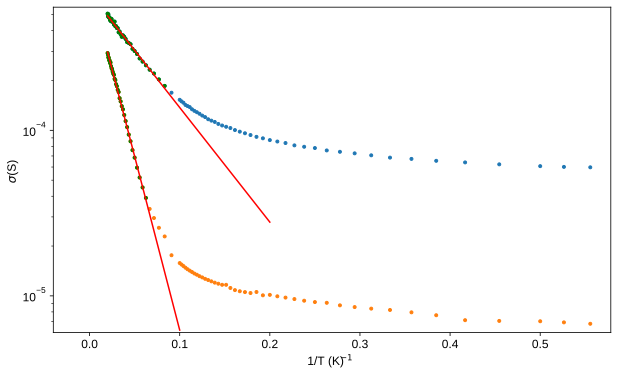

In [181]:
plt.figure(figsize=(10, 6))
plt.semilogy(1/temps, 1/R1514corr[:, vfullnind], '.')
plt.semilogy(1/temps, 1/R1514corr[:, vfullpind], '.')
n1 = -39
n1_b = -35
n2 = None
plt.semilogy(1/temps[n1:n2], 1/R1514corr[n1:n2, vfullnind], '.g')
plt.semilogy(1/temps[n1_b:n2], 1/R1514corr[n1_b:n2, vfullpind], '.g')
x1 = np.linspace(0.02, 0.2, 100)
x2 = np.linspace(0.02, 0.1, 100)
plt.semilogy(x1, np.exp(sl*x1 + b), 'r')
plt.semilogy(x2, np.exp(sl2*x2 + b2), 'r')
plt.axis((-0.04023375983350719,
 0.5783321406867843,
 6.007336170389627e-06,
 0.0005546353916986992))
plt.xlabel('1/T (K$^{-1}$)')
plt.ylabel('$\sigma$ (S)')

In [182]:
gap1514h = -sl*1.381e-23/1.602e-19*2*1000 # hole-side gap in meV (blue data points)
print(gap1514h)

2.747943042450762


In [183]:
gap1514e = -sl2*1.381e-23/1.602e-19*2*1000 # electron-side gap in meV (yellow data points)
print(gap1514e)

8.332258464360965


### Linear fit: Gaps for 0.87$^\circ$ -- hole side: 2.75 meV, electron side: 8.33 meV

### Now lmfit function

In [184]:
# some parameter guesses. Really just the resulting fits that we should get below
ss1=6.1810e-4
d1=43.7499 # 3.76 meV
ss2=1.3035e-4
tt0=0.7555

ss1p=8.7161e-04
d1p=108.970164 # 9.4 meV
ss2p=2.2500e-05
tt0p=2.72898093

For these fits, Stevan only had temperatures up to 40K, so I removed the 41-50K data here. Then, he only used down to 1 K for the electron side, and all the temperatures for the hole side.

In [185]:
1/temps[30]

0.5

Hole side results:
[[Model]]
    Model(fit_function)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 36
    # data points      = 101
    # variables        = 4
    chi-square         = 1.4729e-09
    reduced chi-square = 1.5185e-11
    Akaike info crit   = -2512.06541
    Bayesian info crit = -2501.60493
[[Variables]]
    sigma1:  6.1810e-04 +/- 4.3528e-06 (0.70%) (init = 0.0006181)
    sigma2:  1.3034e-04 +/- 4.2797e-06 (3.28%) (init = 0.00013035)
    delta:   43.7499165 +/- 0.54766590 (1.25%) (init = 33)
    t0:      0.75549526 +/- 0.09628526 (12.74%) (init = 0.1)
[[Correlations]] (unreported correlations are < 0.100)
    C(sigma2, t0)    =  0.955
    C(sigma2, delta) =  0.717
    C(sigma1, delta) =  0.599
    C(delta, t0)     =  0.586
    C(sigma1, t0)    = -0.117
Electron side results:
[[Model]]
    Model(fit_function)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 31
    # data points      = 81
    # variables        = 4
 

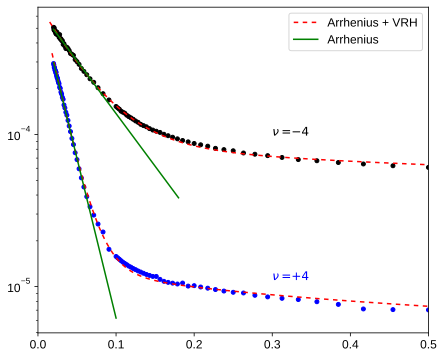

In [186]:
sigma_datan = 1/R1514corr[:-10, vfullnind]
sigma_datap = 1/R1514corr[20:-10, vfullpind]
temp1 = temps[20:-10]

resultn = sigmamodel.fit(sigma_datan, x=1/temps[:-10], sigma1=ss1, sigma2=ss2, delta=33, t0=0.1)
resultp = sigmamodel.fit(sigma_datap, x=1/temp1, sigma1=ss1p, sigma2=ss2p, delta=90, t0=0.3)

print('Hole side results:')
print(resultn.fit_report())

print('Electron side results:')
print(resultp.fit_report())

plt.figure(figsize=(7, 6))

x1 = np.linspace(0.015, 0.5, 300)
x2 = np.linspace(0.018, 0.5, 300)

plt.semilogy(1/temps[30:], 1/R1514corr[30:, vfullnind], 'ko', ms=4)
# plt.semilogy(1/temps[:-10], resultn.init_fit, 'k--', label='initial fit')
# plt.semilogy(1/temps[:-10], resultn.best_fit, 'r--', label='best fit', dashes=(2, 2))
plt.semilogy(x1, fit_function(x1, ss1,ss2,d1,tt0), 'r--', label='Arrhenius + VRH', dashes=(3, 3))

plt.semilogy(1/temps[30:], 1/R1514corr[30:, vfullpind], 'bo', ms=4)
# plt.semilogy(1/temp1, resultp.init_fit, 'k--', label='initial fit')
# plt.semilogy(1/temp1, resultp.best_fit, 'r--', label='best fit', dashes=(2, 2))
plt.semilogy(x2, fit_function(x2, ss1p,ss2p,d1p,tt0p), 'r--', dashes=(3, 3))
# plt.legend(loc='best')

#include linear fits too
x1 = np.linspace(0.02, 0.18, 100)
x2 = np.linspace(0.02, 0.1, 100)
plt.semilogy(x1, np.exp(sl*x1 + b), 'g', label='Arrhenius')
plt.semilogy(x2, np.exp(sl2*x2 + b2), 'g')
plt.legend()
plt.xlim(0, 0.5)
plt.text(0.3, 0.98e-4, '$\\nu=-4$')
plt.text(0.3, 1.1e-5, '$\\nu=+4$', color='b')
plt.savefig(figfile + 'M20_0p87_fullfillinggapfits.svg', dpi=300, bbox_inches='tight')

In [187]:
43.74*1.381e-23/1.602e-19*1000

3.770595505617978

In [188]:
108.9*1.381e-23/1.602e-19*1000

9.387696629213483

### lmfit gaps: 3.7 meV on the hole side, 9.4 meV on the electron side

Now comparing the 0.97 degree data at 1/2 and 3/4 filling with the 0.87 degree data for the peak near 1/2

In [189]:
temps[30]

2.0

In [190]:
maxind = np.argmax(R1514corr[30, 357:415])
maxnu = nugate1514[357 + maxind]
print(maxnu)

2.240728547958307


In [191]:
quarterind = npd.val_to_index([1], nugate1514)

1.00 is not a value in the array
Plotted 0.99 instead


In [192]:
m1, b1 = np.polyfit(1/Tall3837[35:71], np.log(1/R3837_all_2[35:71, 293]), 1)
m2, b2 = np.polyfit(1/Tall3837[7:30], np.log(1/R3837_all_2[7:30, 333]), 1)

(0.0, 5.0)

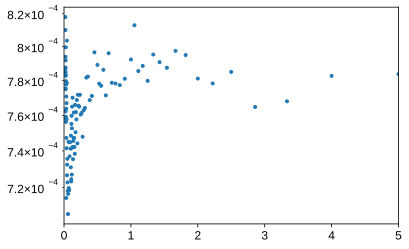

In [193]:
plt.figure()
plt.semilogy(1/temps, 1/R1514corr[:, maxind], '.')
plt.xlim(0, 5)

In [194]:
temps[90]

30.0

In [195]:
Tall3837[-1]

10.0

In [196]:
maxind

23

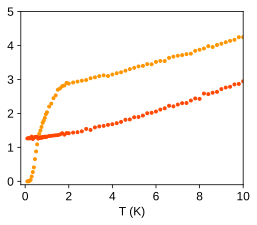

In [197]:
fig, ax = plt.subplots(figsize=(4, 3.2))
xmin = -0.2
xmax = 10
ax.plot(np.ma.masked_outside(temps[2:90], xmin, xmax), R1514corr[2:90, 357 + maxind]/1000, '.', color=(255/256, 150/256, 0.), label='0.87 $\\nu$$\\approx$+2')  # only plot to 20K
ax.plot(np.ma.masked_outside(temps[2:90], xmin, xmax), R1514corr[2:90, quarterind]/1000, '.', color=(256/256, 70/256, 0.), label='0.87 $\\nu$=+1')
# plt.legend()
plt.axis([xmin, xmax, -0.1, 5])
plt.xlabel('T (K)')
plt.savefig(figfile + 'M20_0p87_nu1_2_temp.svg', dpi=300, bbox_inches='tight')

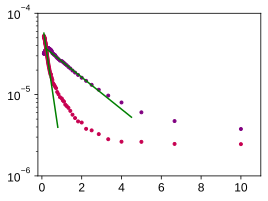

In [198]:
plt.figure( figsize=(4, 3))
xmin = -0.2
xmax = 11
plt.semilogy(np.ma.masked_outside(1/Tall3837[2:], xmin, xmax), 1/R3837_all_2[2:, 333], '.', color='purple',  label='0.97 $\\nu$=+3')
plt.semilogy(np.ma.masked_outside(1/Tall3837[2:], xmin, xmax), 1/R3837_all_2[2:, 293], '.', color=(200/256, 0/256, 80/256), label='0.97 $\\nu$=+2')
x1 = np.array(np.linspace(0.1, 0.8, 20))
plt.semilogy(x1, np.exp(m1*x1 + b1), 'g')
x2 = np.array(np.linspace(0.2, 4.5, 20))
plt.semilogy(x2, np.exp(m2*x2 + b2), 'g')

plt.axis((xmin, xmax, 10**-6, 10**-4))
plt.savefig(figfile + 'M08_0p97_nu2_3_gaps.svg', dpi=300, bbox_inches='tight')

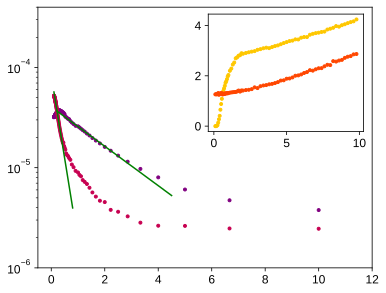

In [199]:
plt.figure( figsize=(6, 4.8))
plt.semilogy(1/Tall3837[2:], 1/R3837_all_2[2:, 333], '.', color='purple',  label='0.97 $\\nu$=+3')
plt.semilogy(1/Tall3837[2:], 1/R3837_all_2[2:, 293], '.', color=(200/256, 0/256, 80/256), label='0.97 $\\nu$=+2')
x1 = np.array(np.linspace(0.1, 0.8, 20))
plt.semilogy(x1, np.exp(m1*x1 + b1), 'g')
x2 = np.array(np.linspace(0.2, 4.5, 20))
plt.semilogy(x2, np.exp(m2*x2 + b2), 'g')

# plt.text(15, 4e-4, '0.87 $\\nu \\approx$+2', color=(255/256, 140/256, 0.))
# plt.legend(frameon=False, loc='upper left')
plt.xlim(-0.5, 12)
plt.ylim(1e-6, 4e-4)

ax = plt.axes([0.52, 0.52, 0.36, 0.34])
ax.plot(temps[2:70], R1514corr[2:70, 357 + maxind]/1000, '.', color=(255/256, 200/256, 0.), label='0.87 $\\nu$$\\approx$+2')  # only plot to 20K
ax.plot(temps[2:70], R1514corr[2:70, quarterind]/1000, '.', color=(256/256, 70/256, 0.), label='0.87 $\\nu$=+1')  # only plot to 20K
# ax.legend()

# plt.xlabel('1/T (K$^{-1}$)')
# plt.ylabel('$\sigma$ (S)')
# plt.axis([0, 10.1, 10**-6, 10**-4])
# s1 = '$\Delta_{1/2} = $' + ' {:.3f} meV'.format(-m1*1.381e-23/1.602e-19*1000*2)
# s2 = '$\Delta_{3/4} = $' + ' {:.3f} meV'.format(-m2*1.381e-23/1.602e-19*1000*2)
# plt.text(4, 3*10**-5, s1+'\n'+s2)

# plt.savefig(figfile + 'M20M08_half_threequart_correlatedgaps.svg', dpi=300, bbox_inches='tight')

In [200]:
nugate1514[357 + maxind]

2.240728547958307

## CNP T dependence for 0.87$^\circ$

In [201]:
nugate1514[262]

0.010621357972643963

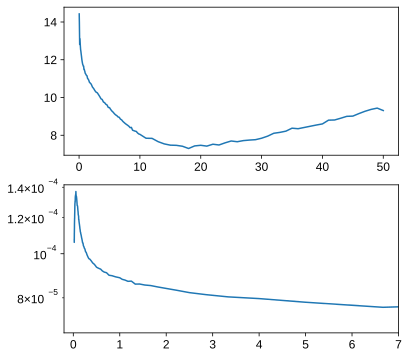

In [202]:
fig, ax = plt.subplots(2, 1, figsize=(6, 6))
ax[0].plot(temps, R1514corr[:, 262]/1000)
ax[1].plot(1/temps, 1/R1514corr[:, 262])
ax[1].set_yscale('log')
ax[1].set_xlim(-0.2, 7)
ax[1].yaxis.set_minor_locator(plt.MaxNLocator(4))

## 0.83$^\circ$

In [203]:
R1615 = np.vstack((npd.Rxxfromdata(dtempbase, 0.4e-9, instrument='lockin830'), npd.Rxxfromdata(dtemp_1, 0.4e-9, instrument='lockin830'), npd.Rxxfromdata(dtemp_2, 0.4e-9, instrument='lockin830'), npd.Rxxfromdata(dtemp_3, 0.4e-9, instrument='lockin830'), npd.Rxxfromdata(dtemp_4, 0.4e-9, instrument='lockin830'), npd.Rxxfromdata(dtemp_5, 0.4e-9, instrument='lockin830'), npd.Rxxfromdata(dtemp_6, 0.4e-9, instrument='lockin830'), npd.Rxxfromdata(dtemp_7, 0.4e-9, instrument='lockin830')))

In [204]:
R1615corr = np.copy(R1615)
R1615corr[R1615 <= 0] = np.min(np.abs(R1615[R1615>0]))

In [205]:
# tgate_corr = tgate[:-2]  # need to correct for a gate offset at 11K. already did this before
R1615corr = R1615corr[:, :-2]
R1615corr[71:, :] = R1615[71:, 2:]

In [206]:
Vgatefull1615 = 3.938
V01615 = V01514 + 0.02
nfull = 1.61788396912339
nugate1615 = np.interp(tgate_corr, [V01615 - Vgatefull1615*6/4, V01615 + Vgatefull1615*6/4], [-6, 6])

In [207]:
R1615Tfunc = RectBivariateSpline(nugate1615, temps, R1615corr.T, kx=1, ky=1)

(0.03, 300)

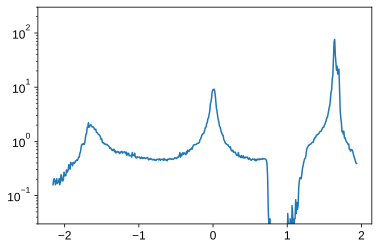

In [208]:
# base temp sweep
nT1615 = np.interp(tgate_corr, [V01615 - Vgatefull1615*6/4, V01615 + Vgatefull1615*6/4], [-6/4*nfull, 6/4*nfull])
plt.figure()
plt.semilogy(nT1615, R1615corr[0, :]/1000)
plt.ylim(0.03, 300)

# np.savetxt(BaseTfile + 'M20_0p83_RxxvsN.txt', np.vstack((nT1615, R1615corr[0, :])), fmt='%.8e', header='electron density (in 10^12 cm^-2) vs Rxx at base temp')

(0.025, 2.0)

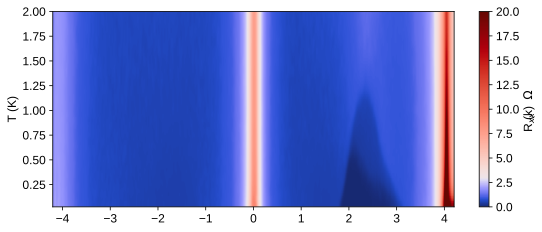

In [209]:
x = np.linspace(-4.2, 4.2, 1000)
y = np.linspace(0.025, 10, 600)
R1615Tint = R1615Tfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R1615Tint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vcenter=3, vmin=0, vmax=20), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.ylabel('T (K)')
plt.ylim((0.025, 2))
# plt.yticks([10, 20, 30, 40], [10, '', '', 40])
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)
# plt.savefig(figfile + 'M20_0p83_lowtemp.svg', dpi=300, bbox_inches='tight')

Find the electron-side Tc

In [210]:
nugate1615[364]

2.0632199085830365

(-0.1, 4.0, -0.1, 1.5)

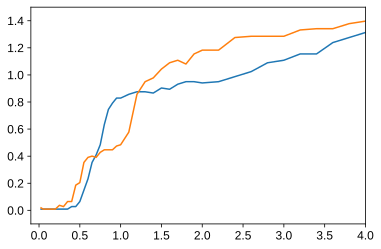

In [211]:
plt.figure()
plt.plot(temps, R1615corr[:, 364]/1000) # use this one (blue)
plt.plot(temps, R1615corr[:, 374]/1000) # interesting double-gap like behavior. Perhaps there's a higher-Tc SC gap here for a small area.
plt.axis((-0.1, 4, -0.1, 1.5))

In [212]:
def halfTc(temps, Rxx, n1, m1, n2, m2, pad=0.25):
    plt.plot(temps[n1:m1], Rxx[n1:m1])
    sl1, b1 = np.polyfit(temps[n1:m1], Rxx[n1:m1], 1)
    x1 = np.linspace(temps[n1] - pad, temps[m1] + pad, 3)
    plt.plot(x1, sl1*x1 + b1, 'k--', lw=0.7)

    plt.plot(temps[n2:m2], Rxx[n2:m2])
    sl2, b2 = np.polyfit(temps[n2:m2], Rxx[n2:m2], 1)
    x2 = np.linspace(temps[n2] - pad, temps[m2] + pad, 3)
    plt.plot(x2, sl2*x2 + b2, 'k--', lw=0.7)
    
    RN = (b1*sl2 - b2*sl1)/(sl2 - sl1)
    Tc = np.interp(RN/2, Rxx[n1:m1+5], temps[n1:m1+5])
    Tc10 = np.interp(RN*0.1, Rxx[n1-5:m1+5], temps[n1-5:m1+5])
    Tc90 = np.interp(RN*0.9, Rxx[n1:m1+10], temps[n1:m1+10])
    return Tc, Tc10, Tc90, RN/2


0.7020703980358636 0.510368211657509 0.8491515917069694 0.4128701001132403


(-0.1, 4.0, -0.1, 1.5)

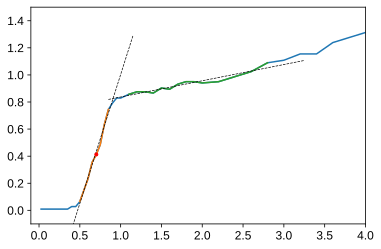

In [213]:
plt.figure()

xmin, xmax = -0.1, 4
ymin, ymax = -0.1, 1.5
# for i in range(9):
plt.plot(np.ma.masked_outside(temps, xmin, xmax), np.ma.masked_outside(R1615corr[:, 364]/1000, ymin, ymax))

Tc, Tc10, Tc90, Rhalf = halfTc(temps, R1615corr[:, 364]/1000, 10, 18, 21, 35)
plt.plot([Tc], [Rhalf], '.r')
print(Tc, Tc10, Tc90, Rhalf)

plt.axis((xmin, xmax, ymin, ymax))

In [214]:
print(Tc, Rhalf)

0.7020703980358636 0.4128701001132403


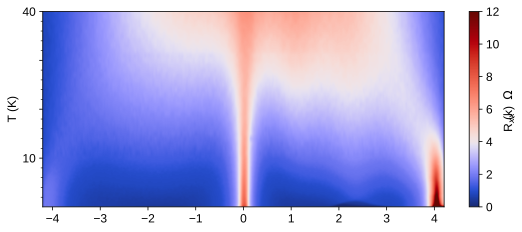

In [215]:

x = np.linspace(-4.2, 4.2, 1000)
y = np.linspace(0.025, 50, 600)
R1615Tint = R1615Tfunc(x, y).T

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(R1615Tint, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vmin=0, vcenter=4, vmax=12), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.ylabel('T (K)')
plt.ylim((0.025, 40))
plt.yticks([10, 20, 30, 40], [10, '', '', 40])
plt.minorticks_on()
plt.tick_params(axis='x', which='minor', bottom=False)
plt.savefig(figfile + 'M20_0p83_hightemp.svg', dpi=300, bbox_inches='tight')

In [216]:
R1615Tfunc = RectBivariateSpline(nugate1615, temps, R1615corr.T, kx=1, ky=1)

(0.025, 40.0)

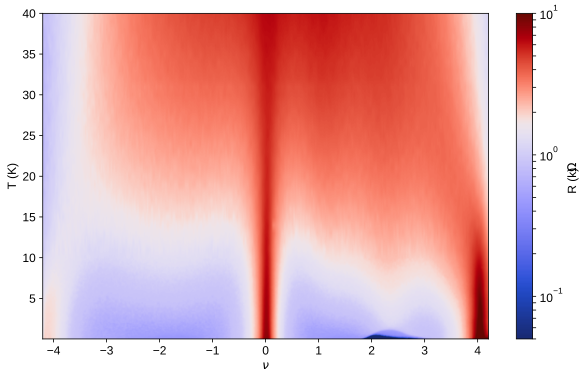

In [217]:
x = np.linspace(-4.2, 4.2, 1000)
y = np.linspace(0.025, 50, 1000)

# Still need to get the more exact full filling points for this set of data. Right now it's extrapolated from 0.88 degrees
plt.figure(figsize=(10, 6))  # the half filling doesn't line up as we expected, but it may be fine.
plt.pcolormesh(x, y, gaussian_filter(R1615Tfunc(x, y).T, (1, 1))/1000, norm=npd.DivLogNorm(0.66, vmin=50/1000, vmax=0.1e5/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext(), label='R (k$\Omega$)')
plt.ylabel('T (K)')
plt.xlabel(r'$\nu$')
plt.ylim((0.025, 40))

(0.025, 40.0)

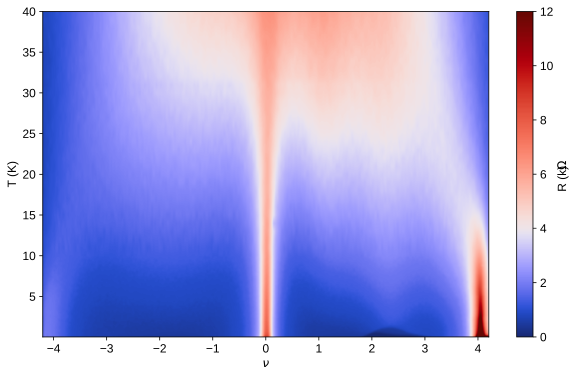

In [218]:
x = np.linspace(-4.2, 4.2, 1000)
y = np.linspace(0.025, 50, 1000)

plt.figure(figsize=(10, 6))  # the half filling doesn't line up as we expected, but it may be fine.
plt.pcolormesh(x, y, gaussian_filter(R1615Tfunc(x, y).T, (1.5, 1.5))/1000, norm=TwoSlopeNorm(vmin=0, vcenter=4, vmax=12), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R (k$\Omega$)')
plt.ylabel('T (K)')
plt.xlabel(r'$\nu$')
plt.ylim((0.025, 40))
# plt.savefig(figfile + 'M20_0p83_Tempgate_to40K_linear.svg', dpi=300, bbox_inches='tight')

Fit the electron-side peaks

In [219]:
window = 8
ind1, ind2 = npd.val_to_index([1.8, 2.5], nugate1615)
startT2, endT2 = 30, len(temps)-25
T2 = []
nu2peakind = []
nu2peak = []
nu2peakR = []
for i in range(startT2, endT2):
    try:
        # First the simple peak fit (use a gaussian filter to get rid of smaller bumps)
        R = gaussian_filter(R1615corr[i, ind1:ind2]/1000, 1)
        pind = int(find_peaks(R, prominence=0.02, distance=30)[0][0] + ind1)
        nu2peakind.append(pind)
        T2.append(temps[i])
        # Then do a quadratic fit and take the peak
        a, b, c = np.polyfit(nugate1615[pind-window:pind+window], gaussian_filter(R1615corr[i, pind-window:pind+window], 1), 2)
        xpeak = -b/(2*a)
        nu2peak.append(xpeak)
        nu2peakR.append(a*xpeak**2 + b*xpeak + c)
    except:
        continue

window = 9
ind1, ind2 = npd.val_to_index([0.7, 1.6], nugate1615)      
startT1, endT1 = 65, len(temps)
T1 = []
nu1peakind = []
nu1peak = []
nu1peakR = []
for i in range(startT1, endT1):
    try:
        R = gaussian_filter(R1615corr[i, ind1:ind2]/1000, 2.2)
        pind = int(find_peaks(R, prominence=0.01, distance=3)[0][0] + ind1)
        nu1peakind.append(pind)
        T1.append(temps[i])
        a, b, c = np.polyfit(nugate1615[pind-window:pind+window], gaussian_filter(R1615corr[i, pind-window:pind+window], 1.7), 2)
        xpeak = -b/(2*a)
        nu1peak.append(xpeak)
        nu1peakR.append(a*xpeak**2 + b*xpeak + c)
    except:
        continue

1.80 is not a value in the array
Plotted 1.80 instead
2.50 is not a value in the array
Plotted 2.51 instead
0.70 is not a value in the array
Plotted 0.70 instead
1.60 is not a value in the array
Plotted 1.60 instead


(-0.5, 3.5)

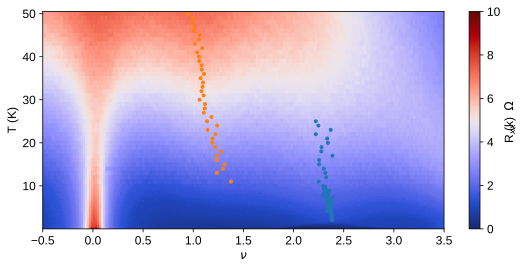

In [220]:
fig, ax = plt.subplots(1, 1, figsize=(9, 4))
norm = TwoSlopeNorm(5, 0, 10)
p = ax.pcolormesh(nugate1615, temps, R1615corr/1000, norm=norm, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
ax.set_ylabel('T (K)')
ax.set_xlabel('$\\nu$')
fig.colorbar(p, ax=ax, label='R$_{xx}$ (k$\Omega$)')
ax.plot(nu2peak, T2, '.')
ax.plot(nu1peak, T1, '.')
ax.set_xlim(-0.5, 3.5)

(0.4, 3.4, 0.0, 7.5)

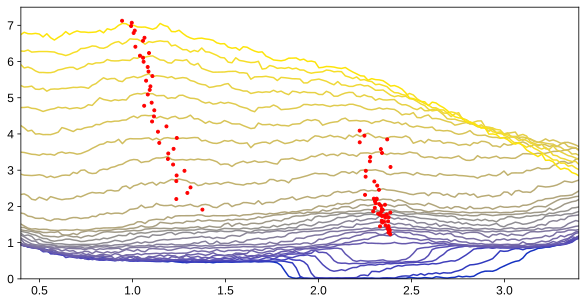

In [221]:
N = 28
colors = plt.get_cmap('cet_bjy')([i/(N-1) for i in range(N)])

fig, ax = plt.subplots(1, 1, figsize=(10, 5))
for i in range(N):
    indx = i*4
    ax.plot(nugate1615, gaussian_filter(R1615corr[indx, :]/1000, 0.5), color=colors[i], label='{:.2f} K'.format(temps[indx]))


ax.plot(nu1peak, np.array(nu1peakR)/1000, '.r')
ax.plot(nu2peak, np.array(nu2peakR)/1000, '.r')
ax.axis((0.4, 3.4, 0, 7.5))
# l = plt.legend()

In [222]:
# np.savetxt(Peakfile+'M20_0p83_nu1peaks.txt', np.vstack((T1, nu1peak, nu1peakR)).T, fmt='%.8e', header='columns: Temperatures (K), nu, Resistance (ohms)')
# np.savetxt(Peakfile+'M20_0p83_nu2peaks.txt', np.vstack((T2, nu2peak, nu2peakR)).T, fmt='%.8e', header='columns: Temperatures (K), nu, Resistance (ohms)')

d$\rho$/dT

In [223]:
nulin = np.linspace(-4.2, 4.2, 1001)
Tlin = np.linspace(0.025, 40, 300)
dT = Tlin[1] - Tlin[0]
R1615lin = R1615Tfunc(nulin, Tlin).T
R1615deriv = np.gradient(gaussian_filter(R1615lin, (2, 2)), dT, axis=0)
sqs = 30.55/10.01

1.50 is not a value in the array
Plotted 1.50 instead
1.80 is not a value in the array
Plotted 1.80 instead
xints: [679, 714]
15.00 is not a value in the array
Plotted 15.00 instead
38.00 is not a value in the array
Plotted 37.99 instead
yints: [112, 284]
-2.00 is not a value in the array
Plotted -2.00 instead
-1.60 is not a value in the array
Plotted -1.60 instead
xints: [262, 310]
15.00 is not a value in the array
Plotted 15.00 instead
38.00 is not a value in the array
Plotted 37.99 instead
yints: [112, 284]


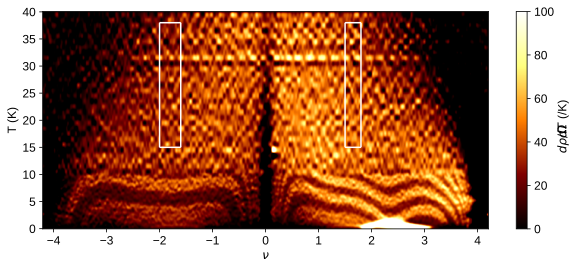

In [224]:
plt.figure(figsize=(10, 4))
plt.pcolormesh(nulin, Tlin, R1615deriv/sqs, cmap='afmhot', vmin=0, vmax=100, rasterized=True)
plt.colorbar(label='$d\\rho/dT$ ($\Omega$/K)')
plt.xlabel('$\\nu$')
plt.ylabel('T (K)')
plotbox(1.5, 1.8, 15, 38, nulin, Tlin, color='white')
plotbox(-2, -1.6, 15, 38, nulin, Tlin, color='white')

In [225]:
# electrons
np.average(R1615deriv[112:284, 679:714]/sqs), np.std(R1615deriv[112:284, 679:714]/sqs, ddof=1)

(40.85266088203636, 14.71106135107961)

In [226]:
# holes
np.average(R1615deriv[112:284, 262:310]/sqs), np.std(R1615deriv[112:284, 262:310]/sqs, ddof=1)

(31.16862955243002, 11.527745371542704)

Now the full-filling gaps

In [227]:
vfullnind1615 = npd.val_to_index([-3.82], tgate_corr)[0]
vfullpind1615 = npd.val_to_index([4.24], tgate_corr)[0]

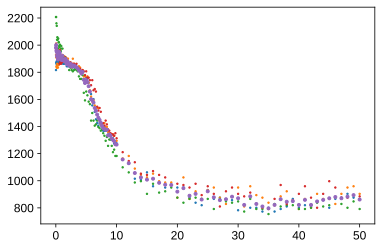

In [228]:
plt.figure()  # on the negative side, several looked close to the highest, so I averaged to get the purple circles
plt.plot(temps, R1615corr[:, vfullnind1615], '.', ms=3.)
plt.plot(temps, R1615corr[:, vfullnind1615+1], '.', ms=3.)
plt.plot(temps, R1615corr[:, vfullnind1615-1], '.', ms=3.)
plt.plot(temps, R1615corr[:, vfullnind1615+2], '.', ms=3.)

RxxTav = np.average(np.vstack((R1615corr[:, vfullnind1615], R1615corr[:, vfullnind1615+1], R1615corr[:, vfullnind1615+2], R1615corr[:, vfullnind1615-1])), axis=0)
plt.plot(temps, RxxTav, '.', ms=6.0)

In [229]:
n3 = -38
n3_b = -50
n4 = -8
n4_b = -13
sl1615_p, b1615_p = np.polyfit(1/temps[n3:n4], np.log(1/R1615corr[n3:n4, vfullpind1615]), 1)
sl1615_n, b1615_n = np.polyfit(1/temps[n3_b:n4_b], np.log(1/RxxTav[n3_b:n4_b]), 1)

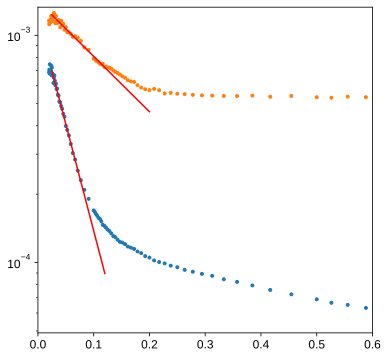

In [230]:
plt.figure(figsize=(6, 6))
plt.semilogy(np.ma.masked_outside(1/temps, 0, 0.6), 1/R1615corr[:, vfullpind1615], '.')
# plt.semilogy(1/temps[n3:n4], 1/R1615corr[n3:n4, vfullpind1615], '.g')
xp = np.linspace(0.025, 0.12, 100)
plt.semilogy(np.ma.masked_outside(xp, 0, 0.6), np.exp(sl1615_p*xp + b1615_p), 'r')

plt.semilogy(np.ma.masked_outside(1/temps, 0, 0.6), 1/RxxTav, '.')
# plt.semilogy(1/temps[n3_b:n4_b], 1/RxxTav[n3_b:n4_b], '.g')
xn = np.linspace(0.025, 0.2, 100)
plt.semilogy(xn, np.exp(sl1615_n*xn + b1615_n), 'r')
plt.axis([0,
 0.6,
 4.90397951400037e-05,
 0.0013299899123662676])
plt.savefig(figfile+'M20_0p83_gapfits.svg', dpi=300, bbox_inches='tight')

In [231]:
gap1615h = -sl1615_n*1.381e-23/1.602e-19*2*1000 # hole-side gap in meV
print(gap1615h)

0.9658470687528549


In [232]:
gap1615e = -sl1615_p*1.381e-23/1.602e-19*2*1000 # electron-side gap in meV
print(gap1615e)

3.7280185543648736


### Gaps for 0.83$^\circ$ -- hole side: 0.97 meV, electron side: 3.73 meV

## Near CNP for 0.83$^\circ$

In [233]:
nugate1615[262]

-0.008897917724733695

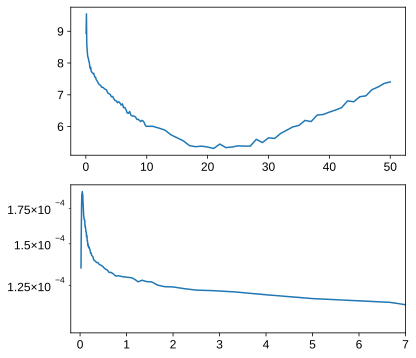

In [234]:
fig, ax = plt.subplots(2, 1, figsize=(6, 6))
ax[0].plot(temps, R1615corr[:, 262]/1000)
ax[1].plot(1/temps, 1/R1615corr[:, 262])
ax[1].set_yscale('log')
ax[1].set_xlim(-0.2, 7)
ax[1].yaxis.set_minor_locator(plt.MaxNLocator(4))

## Gaps for 0.79$^\circ$ 

In [235]:
dT2116_0 = qc.load_data('data/2019-12-02/#007_M20_14-15_865_21-16_830_T-gatesweep_basetemp_0.4nA_22-44-02') # which one is the actual one here?. It's has a slightly more limited gate range 'data/2019-12-02/#006_M20_14-15_865_21-16_830_T-gatesweep_basetemp_0.4nA_22-28-37'
dT2116_1 = qc.load_data('data/2019-12-02/#008_M20_14-15_865_21-16_830_T-gatesweep_0p5to1K_0.4nA_22-56-13')
dT2116_2 = qc.load_data('data/2019-12-03/#001_M20_14-15_865_21-16_830_T-gatesweep_1p05to1p4K_0.4nA_03-42-41')
dT2116_3 = qc.load_data('data/2019-12-03/#002_M20_14-15_865_21-16_830_T-gatesweep_1p45to2K_0.4nA_05-37-20')
dT2116_4 = qc.load_data('data/2019-12-03/#003_M20_14-15_865_21-16_830_T-gatesweep_2.1to10K_0.4nA_09-06-36')
dT2116_5 = qc.load_data('data/2019-12-30/#001_M20_15-14_865_21-16_830_gateTsweep10to30K_0p4nA_14-59-55')
dT2116_6 = qc.load_data('data/2019-12-30/#002_M20_15-14_865_21-16_830_gateTsweep31to50K_0p4nA_19-28-49')

In [236]:
gT2116 = dT2116_1.srframe_volt_p1_set[0, :]
T2116 = np.concatenate((dT2116_1.triton_pid_setpoint_set[:], dT2116_2.triton_pid_setpoint_set[:], dT2116_3.triton_pid_setpoint_set[:], dT2116_4.triton_pid_setpoint_set[:], dT2116_5.triton_pid_setpoint_set[1:], dT2116_6.triton_pid_setpoint_set[:]))
RxxT2116 = np.vstack((npd.Rxxfromdata(dT2116_1, 0.4e-9, instrument='lockin830'), npd.Rxxfromdata(dT2116_2, 0.4e-9, instrument='lockin830'), npd.Rxxfromdata(dT2116_3, 0.4e-9, instrument='lockin830'), npd.Rxxfromdata(dT2116_4, 0.4e-9, instrument='lockin830'), npd.Rxxfromdata(dT2116_5, 0.4e-9, instrument='lockin830')[1:, :], npd.Rxxfromdata(dT2116_6, 0.4e-9, instrument='lockin830')))

In [237]:
RxxT2116corr = np.copy(RxxT2116)
RxxT2116corr[RxxT2116 <= 0] = np.min(np.abs(RxxT2116[RxxT2116 > 0]))

In [238]:
np.min(np.abs(RxxT2116))

0.0

In [239]:
Vgatefull = 3.495599272009696
V0 = 0.26212986965138396 + 0.03
nfull = 1.4361284978831588
filling1621_T = np.interp(gT2116, [V0 - Vgatefull*6/4, V0 + Vgatefull*6/4], [-6, 6])

In [240]:
RxxT2116func = RectBivariateSpline(filling1621_T, T2116, RxxT2116corr.T, kx=1, ky=1)

(0.03, 300)

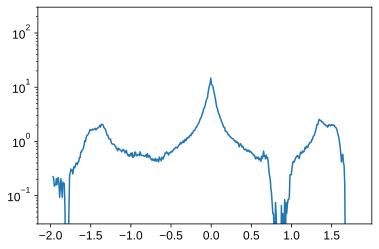

In [241]:
# base temp sweep
nT1621 = np.interp(gT2116, [V0 - Vgatefull*6/4, V0 + Vgatefull*6/4], [-6/4*nfull, 6/4*nfull])
plt.figure()
plt.semilogy(nT1621, RxxT2116corr[0, :]/1000)
plt.ylim(0.03, 300)

# np.savetxt(BaseTfile + 'M20_0p79_RxxvsN.txt', np.vstack((nT1621, RxxT2116corr[0, :])), fmt='%.8e', header='electron density (in 10^12 cm^-2) vs Rxx at base temp')

Low-temp SC

In [242]:
filling1621_T[370]

2.984175161301362

Normalizing temperature 2.0


Text(2.15, 0.1, 'SC')

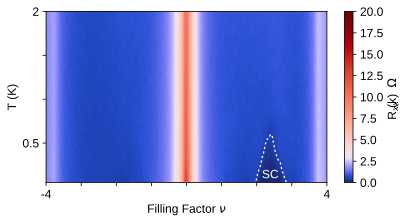

In [243]:
x = np.linspace(-5, 5, 1001)
y = np.linspace(0.05, 10, 801)
RxxT2116int = gaussian_filter(RxxT2116func(x, y).T, (0.8, 0.8))

plt.figure(figsize = (2*3.14961, 3.14961)) ### 40x80 mm
coff = TwoSlopeNorm(vcenter=3, vmin=0, vmax=20)
plt.pcolormesh(x, y, RxxT2116int/1000, norm=coff, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)#cc.cm.diverging_bwg_20_95_c41)
plt.ylabel('T (K)')
plt.xlabel('Filling Factor $\\nu$')#, fontname='Arial', fontsize=12)
plt.ylim((0.05, 2))
plt.colorbar(label='R$_{xx}$ (k$\Omega$)', ticks=np.arange(0, 22.5, 2.5))
plt.yticks([0.5, 1, 1.5, 2], [0.5, '', '', 2])
plt.xticks(np.arange(-4, 5), [-4] + ['']*7 + [4])
plt.xlim((-4, 4))
# plt.minorticks_on()
# plt.tick_params(axis='x', which='minor', bottom=False)


LW = 1.3
d = (1.7, 1.9)
# electron-side SC pocket###############################
scx, scy = SCdomepts(filling1621_T, RxxT2116corr, T2116, 39, 322, 370)
plt.plot(scx, gaussian_filter(scy, 1.3), linewidth=LW, color='white', linestyle='dashed', dashes=d)
##################################################

plt.text(2.15, 0.1, 'SC', color='w')
# plt.savefig(figfile + 'M20_0p79_to2Ktemp_linear.svg', dpi=300, bbox_inches='tight')

In [244]:
np.max(scy)

0.6

2.5035708730889645


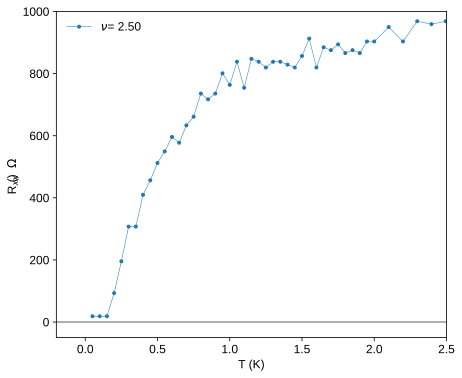

In [245]:
plt.figure(figsize=(7, 6))
gi = 349
print(filling1621_T[gi])

xmin, xmax = -0.2, 2.5
ymin, ymax = -50, 1000
plt.plot(np.ma.masked_outside(T2116, xmin, xmax), np.ma.masked_outside(RxxT2116corr[:, gi], ymin, ymax), '.-', lw=0.5, label='$\\nu$ = {:.2f}'.format(filling1621_T[gi]))
plt.xlim(xmin, xmax)
plt.ylim(ymin, ymax)
plt.hlines(0, xmin, xmax, color='gray', alpha=0.5)

plt.xlim(xmin, xmax)
plt.ylim(ymin, ymax)
plt.hlines(0, xmin, xmax, color='gray', alpha=0.5)
plt.xlabel('T (K)')
plt.ylabel('R$_{xx}$ ($\Omega$)')
plt.legend(frameon=False, loc='upper left')

# ax = plt.axes((0.53, 0.22, 0.33, 0.37))
# ax.plot(np.ma.masked_outside(T2116, xmin, xmax), np.ma.masked_outside(RxxT2116corr[:, gi], ymin, ymax), '.-', lw=0.5)
# ax.axis((-0.1, 0.4, -50, 130))

# plt.savefig(figfile + 'M20_0p79_SC_Tlines.svg', dpi=300, bbox_inches='tight')

Find the Tc from the normal resistance

In [246]:
filling1621_T[347]

2.4577990361163558

(-0.1, 4.0, -0.1, 1.5)

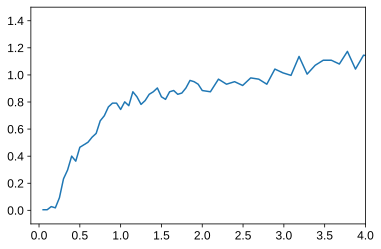

In [247]:
plt.figure()
plt.plot(T2116, RxxT2116corr[:, 347]/1000) # use this one (blue)
# plt.plot(T2116, RxxT2116corr[:, 351]/1000)
plt.axis((-0.1, 4, -0.1, 1.5))

In [248]:
def halfTc(temps, Rxx, n1, m1, n2, m2, pad=0.25):
    plt.plot(temps[n1:m1], Rxx[n1:m1])
    sl1, b1 = np.polyfit(temps[n1:m1], Rxx[n1:m1], 1)
    x1 = np.linspace(temps[n1] - pad, temps[m1] + pad, 3)
    plt.plot(x1, sl1*x1 + b1, 'k--', lw=0.7)

    plt.plot(temps[n2:m2], Rxx[n2:m2])
    sl2, b2 = np.polyfit(temps[n2:m2], Rxx[n2:m2], 1)
    x2 = np.linspace(temps[n2] - pad, temps[m2] + pad, 3)
    plt.plot(x2, sl2*x2 + b2, 'k--', lw=0.7)
    
    RN = (b1*sl2 - b2*sl1)/(sl2 - sl1)
    Tc = np.interp(RN/2, Rxx[n1:m1+5], temps[n1:m1+5])
    Tc10 = np.interp(RN*0.1, Rxx[n1-3:m1+5], temps[n1-3:m1+5])
    Tc90 = np.interp(RN*0.9, Rxx[n1:m1+10], temps[n1:m1+10])
    return Tc, Tc10, Tc90, RN/2


0.3819560239378324 0.23628783629891287 0.7462724910225779 0.3634996974462248


(-0.1, 4.0, -0.1, 1.5)

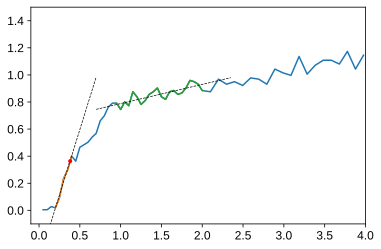

In [249]:
plt.figure()

xmin, xmax = -0.1, 4
ymin, ymax = -0.1, 1.5
# for i in range(9):
plt.plot(np.ma.masked_outside(T2116, xmin, xmax), np.ma.masked_outside(RxxT2116corr[:, 347]/1000, ymin, ymax))

Tc, Tc10, Tc90, Rhalf = halfTc(T2116, RxxT2116corr[:, 347]/1000, 3, 8, 18, 40)
plt.plot([Tc], [Rhalf], '.r')
print(Tc, Tc10, Tc90, Rhalf)

plt.axis((xmin, xmax, ymin, ymax))

In [250]:
print(Tc, Rhalf)

0.3819560239378324 0.3634996974462248


Text(0.5, 0, 'V$_{bg}$')

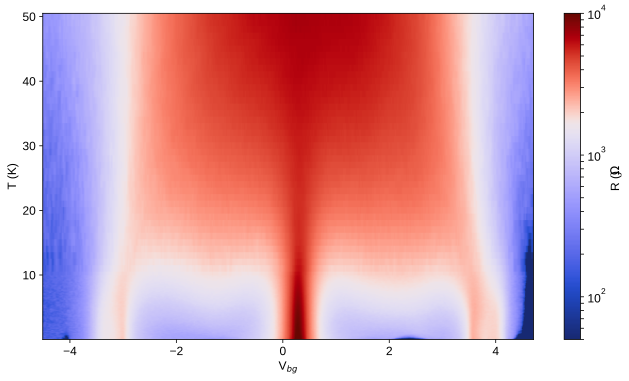

In [254]:
plt.figure(figsize=(11, 6))
plt.pcolormesh(gT2116, T2116, gaussian_filter(RxxT2116corr, (0.8, 0.8)), norm=npd.DivLogNorm(0.66, vmin=50, vmax=0.1e5), rasterized=True, cmap=cc.cm.diverging_bwr_20_95_c54)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext(), label='R ($\Omega$)')
plt.ylabel('T (K)')
plt.xlabel('V$_{bg}$')

(0.05, 40.0)

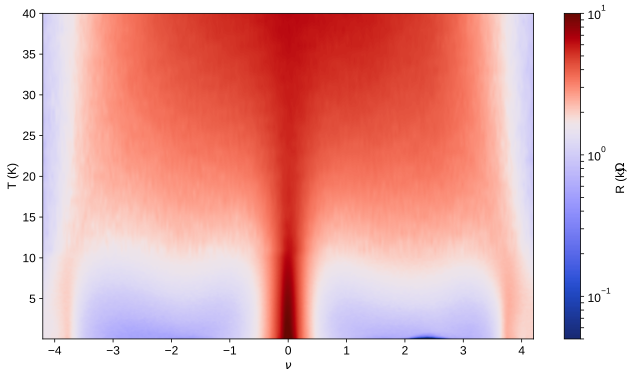

In [255]:
x = np.linspace(-4.2, 4.2, 1000)
y = np.linspace(0.05, 50, 1000)

plt.figure(figsize=(11, 6))
plt.pcolormesh(x, y, gaussian_filter(RxxT2116func(x, y).T, (1.5, 1.5))/1000, norm=npd.DivLogNorm(0.66, vmin=50/1000, vmax=0.1e5/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext(), label='R (k$\Omega$)')
plt.ylabel('T (K)')
plt.xlabel(r'$\nu$')
plt.ylim((0.05, 40))

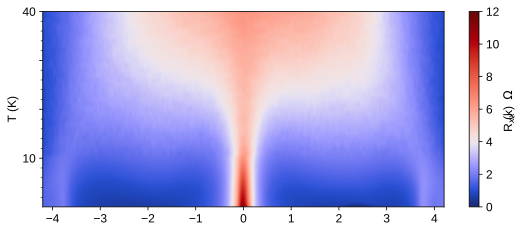

In [256]:
x = np.linspace(-4.2, 4.2, 1000)
y = np.linspace(0.05, 50, 600)

plt.figure(figsize=(9, 3.6))
plt.pcolormesh(x, y, gaussian_filter(RxxT2116func(x, y).T, (1.8, 1.8))/1000, norm=TwoSlopeNorm(vmin=0, vcenter=4, vmax=12), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.ylabel('T (K)')
# plt.xlabel(r'$\nu$')
plt.ylim((0.05, 40))
plt.yticks([10, 20, 30, 40], [10, '', '', 40])
plt.minorticks_on()
plt.tick_params(axis='x', which='minor', bottom=False)
# plt.savefig(figfile + 'M20_0p79_Tempgateto40K_linear.svg', dpi=300, bbox_inches='tight')

Fit the electron-side peaks, if we can find any

In [257]:
window = 8
ind1, ind2 = npd.val_to_index([1.8, 2.5], filling1621_T)
startT2, endT2 = 30, len(T2116)-25
T2 = []
nu2peakind = []
nu2peak = []
nu2peakR = []
for i in range(startT2, endT2):
    try:
        # First the simple peak fit (use a gaussian filter to get rid of smaller bumps)
        R = gaussian_filter(RxxT2116corr[i, ind1:ind2]/1000, 1)
        pind = int(find_peaks(R, prominence=0.02, distance=30)[0][0] + ind1)
        nu2peakind.append(pind)
        T2.append(T2116[i])
        # Then do a quadratic fit and take the peak
        a, b, c = np.polyfit(filling1621_T[pind-window:pind+window], gaussian_filter(RxxT2116corr[i, pind-window:pind+window], 1), 2)
        xpeak = -b/(2*a)
        nu2peak.append(xpeak)
        nu2peakR.append(a*xpeak**2 + b*xpeak + c)
    except:
        continue

window = 9
ind1, ind2 = npd.val_to_index([0.7, 1.6], filling1621_T)      
startT1, endT1 = 65, len(T2116)
T1 = []
nu1peakind = []
nu1peak = []
nu1peakR = []
for i in range(startT1, endT1):
    try:
        R = gaussian_filter(RxxT2116corr[i, ind1:ind2]/1000, 2.2)
        pind = int(find_peaks(R, prominence=0.01, distance=3)[0][0] + ind1)
        nu1peakind.append(pind)
        T1.append(T2116[i])
        a, b, c = np.polyfit(filling1621_T[pind-window:pind+window], gaussian_filter(RxxT2116corr[i, pind-window:pind+window], 1.7), 2)
        xpeak = -b/(2*a)
        nu1peak.append(xpeak)
        nu1peakR.append(a*xpeak**2 + b*xpeak + c)
    except:
        continue

1.80 is not a value in the array
Plotted 1.79 instead
2.50 is not a value in the array
Plotted 2.50 instead
0.70 is not a value in the array
Plotted 0.70 instead
1.60 is not a value in the array
Plotted 1.61 instead


(-0.5, 3.5)

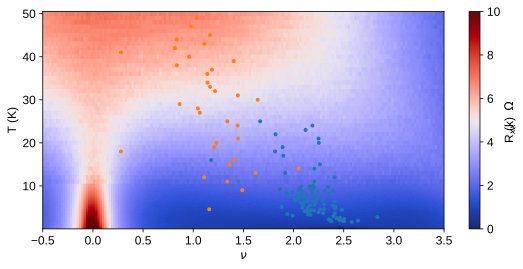

In [258]:
fig, ax = plt.subplots(1, 1, figsize=(9, 4))
norm = TwoSlopeNorm(5, 0, 10)
p = ax.pcolormesh(filling1621_T, T2116, RxxT2116corr/1000, norm=norm, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
ax.set_ylabel('T (K)')
ax.set_xlabel('$\\nu$')
fig.colorbar(p, ax=ax, label='R$_{xx}$ (k$\Omega$)')
ax.plot(nu2peak, T2, '.')
ax.plot(nu1peak, T1, '.')
ax.set_xlim(-0.5, 3.5)

(0.4, 3.4, 0.0, 7.5)

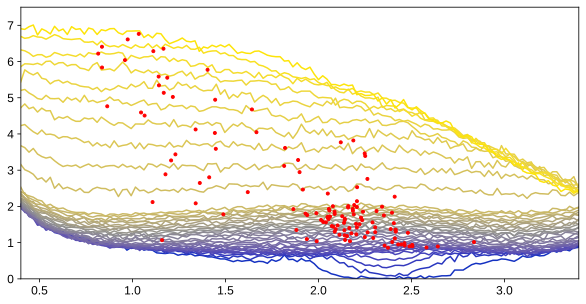

In [259]:
N = 41
colors = plt.get_cmap('cet_bjy')([i/(N-1) for i in range(N)])

fig, ax = plt.subplots(1, 1, figsize=(10, 5))
for i in range(N):
    indx = i*4
    ax.plot(filling1621_T, gaussian_filter(RxxT2116corr[indx, :]/1000, 0.2), color=colors[i], label='{:.2f} K'.format(T2116[indx]))


ax.plot(nu1peak, np.array(nu1peakR)/1000, '.r')
ax.plot(nu2peak, np.array(nu2peakR)/1000, '.r')
ax.axis((0.4, 3.4, 0, 7.5))
# l = plt.legend()

Nothing reasonable here for the peaks.

d$\rho$/dT

In [260]:
nulin = np.linspace(-4.2, 4.2, 1001)
Tlin = np.linspace(0.025, 40, 300)
dT = Tlin[1] - Tlin[0]
R2116lin = RxxT2116func(nulin, Tlin).T
R2116deriv = np.gradient(gaussian_filter(R2116lin, (2, 2)), dT, axis=0)
sqs = 30.55/10.01

1.50 is not a value in the array
Plotted 1.50 instead
1.80 is not a value in the array
Plotted 1.80 instead
xints: [679, 714]
15.00 is not a value in the array
Plotted 15.00 instead
38.00 is not a value in the array
Plotted 37.99 instead
yints: [112, 284]
-2.00 is not a value in the array
Plotted -2.00 instead
-1.60 is not a value in the array
Plotted -1.60 instead
xints: [262, 310]
15.00 is not a value in the array
Plotted 15.00 instead
38.00 is not a value in the array
Plotted 37.99 instead
yints: [112, 284]


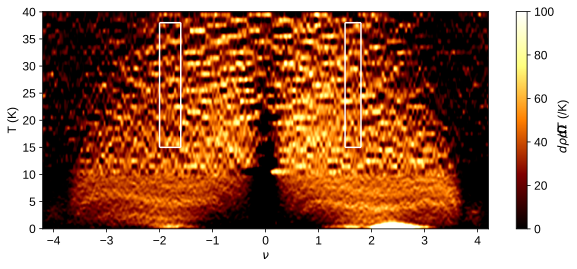

In [261]:
plt.figure(figsize=(10, 4))
plt.pcolormesh(nulin, Tlin, R2116deriv/sqs, cmap='afmhot', vmin=0, vmax=100, rasterized=True)
plt.colorbar(label='$d\\rho/dT$ ($\Omega$/K)')
plt.xlabel('$\\nu$')
plt.ylabel('T (K)')
plotbox(1.5, 1.8, 15, 38, nulin, Tlin, color='white')
plotbox(-2, -1.6, 15, 38, nulin, Tlin, color='white')

In [262]:
# electrons
np.average(R2116deriv[112:284, 679:714]/sqs), np.std(R2116deriv[112:284, 679:714]/sqs, ddof=1)

(39.03323596457267, 16.876058830146054)

In [263]:
# holes
np.average(R2116deriv[112:284, 262:310]/sqs), np.std(R2116deriv[112:284, 262:310]/sqs, ddof=1)

(31.993626050805307, 18.330292780961454)

3.00 is not a value in the array
Plotted 2.99 instead
5.00 is not a value in the array
Plotted 4.96 instead
7.00 is not a value in the array
Plotted 7.04 instead


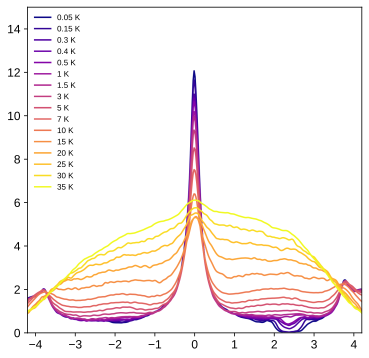

In [264]:
fig1 = plt.figure(figsize=(6, 6), facecolor= 'white', dpi=300)
ax1 = fig1.add_subplot(111)

Tselect = [0.05, 0.15, 0.3, 0.4, 0.5, 1, 1.5, 3, 5, 7, 10, 15, 20, 25, 30, 35]
line_selection = npd.val_to_index(Tselect, T2116)

for n, i in enumerate(line_selection):
    Temp = Tselect[n]
    label1=f"{Temp} K"
    ax1.plot(filling1621_T, gaussian_filter(RxxT2116corr[i,:], 1.5)/1000, label=label1, rasterized=True)

plt.xlim(-4.2, 4.2)
plt.ylim(0, 15)


colormap = plt.cm.plasma #nipy_spectral, Set1,Paired   
colors = [colormap(i) for i in np.linspace(0, 1,len(ax1.lines))]
for i,j in enumerate(ax1.lines):
    j.set_color(colors[i])

# need to add legend 
ax1.legend(loc=2, prop={'size': 8}, frameon=False)
# plt.savefig(figfile + 'M20_0p79_Tempgatepickedplots.svg', dpi=300, bbox_inches='tight')

In [265]:
npd.val_to_index([-4, 4], filling1621_T)

-4.00 is not a value in the array
Plotted -4.00 instead
4.00 is not a value in the array
Plotted 3.99 instead


[65, 414]

In [266]:
filling1621_T[414-6]

3.853840063780943

(-0.03583884381503566,
 0.4175395949856926,
 0.000458583248847538,
 0.0010780210457807565)

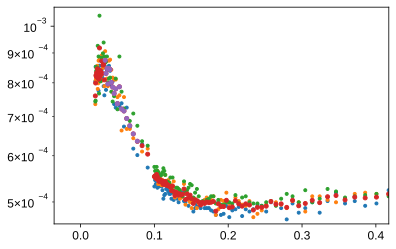

In [267]:
plt.figure()  # doesn't ever really follow a strongly linear trend
plt.semilogy(1/T2116, 1/RxxT2116corr[:, 414], '.')
plt.semilogy(1/T2116, 1/RxxT2116corr[:, 414+1], '.')
plt.semilogy(1/T2116, 1/RxxT2116corr[:, 414+2], '.')
# try averaging some
RxxT2116corrav = np.average(RxxT2116corr[:, 414:414+3], axis=1)
plt.semilogy(1/T2116, 1/RxxT2116corrav, '.', ms=8)
n1 = -38
n2 = -20
plt.semilogy(1/T2116[n1:n2], 1/RxxT2116corrav[n1:n2], '.', ms=8)
plt.axis((-0.03583884381503566,
 0.4175395949856926,
 0.000458583248847538,
 0.0010780210457807565))

(-0.03583884381503566,
 0.4175395949856926,
 0.000458583248847538,
 0.0010780210457807565)

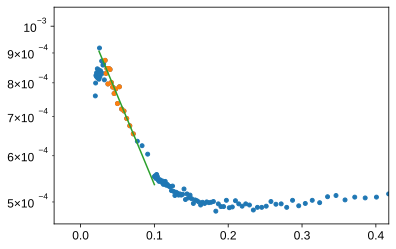

In [268]:
plt.figure()
plt.semilogy(1/T2116, 1/RxxT2116corrav, '.', ms=8)
n1 = -37
n2 = -20
plt.semilogy(1/T2116[n1:n2], 1/RxxT2116corrav[n1:n2], '.', ms=8)
sle2116, be2116 = np.polyfit(1/T2116[n1:n2], np.log(1/RxxT2116corrav[n1:n2]), 1)
x1 = np.linspace(0.025, 0.1, 100)
plt.semilogy(x1, np.exp(sle2116*x1 + be2116))
plt.axis((-0.03583884381503566,
 0.4175395949856926,
 0.000458583248847538,
 0.0010780210457807565))

In [269]:
-sle2116*1.381e-23/1.602e-19*2*1000 # electron-side gap in meV

1.2085121227056153

(0.00476421045785691,
 0.744463417013528,
 0.0005446578727885406,
 0.0012615021428894532)

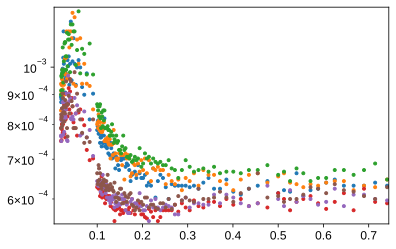

In [270]:
plt.figure()
# two main groups
plt.semilogy(1/T2116, 1/RxxT2116corr[:, 65-7], '.')
plt.semilogy(1/T2116, 1/RxxT2116corr[:, 65-8], '.')
plt.semilogy(1/T2116, 1/RxxT2116corr[:, 65-9], '.')

plt.semilogy(1/T2116, 1/RxxT2116corr[:, 65], '.')
plt.semilogy(1/T2116, 1/RxxT2116corr[:, 65-1], '.')
plt.semilogy(1/T2116, 1/RxxT2116corr[:, 65-2], '.')

# try some averaging
R2116_av1 = np.average(RxxT2116corr[:, 63:66], axis=1)
R2116_av2 = np.average(RxxT2116corr[:, 56:59], axis=1)
# plt.plot(1/T2116, 1/RxxT2116corr[:, 65+1], '.')
# plt.plot(1/T2116, 1/RxxT2116corr[:, 65+2], '.')
# plt.plot(1/T2116, 1/RxxT2116corr[:, 65+3], '.')
plt.axis((0.00476421045785691,
 0.744463417013528,
 0.0005446578727885406,
 0.0012615021428894532))

(-0.011272938978603764,
 0.2722477941676723,
 0.0005238227893396819,
 0.0012884271677831862)

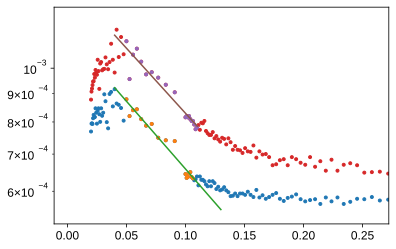

In [271]:
plt.figure()
n1_a = -47
n2_a = -30
plt.semilogy(1/T2116, 1/R2116_av1, '.')
plt.semilogy(1/T2116[n1_a:n2_a], 1/R2116_av1[n1_a:n2_a], '.')

slh2116_1, bh2116_1 = np.polyfit(1/T2116[n1_a:n2_a], np.log(1/R2116_av1[n1_a:n2_a]), 1)
x1 = np.linspace(0.04, 0.13, 100)
plt.semilogy(x1, np.exp(slh2116_1*x1 + bh2116_1))

n1_b = -50
n2_b = -30
plt.semilogy(1/T2116, 1/R2116_av2, '.')
plt.semilogy(1/T2116[n1_b:n2_b], 1/R2116_av2[n1_b:n2_b], '.')
slh2116_2, bh2116_2 = np.polyfit(1/T2116[n1_b:n2_b], np.log(1/R2116_av2[n1_b:n2_b]), 1)
x2 = np.linspace(0.04, 0.11, 100)
plt.semilogy(x2, np.exp(slh2116_2*x2 + bh2116_2))
plt.axis((-0.011272938978603764,
 0.2722477941676723,
 0.0005238227893396819,
 0.0012884271677831862))

In [272]:
-slh2116_1*1.381e-23/1.602e-19*2*1000  # hole-side gap.

0.9696617398653419

In [273]:
-slh2116_2*1.381e-23/1.602e-19*2*1000  # hole-side gap try 2, lower conductance

0.9313153459496942

In [274]:
T2116[:-10]

array([ 0.05   ,  0.1    ,  0.15   ,  0.2    ,  0.25   ,  0.3    ,
        0.35   ,  0.4    ,  0.45   ,  0.5    ,  0.55   ,  0.6    ,
        0.65   ,  0.7    ,  0.75   ,  0.8    ,  0.85   ,  0.9    ,
        0.95   ,  1.     ,  1.05   ,  1.1    ,  1.15   ,  1.2    ,
        1.25   ,  1.3    ,  1.35   ,  1.4    ,  1.45   ,  1.5    ,
        1.55   ,  1.6    ,  1.65   ,  1.7    ,  1.75   ,  1.8    ,
        1.85   ,  1.9    ,  1.95   ,  2.     ,  2.1    ,  2.19875,
        2.2975 ,  2.39625,  2.495  ,  2.59375,  2.6925 ,  2.79125,
        2.89   ,  2.98875,  3.0875 ,  3.18625,  3.285  ,  3.38375,
        3.4825 ,  3.58125,  3.68   ,  3.77875,  3.8775 ,  3.97625,
        4.075  ,  4.17375,  4.2725 ,  4.37125,  4.47   ,  4.56875,
        4.6675 ,  4.76625,  4.865  ,  4.96375,  5.0625 ,  5.16125,
        5.26   ,  5.35875,  5.4575 ,  5.55625,  5.655  ,  5.75375,
        5.8525 ,  5.95125,  6.05   ,  6.14875,  6.2475 ,  6.34625,
        6.445  ,  6.54375,  6.6425 ,  6.74125,  6.84   ,  6.93

In [275]:
T2116[19]

1.0

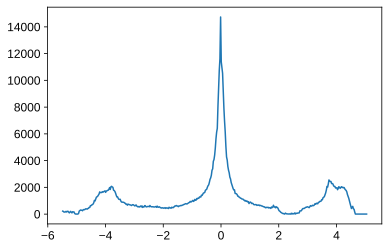

In [276]:
plt.figure()
plt.plot(filling1621_T, RxxT2116corr[0, :])

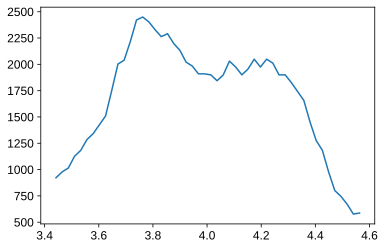

In [277]:
plt.figure()
plt.plot(filling1621_T[390:440], RxxT2116corr[5, 390:440])

In [278]:
npd.val_to_index([-4, 4], filling1621_T)

-4.00 is not a value in the array
Plotted -4.00 instead
4.00 is not a value in the array
Plotted 3.99 instead


[65, 414]

4.242900678048123
3.762296389835722


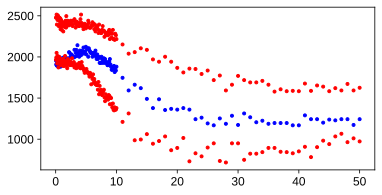

In [279]:
plt.figure(figsize=(6, 3))

# plt.plot(T2116[:], RxxT2116corr[:, 65], '.k', label='$\\nu = -4')  # a single value here looks better than the average
plt.plot(T2116[:], RxxT2116corr[:, 414], '.b', label='$\\nu = +4')
n = -36
plt.plot(T2116[:], RxxT2116corr[:, n], '.r', label='$\\nu = +4')
print(filling1621_T[n])

n = -57
plt.plot(T2116[:], RxxT2116corr[:, n], '.r', label='$\\nu = +4')
print(filling1621_T[n])

# plt.plot(1/T2116[:-10], R2116_av1[:-10]/1000, '.')
# plt.plot(1/T2116[:-10], R2116_av2[:-10]/1000, '.')
# plt.xlim(-.5, 4)
# plt.ylim(1, 2.5)
# plt.savefig(figfile + 'M20_0p79_RvsinvT.svg', dpi=300, bbox_inches='tight')

Combine 0.87 and 0.79 datasets here

-4.03 is not a value in the array
Plotted -4.04 instead


(1.0, 2.5)

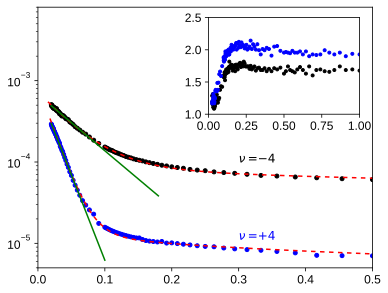

In [280]:
n1 = -39
n1_b = -35
n2 = None
vfullnind = npd.val_to_index([-4.03], tgate_corr)[0]
sl, b = np.polyfit(1/temps[n1:n2], np.log(1/R1514corr[n1:n2, vfullnind]), 1)

vfullpind = npd.val_to_index([4.56], tgate_corr)[0]
sl2, b2 = np.polyfit(1/temps[n1_b:n2], np.log(1/R1514corr[n1_b:n2, vfullpind]), 1)

# some parameter guesses. Really just the resulting fits that we should get below
ss1=6.1810e-4
d1=43.7499 # 3.76 meV
ss2=1.3035e-4
tt0=0.7555

ss1p=8.7161e-04
d1p=108.970164 # 9.4 meV
ss2p=2.2500e-05
tt0p=2.72898093

sigma_datan = 1/R1514corr[:-10, vfullnind]
sigma_datap = 1/R1514corr[20:-10, vfullpind]
temp1 = temps[20:-10]

resultn = sigmamodel.fit(sigma_datan, x=1/temps[:-10], sigma1=ss1, sigma2=ss2, delta=33, t0=0.1)
resultp = sigmamodel.fit(sigma_datap, x=1/temp1, sigma1=ss1p, sigma2=ss2p, delta=90, t0=0.3)

plt.figure(figsize=(6, 4.8))

x1 = np.linspace(0.015, 0.5, 300)
x2 = np.linspace(0.018, 0.5, 300)

plt.semilogy(1/temps[30:], 1/R1514corr[30:, vfullnind], 'ko', ms=4)
plt.semilogy(x1, fit_function(x1, ss1,ss2,d1,tt0), 'r--', label='Arrhenius + VRH', dashes=(3, 3))

plt.semilogy(1/temps[30:], 1/R1514corr[30:, vfullpind], 'bo', ms=4)
plt.semilogy(x2, fit_function(x2, ss1p,ss2p,d1p,tt0p), 'r--', dashes=(3, 3))
# plt.legend(loc='best')

#include linear fits too
x1 = np.linspace(0.02, 0.18, 100)
x2 = np.linspace(0.02, 0.1, 100)
plt.semilogy(x1, np.exp(sl*x1 + b), 'g', label='Arrhenius')
plt.semilogy(x2, np.exp(sl2*x2 + b2), 'g')
# plt.legend()
plt.xlim(0, 0.5)
plt.ylim(5e-6, 8e-3)
plt.text(0.3, 0.98e-4, '$\\nu=-4$')
plt.text(0.3, 1.1e-5, '$\\nu=+4$', color='b')

ax = plt.axes([0.52, 0.57, 0.35, 0.28])
ax.plot(1/T2116[19:-10], RxxT2116corr[19:-10, 65]/1000, '.k', label='$\\nu = -4')  # a single value here looks better than the average
ax.plot(1/T2116[19:-10], RxxT2116corr[19:-10, 414]/1000, '.b', label='$\\nu = +4')
# plt.plot(1/T2116[:-10], R2116_av1[:-10]/1000, '.')
# plt.plot(1/T2116[:-10], R2116_av2[:-10]/1000, '.')
plt.xlim(0, 1)
plt.ylim(1, 2.5)

# plt.savefig(figfile + 'M20_0p87_0p79_fullfillinggapfits.svg', dpi=300, bbox_inches='tight')

#just make sure to point out that the inset is in terms of R vs 1/T

In [281]:
1/T2116[39]

0.5

-4.03 is not a value in the array
Plotted -4.04 instead


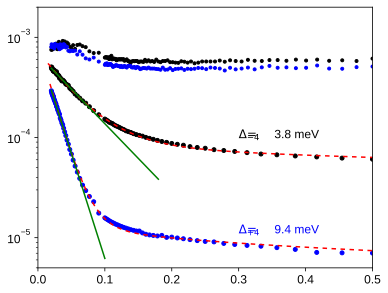

In [283]:
n1 = -39
n1_b = -35
n2 = None
vfullnind = npd.val_to_index([-4.03], tgate_corr)[0]
sl, b = np.polyfit(1/temps[n1:n2], np.log(1/R1514corr[n1:n2, vfullnind]), 1)

vfullpind = npd.val_to_index([4.56], tgate_corr)[0]
sl2, b2 = np.polyfit(1/temps[n1_b:n2], np.log(1/R1514corr[n1_b:n2, vfullpind]), 1)

# some parameter guesses. Really just the resulting fits that we should get below
ss1=6.1810e-4
d1=43.7499 # 3.76 meV
ss2=1.3035e-4
tt0=0.7555

ss1p=8.7161e-04
d1p=108.970164 # 9.4 meV
ss2p=2.2500e-05
tt0p=2.72898093

sigma_datan = 1/R1514corr[:-10, vfullnind]
sigma_datap = 1/R1514corr[20:-10, vfullpind]
temp1 = temps[20:-10]

resultn = sigmamodel.fit(sigma_datan, x=1/temps[:-10], sigma1=ss1, sigma2=ss2, delta=33, t0=0.1)
resultp = sigmamodel.fit(sigma_datap, x=1/temp1, sigma1=ss1p, sigma2=ss2p, delta=90, t0=0.3)

plt.figure(figsize=(6, 4.8))

x1 = np.linspace(0.015, 0.5, 300)
x2 = np.linspace(0.018, 0.5, 300)

plt.semilogy(1/temps[30:], 1/R1514corr[30:, vfullnind], 'ko', ms=4)
plt.semilogy(x1, fit_function(x1, ss1,ss2,d1,tt0), 'r--', label='Arrhenius + VRH', dashes=(3, 3))

plt.semilogy(1/temps[30:], 1/R1514corr[30:, vfullpind], 'bo', ms=4)
plt.semilogy(x2, fit_function(x2, ss1p,ss2p,d1p,tt0p), 'r--', dashes=(3, 3))
# plt.legend(loc='best')

#include linear fits too
x1 = np.linspace(0.02, 0.18, 100)
x2 = np.linspace(0.02, 0.1, 100)
plt.semilogy(x1, np.exp(sl*x1 + b), 'g', label='Arrhenius')
plt.semilogy(x2, np.exp(sl2*x2 + b2), 'g')
# plt.legend()
plt.xlim(0, 0.5)
plt.ylim(5e-6, 2e-3)

deltan4 = 43.7499165*1.381e-23/1.602e-19*1000
deltap4 = 108.970167*1.381e-23/1.602e-19*1000
plt.text(0.3, 0.98e-4, '$\Delta_{-4}=$'+'{:.1f} meV'.format(deltan4))
plt.text(0.3, 1.1e-5, '$\Delta_{+4}=$'+'{:.1f} meV'.format(deltap4), color='b')

plt.semilogy(1/T2116[39:], 1/RxxT2116corr[39:, 65], '.k', label='$\\nu = -4$')  # a single value here looks better than the average
plt.semilogy(1/T2116[39:], 1/RxxT2116corr[39:, 414], '.b', label='$\\nu = +4$')
# plt.plot(1/T2116[:-10], R2116_av1[:-10]/1000, '.')
# plt.plot(1/T2116[:-10], R2116_av2[:-10]/1000, '.')
# plt.xlim(0, 1)
# plt.ylim(1, 2.5)

plt.savefig(figfile + 'M20_0p87_0p79_fullfillinggapfits.svg', dpi=300, bbox_inches='tight')

# just make sure to point out that the inset is in terms of R vs 1/T

## 0.79 degrees near CNP

In [284]:
filling1621_T[239]

-0.013880160404554864

(-0.2, 7.5)

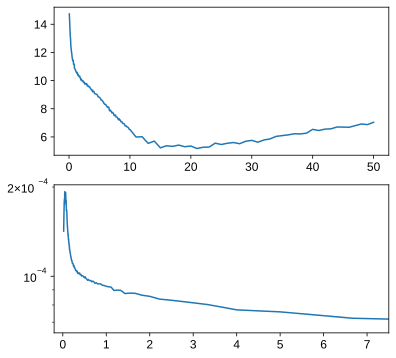

In [285]:
fig, ax = plt.subplots(2, 1, figsize=(6, 6))
ax[0].plot(T2116, RxxT2116corr[:, 239]/1000)
ax[1].semilogy(1/T2116, 1/RxxT2116corr[:, 239])
# ax[1].set_yscale('log')
ax[1].set_xlim(-0.2, 7.5)
# ax[1].yaxis.set_minor_locator(plt.MaxNLocator(6))

## M12: 0.98$^\circ$ or 1.04$^\circ$

### Gaps for 1.04 or 0.98$^\circ$ M12 approx 1/2 gaps

The issue is discussed a bit more below

In [286]:
M12T_0 = qc.load_data('data/2019-11-25/#002_baseTempgatesweep_M12_20-22_lockin865_M10_29-2_lockin830_17-55-55') #base temp, cables unplugged
M12T_1 = qc.load_data('data/2019-11-25/#003_2d_gate_Tempsweep_base-1K_M12_20-22_lockin865_M10_29-2_lockin830_18-12-32')
M12T_2 = qc.load_data('data/2019-11-25/#004_2d_gate_Tempsweep_1.1-1.4K_M12_20-22_lockin865_M10_29-2_lockin830_22-46-54')
M12T_3 = qc.load_data('data/2019-11-25/#005_2d_gate_Tempsweep_1.5-2K_M12_20-22_lockin865_M10_26-25_lockin830_23-39-49')
M12T_4 = qc.load_data('data/2019-11-26/#001_2d_gate_Tempsweep_2-5K_M12_20-22_lockin865_M10_29-2_lockin830_00-59-35')
M12T_5 = qc.load_data('data/2019-11-26/#002_2d_gate_Tempsweep_5-10K_M12_20-22_lockin865_M10_29-2_lockin830_07-49-36')

In [287]:
gateT2022 = M12T_0.srframe_volt_p1_set[:]
T2022 = np.concatenate(([0.025], M12T_1.triton_pid_setpoint_set[:], M12T_2.triton_pid_setpoint_set[:], M12T_3.triton_pid_setpoint_set[:-1], M12T_4.triton_pid_setpoint_set[:], M12T_5.triton_pid_setpoint_set[:]))
Rxx2022T = np.vstack((npd.Rxxfromdata(M12T_0, 0.2e-9, instrument='lockin865'), npd.Rxxfromdata(M12T_1, 0.2e-9, instrument='lockin865'), npd.Rxxfromdata(M12T_2, 0.2e-9, instrument='lockin865'), npd.Rxxfromdata(M12T_3, 0.2e-9, instrument='lockin865')[:-1, :], npd.Rxxfromdata(M12T_4, 0.2e-9, instrument='lockin865'), npd.Rxxfromdata(M12T_5, 0.2e-9, instrument='lockin865')))

Rxx2022Tcorr = np.copy(Rxx2022T)
Rxx2022Tcorr[Rxx2022T <= 0] = np.min(np.abs(Rxx2022T))

In [288]:
Vgfull2022 = 6.38454649743731
V0ind = np.argmax(Rxx2022Tcorr[40, 200:220])
V0 = gateT2022[200 + V0ind]
filling2022T = np.interp(gateT2022, [V0 - Vgfull2022*7/4, V0 + Vgfull2022*7/4], [-7, 7])

In [289]:
R2022Tfunc = RectBivariateSpline(filling2022T, T2022, Rxx2022Tcorr.T, kx=1, ky=1)

Text(0.5, 0, '$\\nu$')

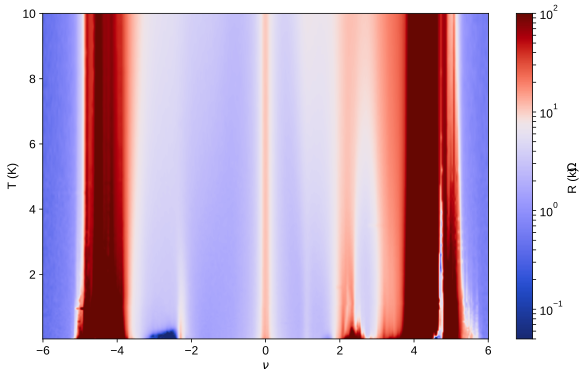

In [290]:
x = np.linspace(-6, 6, 1000)
y = np.linspace(0.025, 10, 1000)

plt.figure(figsize=(10, 6))  # the raw X data doesn't look any better
plt.pcolormesh(x, y, gaussian_filter(R2022Tfunc(x, y).T, (1.2, 1.2))/1000, norm=npd.DivLogNorm(0.66, vmin=50/1000, vmax=1e5/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext(), label='R (k$\Omega$)')
plt.ylabel('T (K)')
plt.xlabel(r'$\nu$')

Here is where the angle issue is more evident. It seems that we could get a slightly better fit here if we fit it with 1.04 degrees. The positive half, negative half, and postive quarter would line up better.

In [291]:
multfactor = 1.13
Vgfull2022 = 6.38454649743731
V0ind = np.argmax(Rxx2022Tcorr[40, 200:220])
V0 = gateT2022[200 + V0ind]
filling2022T_2 = np.interp(gateT2022, [V0 - Vgfull2022*multfactor*7/4, V0 + Vgfull2022*multfactor*7/4], [-7, 7])
R2022Tfunc_2 = RectBivariateSpline(filling2022T_2, T2022, Rxx2022Tcorr.T, kx=1, ky=1)

Text(0.5, 0, '$\\nu$')

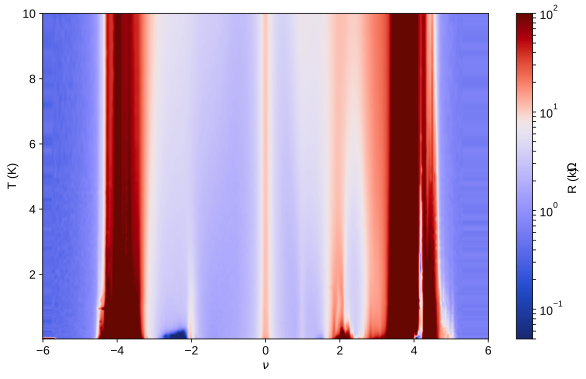

In [292]:
x = np.linspace(-6, 6, 1000)
y = np.linspace(0.025, 10, 1000)

plt.figure(figsize=(10, 6))  # the raw X data doesn't look any better
plt.pcolormesh(x, y, gaussian_filter(R2022Tfunc_2(x, y).T, (1.2, 1.2))/1000, norm=npd.DivLogNorm(0.66, vmin=50/1000, vmax=1e5/1000), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext(), label='R (k$\Omega$)')
plt.ylabel('T (K)')
plt.xlabel(r'$\nu$')

Now to 2 K

First assuming 0.98 degrees

Text(0.5, 0, '$\\nu$')

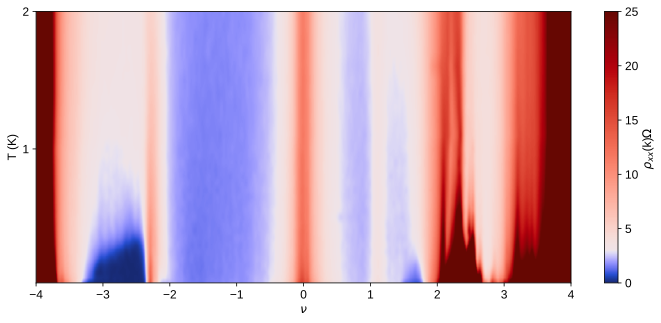

In [293]:
x = np.linspace(-6, 6, 1000)
y = np.linspace(0.025, 10, 1000)

fig, ax = plt.subplots(figsize=(12, 5))
p = ax.pcolormesh(x, y, gaussian_filter(R2022Tfunc(x, y).T, (1.2, 1.2))/1000, norm=TwoSlopeNorm(vmin=0, vcenter=3, vmax=25), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
# ax.set_aspect(0.5)
plt.colorbar(p, ax=ax, label=r'$\rho$' + '$_{xx}$ (k$\Omega$)')
plt.ylabel('T (K)')
plt.xlim((-4, 4))
plt.ylim((0.025, 2))
plt.yticks(range(1, 3))
plt.xlabel(r'$\nu$')
# plt.savefig(figfile + 'M12_0p98_tempgateto2K_log.svg', dpi=300, bbox_inches='tight')

Say the angle determination used was slightly off, and we actually aim to line up the 1/4 and 1/2 filling with the peaks, as they are in the 2D gate-temperature plots. Then we get

In [294]:
multfactor = 1.13
Vgfull2022 = 6.38454649743731
V0ind = np.argmax(Rxx2022Tcorr[40, 200:220])
V0 = gateT2022[200 + V0ind]
filling2022T_2 = np.interp(gateT2022, [V0 - Vgfull2022*multfactor*7/4, V0 + Vgfull2022*multfactor*7/4], [-7, 7])
R2022Tfunc_2 = RectBivariateSpline(filling2022T_2, T2022, Rxx2022Tcorr.T, kx=1, ky=1)
nfull = 2.5160934997792905

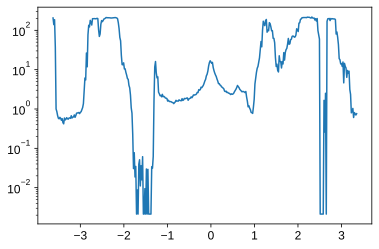

In [295]:
# base temp sweep
nT2022 = np.interp(gateT2022, [V0 - Vgfull2022*multfactor*7/4, V0 + Vgfull2022*multfactor*7/4], [-7/4*nfull, 7/4*nfull])
plt.figure()
plt.semilogy(nT2022, Rxx2022Tcorr[0, :]/1000)

# np.savetxt(BaseTfile + 'M12_1p04_RxxvsN.txt', np.vstack((nT2022, Rxx2022Tcorr[0, :])), fmt='%.8e', header='electron density (in 10^12 cm^-2) vs Rxx at base temp')

Text(0.5, 0, '$\\nu$')

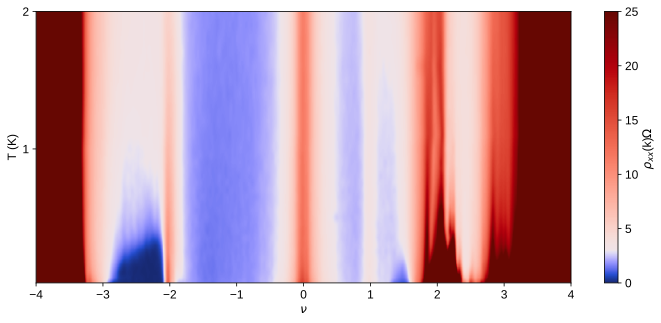

In [296]:
x = np.linspace(-6, 6, 1000)
y = np.linspace(0.025, 10, 1000)

plt.figure(figsize=(12, 5))  # the raw X data doesn't look any better
plt.pcolormesh(x, y, gaussian_filter(R2022Tfunc_2(x, y).T, (1.2, 1.2))/1000, norm=TwoSlopeNorm(vmin=0, vcenter=3, vmax=25), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label=r'$\rho$' + '$_{xx}$ (k$\Omega$)')
plt.ylabel('T (K)')
plt.xlim((-4, 4))
plt.ylim((0.025, 2))
plt.yticks(range(1, 3))
plt.xlabel(r'$\nu$')
# plt.savefig(figfile + 'M12_1p04_tempgateto2K_log.svg', dpi=300, bbox_inches='tight')

Text(0.5, 0, '$\\nu$')

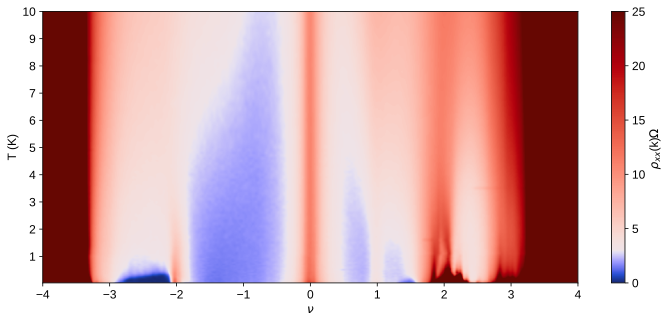

In [297]:
x = np.linspace(-6, 6, 1000)
y = np.linspace(0.025, 10, 1000)

plt.figure(figsize=(12, 5))  # the raw X data doesn't look any better
plt.pcolormesh(x, y, gaussian_filter(R2022Tfunc_2(x, y).T, (1.2, 1.2))/1000, norm=TwoSlopeNorm(vmin=0, vcenter=3, vmax=25), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label=r'$\rho$' + '$_{xx}$ (k$\Omega$)')
plt.ylabel('T (K)')
plt.xlim((-4, 4))
plt.ylim((0.025, 10))
plt.yticks(range(1, 11))
plt.xlabel(r'$\nu$')
# plt.savefig(figfile + 'M12_1p04_tempgateto10K_log.svg', dpi=300, bbox_inches='tight')

Tc determination

Electron side

In [298]:
filling2022T_2[262]

1.496977448238507

(-0.1, 4.0, -0.1, 5.0)

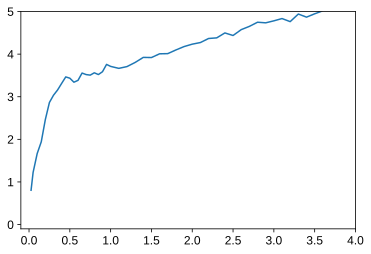

In [299]:
plt.figure()
plt.plot(T2022, Rxx2022Tcorr[:, 262]/1000) # use this one (blue)
# plt.plot(T2022, Rxx2022Tcorr[:, 259]/1000)
plt.axis((-0.1, 4, -0.1, 5))

In [300]:
def halfTc(temps, Rxx, n1, m1, n2, m2, pad=0.25):
    plt.plot(temps[n1:m1], Rxx[n1:m1])
    sl1, b1 = np.polyfit(temps[n1:m1], Rxx[n1:m1], 1)
    x1 = np.linspace(temps[n1] - pad, temps[m1] + pad, 3)
    plt.plot(x1, sl1*x1 + b1, 'k--', lw=0.7)

    plt.plot(temps[n2:m2], Rxx[n2:m2])
    sl2, b2 = np.polyfit(temps[n2:m2], Rxx[n2:m2], 1)
    x2 = np.linspace(temps[n2] - pad, temps[m2] + pad, 3)
    plt.plot(x2, sl2*x2 + b2, 'k--', lw=0.7)
    
    RN = (b1*sl2 - b2*sl1)/(sl2 - sl1)
    Tc = np.interp(RN/2, Rxx[n1:m1+5], temps[n1:m1+5])
    Tc10 = np.interp(RN*0.1, Rxx[n1:m1+7], temps[n1:m1+7])
    Tc90 = np.interp(RN*0.9, Rxx[n1:m1+7], temps[n1:m1+7])
    return Tc, Tc10, Tc90, RN/2


0.09759059022320202 0.025 0.2778924720488377 1.6445817863388341


(-0.1, 4.0, -0.1, 5.0)

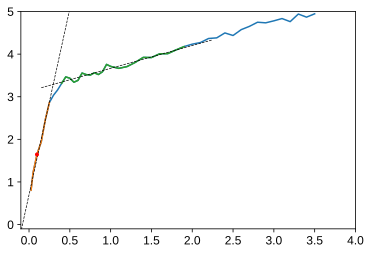

In [301]:
plt.figure()

xmin, xmax = -0.1, 4
ymin, ymax = -0.1, 5
# for i in range(9):
plt.plot(np.ma.masked_outside(T2022, xmin, xmax), np.ma.masked_outside(Rxx2022Tcorr[:, 262]/1000, ymin, ymax))

Tc, Tc10, Tc90, Rhalf = halfTc(T2022, Rxx2022Tcorr[:, 262]/1000, 0, 6, 8, 30)
plt.plot([Tc], [Rhalf], '.r')
print(Tc, Tc10, Tc90, Rhalf)

plt.axis((xmin, xmax, ymin, ymax))

Hole side SC

In [302]:
filling2022T_2[128]

-2.2177443677607522

(-0.1, 4.0, -0.1, 5.0)

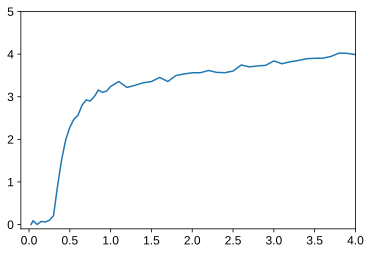

In [303]:
plt.figure()
plt.plot(T2022, Rxx2022Tcorr[:, 128]/1000) # use this one (blue)
# plt.plot(T2022, Rxx2022Tcorr[:, 121]/1000)
plt.axis((-0.1, 4, -0.1, 5))

In [304]:
def halfTc(temps, Rxx, n1, m1, n2, m2, pad=0.25):
    plt.plot(temps[n1:m1], Rxx[n1:m1])
    sl1, b1 = np.polyfit(temps[n1:m1], Rxx[n1:m1], 1)
    x1 = np.linspace(temps[n1] - pad, temps[m1] + pad, 3)
    plt.plot(x1, sl1*x1 + b1, 'k--', lw=0.7)

    plt.plot(temps[n2:m2], Rxx[n2:m2])
    sl2, b2 = np.polyfit(temps[n2:m2], Rxx[n2:m2], 1)
    x2 = np.linspace(temps[n2] - pad, temps[m2] + pad, 3)
    plt.plot(x2, sl2*x2 + b2, 'k--', lw=0.7)
    
    RN = (b1*sl2 - b2*sl1)/(sl2 - sl1)
    Tc = np.interp(RN/2, Rxx[n1:m1+5], temps[n1:m1+5])
    Tc10 = np.interp(RN*0.1, Rxx[n1-4:m1+7], temps[n1-4:m1+7])
    Tc90 = np.interp(RN*0.9, Rxx[n1:m1+7], temps[n1:m1+7])
    return Tc, Tc10, Tc90, RN/2

0.39987690099430084 0.30703582001247254 0.6392060513509357 1.5285078638562746


(-0.1, 4.0, -0.1, 5.0)

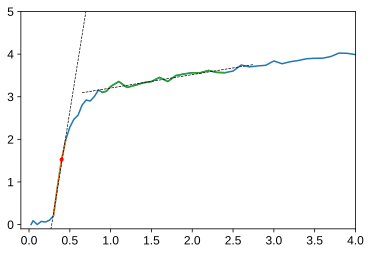

In [305]:
plt.figure()

xmin, xmax = -0.1, 4
ymin, ymax = -0.1, 5
# for i in range(9):
plt.plot(np.ma.masked_outside(T2022, xmin, xmax), np.ma.masked_outside(Rxx2022Tcorr[:, 128]/1000, ymin, ymax))

Tc, Tc10, Tc90, Rhalf = halfTc(T2022, Rxx2022Tcorr[:, 128]/1000, 6, 10, 18, 35)
plt.plot([Tc], [Rhalf], '.r')
print(Tc, Tc10, Tc90, Rhalf)

plt.axis((xmin, xmax, ymin, ymax))

In [306]:
print(Tc, Rhalf)

0.39987690099430084 1.5285078638562746


In [307]:
prevtheta = 0.9786270725607448
newtheta = np.sqrt(multfactor)*prevtheta
print('Theta for aligning with filling peaks: {} degrees'.format(newtheta))

Theta for aligning with filling peaks: 1.0402948477610368 degrees


Then the angle would actually be 1.04$^\circ$. Perhaps this is due to disorder in this device, which is also indicated by the reduced quality of the landau fan diagram, and the multiple partial-filling peaks. However, we still see superconductivity in the same places as in the 0.97$^\circ$ device. Perhaps it is an area with two domains: one at 0.98$^\circ$, indicated by the lower-density peak at positive half filling and the lack of a peak at negative half filling, and one area at 1.04$^\circ$, which is indicated by the 1/4, -1/2, and larger +1/2 filling peaks.

Ok, back to the analysis (for the temperature sweeps, I will base everything on 1.04$^\circ$, since it looks more appealing)

3.77 is not a value in the array
Plotted 3.75 instead


(0.0, 6.0)

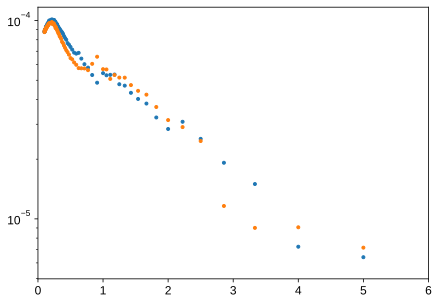

In [308]:
hn = npd.val_to_index([-3.2], gateT2022)[0]
hn -= 1
hp = npd.val_to_index([3.77], gateT2022)[0]
plt.figure(figsize=(7, 5))
# plt.plot(T2022, Rxx2022Tcorr[:, hn], '.')
# plt.plot(T2022, Rxx2022Tcorr[:, hp], '.')
# plt.plot(T2022, Rxx2022Tcorr[:, hp-1], '.')
# plt.plot(T2022, Rxx2022Tcorr[:, hp-2], '.')
# plt.plot(T2022, Rxx2022Tcorr[:, hp-3], '.')
# plt.plot(T2022, Rxx2022Tcorr[:, hp+1], '.')
# plt.plot(T2022, Rxx2022Tcorr[:, hp+2], '.')
# plt.plot(T2022, Rxx2022Tcorr[:, hp+3], '.')
plt.semilogy(1/T2022, 1/Rxx2022Tcorr[:, hp+8], '.')
plt.semilogy(1/T2022, 1/Rxx2022Tcorr[:, hp+7], '.')
plt.xlim(0, 6)

In [309]:
print(gateT2022[hp], gateT2022[hp+2], gateT2022[hp+8])

3.75 3.85 4.15


In [310]:
nt = 29
nt2 = -29
nt3 = 25
nt4 = -29
nt3_2 = 31
nt4_2 = -29
nt3_3 = 31
nt4_3 = -34
slt2022, bt2022 = np.polyfit(1/T2022[nt:nt2], np.log(1/Rxx2022Tcorr[nt:nt2, hn]), 1)
slt2022p, bt2022p = np.polyfit(1/T2022[nt3:nt4], np.log(1/Rxx2022Tcorr[nt3:nt4, hp]), 1)
# slt2022p_2, bt2022p_2 = np.polyfit(1/T2022[nt3_2:nt4_2], np.log(1/Rxx2022Tcorr[nt3_2:nt4_2, hp+2]), 1)
slt2022p_3, bt2022p_3 = np.polyfit(1/T2022[nt3_3:nt4_3], np.log(1/Rxx2022Tcorr[nt3_3:nt4_3, hp+7]), 1)

Text(0.5, 0, '1/T (K$^{-1}$)')

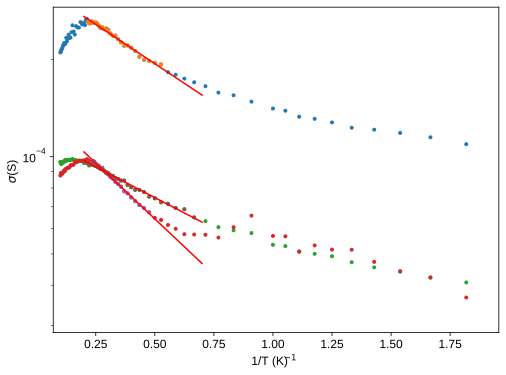

In [311]:
plt.figure(figsize=(8, 6))
plt.semilogy(1/T2022, 1/Rxx2022Tcorr[:, hn], '.')
plt.semilogy(1/T2022[nt:nt2], 1/Rxx2022Tcorr[nt:nt2, hn], '.')
plt.semilogy(1/T2022, 1/Rxx2022Tcorr[:, hp], '.')
# plt.semilogy(1/T2022, 1/Rxx2022Tcorr[:, hp+1], '.')
# plt.semilogy(1/T2022, 1/Rxx2022Tcorr[:, hp+2], '.')
plt.semilogy(1/T2022, 1/Rxx2022Tcorr[:, hp+7], '.')
# plt.semilogy(1/T2022[nt3_3:nt4_3], 1/Rxx2022Tcorr[nt3_2:nt4_2, hp+2], '.')
plt.semilogy(1/T2022[nt3_3:nt4_3], 1/Rxx2022Tcorr[nt3_3:nt4_3, hp+7], '.')
plt.semilogy(1/T2022[nt3:nt4], 1/Rxx2022Tcorr[nt3:nt4, hp], '.')
xt = np.linspace(0.2, 0.7, 100)
plt.semilogy(xt, np.exp(slt2022*xt + bt2022), 'r')
xtp = np.linspace(0.2, 0.7, 100)
plt.semilogy(xtp, np.exp(slt2022p*xtp + bt2022p), 'r')
# plt.semilogy(xtp, np.exp(slt2022p_2*xtp + bt2022p_2), 'r')
plt.semilogy(xtp, np.exp(slt2022p_3*xtp + bt2022p_3), 'r')
plt.axis((0.07013935483870948,
 1.956010322580637,
 2.856523328972447e-05,
 0.00029028435480691966))
plt.ylabel('$\sigma$ (S)')
plt.xlabel('1/T (K$^{-1}$)')
# plt.savefig(figfile + 'M12_halffillinggapfits.svg', bbox_inches='tight')

In [312]:
-slt2022*1.381e-23/1.602e-19*2*1000 # hole-side half filling gap in meV

0.19315445442749712

In [313]:
-slt2022p*1.381e-23/1.602e-19*2*1000 # electron-side half filling gap in meV for the 0.98 degrees

0.15084884552529632

In [314]:
-slt2022p_3*1.381e-23/1.602e-19*2*1000  # based on the 4.1Vbg data for electron half filling (1.04 degrees). Use this.

0.27413284174848906

The filling factors for each curve there

In [315]:
filling2022T_2[hn]  # negative 1/2 filling

-2.0236917355816866

In [316]:
filling2022T_2[hp]  # this one is the apparent half filling for ~0.98 degrees. index 275

1.857360907999631

In [317]:
filling2022T_2[283] # this one is the actual tallest peak near half filling (for 1.04 degrees), index 283, or hp+8

2.0791353447757057

In [318]:
filling2022T_2[282] # this one is the actual tallest peak near half filling (for 1.04 degrees), index 282, or hp+7 (perhaps better)

2.0514135401786966

#### 1.04 degree half filling gaps: hole side 0.193 meV, electron side 0.262 meV

Look also briefly for a gap near +3/4 (when measured assuming 0.98 degrees)

In [319]:
npd.val_to_index([0.4], T2022)

[8]

In [320]:
npd.val_to_index([2.8], filling2022T_2)

2.80 is not a value in the array
Plotted 2.80 instead


[309]

In [321]:
np.argmax(Rxx2022Tcorr[8, 305:320])

5

(0.0, 6.0, 2e-05, 9e-05)

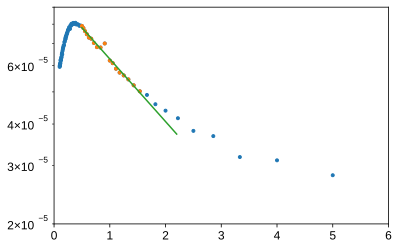

In [322]:
plt.figure()
plt.semilogy(1/T2022, 1/Rxx2022Tcorr[:, 310], '.')
n1 = -73
n2 = -55
plt.semilogy(1/T2022[n1:n2], 1/Rxx2022Tcorr[n1:n2, 310], '.')
sl3, b3 = np.polyfit(1/T2022[n1:n2], np.log(1/Rxx2022Tcorr[n1:n2, 310]), 1)

x1 = np.linspace(0.5, 2.2, 100)
plt.semilogy(x1, np.exp(x1*sl3 + b3))
plt.axis((0, 6, 2e-5, 9e-5))

In [323]:
-sl3*1.381e-23/1.602e-19*2*1000  # based on the potential +3/4 state (considering that contacts 20-22 may be measuring over 2 domains, one at 1.04, one at 0.98 degrees)

0.07485151978319206

##  all together

Text(0.5, 0, '1/T (K$^{-1}$)')

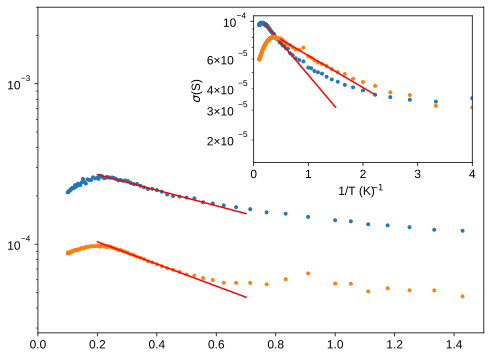

In [324]:
plt.figure(figsize=(8, 6))
plt.semilogy(1/T2022, 1/Rxx2022Tcorr[:, hn], '.')
plt.semilogy(1/T2022, 1/Rxx2022Tcorr[:, hp+7], '.')
xt = np.linspace(0.2, 0.7, 100)
plt.semilogy(xt, np.exp(slt2022*xt + bt2022), 'r')
xtp = np.linspace(0.2, 0.7, 100)
plt.semilogy(xtp, np.exp(slt2022p_3*xtp + bt2022p_3), 'r')

plt.xlim(0, 1.5)
plt.ylim(2.8e-5, 3e-3)

##### based on 0.98 degrees, make a subplot #######
plt.axes([0.5, 0.52, 0.38, 0.34])
plt.semilogy(1/T2022, 1/Rxx2022Tcorr[:, hp], '.')
xtp = np.linspace(0.2, 1.5, 100)
plt.semilogy(xtp, np.exp(slt2022p*xtp + bt2022p), 'r')

plt.semilogy(1/T2022, 1/Rxx2022Tcorr[:, 310], '.')
n1 = -73
n2 = -55
# plt.semilogy(1/T2022[n1:n2], 1/Rxx2022Tcorr[n1:n2, 310], '.')
sl3, b3 = np.polyfit(1/T2022[n1:n2], np.log(1/Rxx2022Tcorr[n1:n2, 310]), 1)

x1 = np.linspace(0.5, 2.2, 100)
plt.semilogy(x1, np.exp(x1*sl3 + b3), 'r')


plt.xlim(0, 4)
plt.ylabel('$\sigma$ (S)')
plt.xlabel('1/T (K$^{-1}$)')
# plt.savefig(figfile + 'M12_halffillinggapfits.svg', bbox_inches='tight')

## 1.14 degree full filling gap calculations:

In [325]:
m12tdata1 = qc.load_data('../../PPMS/qcodes_data/data/2020-01-02/#007_M12_11-12_gsweep_1p75K_2nA_16-28-15') #1.75K
m12tdata2 = qc.load_data('../../PPMS/qcodes_data/data/2020-01-02/#008_M12_11-12_temp_gsweep_2to20K_2nA_16-42-25')
m12tdata3 = qc.load_data('../../PPMS/qcodes_data/data/2020-01-02/#009_M12_11-12_temp_gsweep_22to120K_2nA_20-10-35')

In [ ]:
# Running this instead of the above line will make it work with the data repository
ta1 = qc.load_data('PPMS/qcodes_data/data/2020-01-02/#007_M12_11-12_gsweep_1p75K_2nA_16-28-15') #1.75K
m12tdata2 = qc.load_data('PPMS/qcodes_data/data/2020-01-02/#008_M12_11-12_temp_gsweep_2to20K_2nA_16-42-25')
m12tdata3 = qc.load_data('PPMS/qcodes_data/data/2020-01-02/#009_M12_11-12_temp_gsweep_22to120K_2nA_20-10-35')

In [326]:
Tsm12 = np.concatenate(([1.75], m12tdata2.ppms_temperature_set_stable_set[:], m12tdata3.ppms_temperature_set_stable_set[:]))
gsm12 = m12tdata1.srdc_volt_set[:]
RTm12 = np.vstack((npd.Rxxfromdata(m12tdata1, 2e-9, 'lockin2'), npd.Rxxfromdata(m12tdata2, 2e-9, 'lockin2'), npd.Rxxfromdata(m12tdata3, 2e-9, 'lockin2')))

In [327]:
Tsm12 = Tsm12[[i !=5 for i in range(len(Tsm12))]]  #6K data looked bad, so delete that segment
RTm12 = RTm12[[i !=5 for i in range(len(RTm12))], :]

In [328]:
RTm12corr = np.copy(RTm12)
RTm12corr[RTm12 <= 0] = np.min(np.abs(RTm12))  # get rid of <= 0 results since they throw off log-scale plots

In [329]:
Tsm12[20]

24.0

In [330]:
gsm12[175:190]

array([-0.25, -0.2 , -0.15, -0.1 , -0.05,  0.  ,  0.05,  0.1 ,  0.15,
        0.2 ,  0.25,  0.3 ,  0.35,  0.4 ,  0.45])

In [331]:
multfactor = 1.14
Vgfull2022 = 6.38454649743731
V0ind = np.argmax(RTm12corr[20, 175:190])
V0 = gsm12[175 + V0ind]
fillingTM12 = np.interp(gsm12, [V0 - Vgfull2022*multfactor*7/4, V0 + Vgfull2022*multfactor*7/4], [-7, 7])

In [332]:
RTm12func = RectBivariateSpline(fillingTM12, Tsm12, RTm12corr.T)

Text(0, 0.5, 'T (K)')

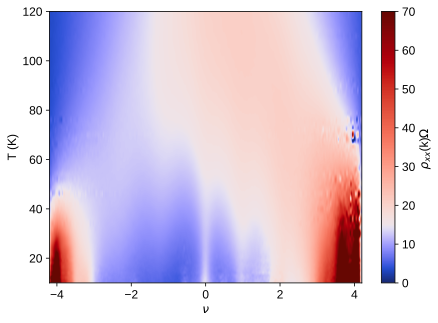

In [333]:
x = np.linspace(-5, 5, 1000)
y = np.linspace(2, 120, 1000)
plt.figure(figsize=(7, 5))  # notice here the larger Rxx range, meaning higher peaks, due to the larger angle
# also note that the negative half filling somewhat disappeared after a few K
plt.pcolormesh(x, y, gaussian_filter(RTm12func(x, y).T, (1.2, 1.2))/1000, norm=TwoSlopeNorm(vcenter=15, vmin=0, vmax=70), cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
plt.colorbar(label=r'$\rho$' + '$_{xx}$ (k$\Omega$)')
plt.xlim((-4.2, 4.2))
plt.ylim((10, 120))
plt.xlabel(r'$\nu$')
plt.ylabel('T (K)')
# plt.savefig(figfile + 'M12_1p04_tempgateto120K_log.svg', dpi=300, bbox_inches='tight')

Fit the electron-side peaks

In [334]:
window = 7
ind1, ind2 = npd.val_to_index([1.8, 2.5], fillingTM12)
startT2, endT2 = 0, len(Tsm12)-40
T2 = []
nu2peakind = []
nu2peak = []
nu2peakR = []
for i in range(startT2, endT2):
    try:
        # First the simple peak fit (use a gaussian filter to get rid of smaller bumps)
        R = gaussian_filter(RTm12corr[i, ind1:ind2]/1000, 0.7)
        pind = int(find_peaks(R, prominence=0.02, distance=30)[0][0] + ind1)
        nu2peakind.append(pind)
        T2.append(Tsm12[i])
        # Then do a quadratic fit and take the peak
        a, b, c = np.polyfit(fillingTM12[pind-window:pind+window], gaussian_filter(RTm12corr[i, pind-window:pind+window], 0.7), 2)
        xpeak = -b/(2*a)
        nu2peak.append(xpeak)
        nu2peakR.append(a*xpeak**2 + b*xpeak + c)
    except:
        continue
        
window = 7
ind1, ind2 = npd.val_to_index([0.8, 1.5], fillingTM12)      
startT1, endT1 = 10, len(Tsm12)-30
T1 = []
nu1peakind = []
nu1peak = []
nu1peakR = []
for i in range(startT1, endT1):
    try:
        R = gaussian_filter(RTm12corr[i, ind1:ind2]/1000, 1)
        pind = int(find_peaks(R, prominence=0.015, distance=30)[0][0] + ind1)
        nu1peakind.append(pind)
        T1.append(Tsm12[i])
        a, b, c = np.polyfit(fillingTM12[pind-window:pind+window], gaussian_filter(RTm12corr[i, pind-window:pind+window], 0.7), 2)
        xpeak = -b/(2*a)
        nu1peak.append(xpeak)
        nu1peakR.append(a*xpeak**2 + b*xpeak + c)
    except:
        continue

1.80 is not a value in the array
Plotted 1.81 instead
2.50 is not a value in the array
Plotted 2.50 instead
0.80 is not a value in the array
Plotted 0.80 instead
1.50 is not a value in the array
Plotted 1.51 instead


In [335]:
for i in range(len(T1)-1):
    if nu1peak[i] > nu1peak[i+1] + 0.5:
        print(i)

2


In [336]:
del T1[2]
del nu1peak[2]
del nu1peakR[2]

(-0.5, 3.5)

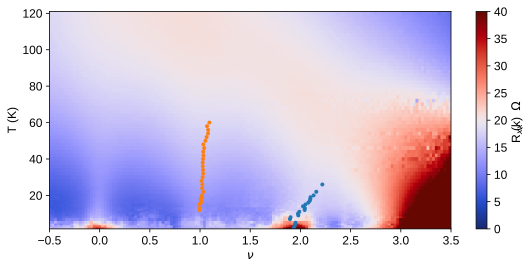

In [337]:
fig, ax = plt.subplots(1, 1, figsize=(9, 4))
norm = TwoSlopeNorm(20, 0, 40)
p = ax.pcolormesh(fillingTM12, Tsm12, RTm12corr/1000, norm=norm, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
ax.set_ylabel('T (K)')
ax.set_xlabel('$\\nu$')
fig.colorbar(p, ax=ax, label='R$_{xx}$ (k$\Omega$)')
ax.plot(nu2peak, T2, '.')
ax.plot(nu1peak, T1, '.')
ax.set_xlim(-0.5, 3.5)

(0.4, 3.4, 8.0, 30.0)

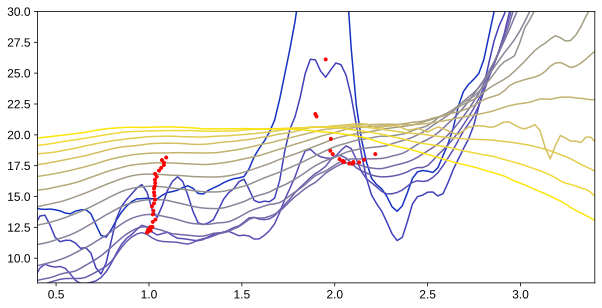

In [338]:
N = 15
colors = plt.get_cmap('cet_bjy')([i/(N-1) for i in range(N)])

fig, ax = plt.subplots(1, 1, figsize=(10, 5))
for i in range(N):
    indx = i*4
    ax.plot(fillingTM12, gaussian_filter(RTm12corr[indx, :]/1000, 1), color=colors[i], label='{:.2f} K'.format(Tsm12[indx]))


ax.plot(nu1peak, np.array(nu1peakR)/1000, '.r')
ax.plot(nu2peak, np.array(nu2peakR)/1000, '.r')
ax.axis((0.4, 3.4, 8, 30))
# l = plt.legend()

In [339]:
# np.savetxt(Peakfile+'M12_1p04_nu1peaks.txt', np.vstack((T1, nu1peak, nu1peakR)).T, fmt='%.8e', header='columns: Temperatures (K), nu, Resistance (ohms)')
# np.savetxt(Peakfile+'M12_1p04_nu2peaks.txt', np.vstack((T2, nu2peak, nu2peakR)).T, fmt='%.8e', header='columns: Temperatures (K), nu, Resistance (ohms)')

Try combining the dil fridge data with PPMS data

In [340]:
RTcomb = np.vstack((Rxx2022Tcorr[:, 23:-20], RTm12corr[9:, :-3]))
Tscomb = np.concatenate((T2022, Tsm12[9:]))
gscomb = gsm12[3:]

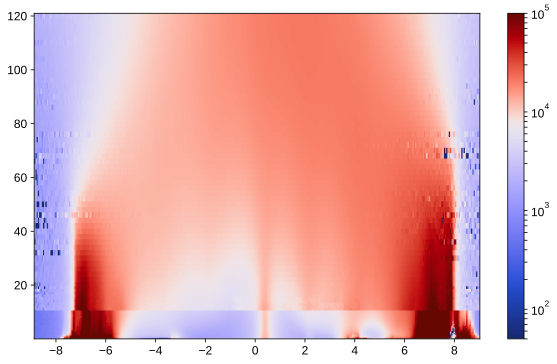

In [341]:
plt.figure(figsize=(10, 6))  # doesn't work to combine them...
plt.pcolormesh(gscomb, Tscomb, RTcomb, norm=npd.DivLogNorm(0.66, vmin=50, vmax=1e5), rasterized=True, cmap=cc.cm.diverging_bwr_20_95_c54)
plt.colorbar(ticks=ticker.LogLocator(subs=range(10)), format=ticker.LogFormatterMathtext())

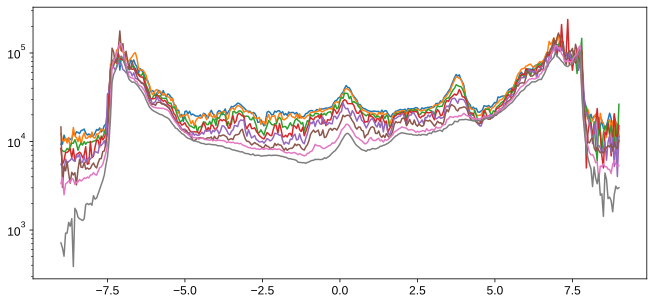

In [342]:
plt.figure(figsize=(11, 5)) # not sure why it was so noisy at low temperatures...
plt.semilogy(gsm12, RTm12corr[0, :]+8000)
plt.semilogy(gsm12, RTm12corr[1, :]+7000)
plt.semilogy(gsm12, RTm12corr[2, :]+6000)
plt.semilogy(gsm12, RTm12corr[3, :]+5000)
plt.semilogy(gsm12, RTm12corr[4, :]+4000)
plt.semilogy(gsm12, RTm12corr[5, :]+3000)
plt.semilogy(gsm12, RTm12corr[10, :]+2000)
plt.semilogy(gsm12, RTm12corr[15, :])

In [343]:
V0 = 0.25
vfulldiff = 3.75*2
Vfulle = V0 + vfulldiff
v3quart3 = 3.75*3/2 + V0
ind = npd.val_to_index([Vfulle], gsm12)[0]

In [344]:
print(ind, gsm12[ind])

335 7.75


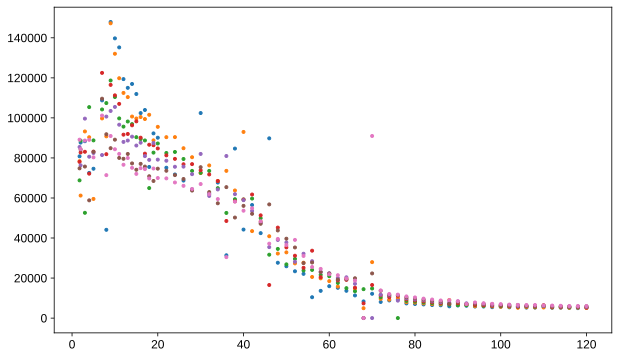

In [345]:
ind = npd.val_to_index([Vfulle], gsm12)[0]
plt.figure(figsize=(10, 6)) # do some averaging of these curves
plt.plot(Tsm12, RTm12corr[:, ind], '.')
# plt.plot(Tsm12, RTm12corr[:, ind+1], '.')
# plt.plot(Tsm12, RTm12corr[:, ind+2], '.')
plt.plot(Tsm12, RTm12corr[:, ind-1], '.')
plt.plot(Tsm12, RTm12corr[:, ind-2], '.')
plt.plot(Tsm12, RTm12corr[:, ind-3], '.')
plt.plot(Tsm12, RTm12corr[:, ind-4], '.')
plt.plot(Tsm12, RTm12corr[:, ind-5], '.')
plt.plot(Tsm12, RTm12corr[:, ind-6], '.')

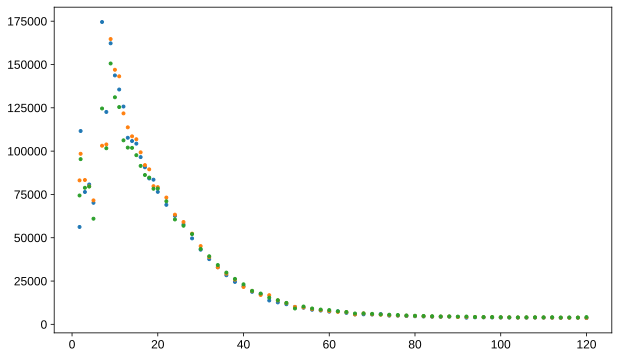

In [346]:
Vfullh = V0 - vfulldiff
ind = npd.val_to_index([Vfullh], gsm12)[0]
plt.figure(figsize=(10, 6)) # do some averaging of these curves
# plt.plot(Tsm12, RTm12[:, ind], '.')
# plt.plot(Tsm12, RTm12[:, ind-1], '.')
# plt.plot(Tsm12, RTm12[:, ind+1], '.')
# # plt.plot(Tsm12, RTm12[:, ind-2], '.')
# plt.plot(Tsm12, RTm12[:, ind+2], '.')
plt.plot(Tsm12, RTm12corr[:, ind+3], '.')
plt.plot(Tsm12, RTm12corr[:, ind+4], '.')
plt.plot(Tsm12, RTm12corr[:, ind+5], '.')
# plt.plot(Tsm12, RTm12corr[:, ind+6], '.')

In [347]:
ind = npd.val_to_index([Vfulle], gsm12)[0]
RTm12av_e = np.average(RTm12corr[:, ind-6:ind-3], axis=1)
n1 = -37
n2 = -14
exc = (43, 42)
Tsm12_e = np.copy(Tsm12)
Tsm12_e = Tsm12[[i not in exc for i in range(len(RTm12av_e))]]
RTm12av_e = RTm12av_e[[i not in exc for i in range(len(RTm12av_e))]]
# print(len(RTm12av_e), len(Tsm12_e))
slm12e, bm12e = np.polyfit(1/Tsm12_e[n1:n2], np.log(1/RTm12av_e[n1:n2]), 1)

ind = npd.val_to_index([Vfullh], gsm12)[0]
RTm12av_h = np.average(RTm12corr[:, ind+3:ind+6], axis=1)
n1_h = -43
n2_h = -19
slm12h, bm12h = np.polyfit(1/Tsm12[n1_h:n2_h], np.log(1/RTm12av_h[n1_h:n2_h]), 1)

In [348]:
npd.val_to_index([68, 70], Tsm12) #spurious points

[42, 43]

In [349]:
1/0.0147

68.02721088435375

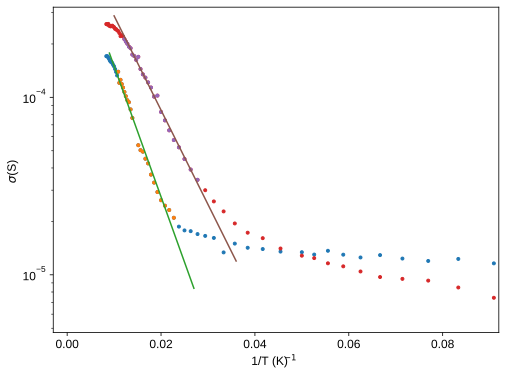

In [350]:
plt.figure(figsize=(8, 6))
plt.semilogy(1/Tsm12_e, 1/RTm12av_e, '.')
plt.semilogy(1/Tsm12_e[n1:n2], 1/RTm12av_e[n1:n2], '.')
x1 = np.linspace(0.009, 0.027, 100)
plt.semilogy(x1, np.exp(x1*slm12e + bm12e))
plt.semilogy(1/Tsm12, 1/RTm12av_h, '.')
plt.semilogy(1/Tsm12[n1_h:n2_h], 1/RTm12av_h[n1_h:n2_h], '.')
x1 = np.linspace(0.01, 0.036, 100)
plt.semilogy(x1, np.exp(x1*slm12h + bm12h))
plt.axis((-0.0029626296082949366,
 0.09196536578341013,
 4.730118003098528e-06,
 0.0003222253398912407))
plt.ylabel('$\sigma$ (S)')
plt.xlabel('1/T (K$^{-1}$)')
plt.savefig(figfile + 'M12_fullfillinggapfits.svg', transparent=True, bbox_inches='tight')

In [351]:
-slm12e*1.381e-23/1.602e-19*2*1000  # electron-side full filling gap

29.23107911507331

In [352]:
-slm12h*1.381e-23/1.602e-19*2*1000  # hole-side full filling gap

21.09342405932853

#### 0.98$^\circ$ full-filling gaps: hole 21.1 meV, electron 29.2 meV

Full plot of all of them

(2e-05, 0.0004)

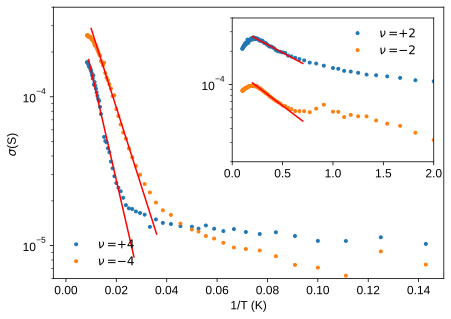

In [353]:
plt.figure(figsize=(7, 5))
plt.semilogy(1/Tsm12_e, 1/RTm12av_e, '.', label=r'$\nu = +4$')
x1 = np.linspace(0.009, 0.027, 100)
plt.semilogy(x1, np.exp(x1*slm12e + bm12e), 'r')

plt.semilogy(1/Tsm12, 1/RTm12av_h, '.', label=r'$\nu = -4$')
x1 = np.linspace(0.01, 0.036, 100)
plt.semilogy(x1, np.exp(x1*slm12h + bm12h), 'r')

plt.legend(loc='lower left', frameon=False)
plt.axis((-0.005, 0.15, 6e-6, 4e-4))
plt.ylabel('$\sigma$ (S)')
plt.xlabel('1/T (K)')

ax = plt.axes([0.48, 0.45, 0.4, 0.4])
ax.semilogy(1/T2022, 1/Rxx2022Tcorr[:, hn], '.', label=r'$\nu = +2$')
xt = np.linspace(0.2, 0.7, 100)
ax.semilogy(xt, np.exp(slt2022*xt + bt2022), 'r')

ax.semilogy(1/T2022, 1/Rxx2022Tcorr[:, hp+7], '.', label=r'$\nu = -2$')
xtp = np.linspace(0.2, 0.7, 100)
ax.semilogy(xtp, np.exp(slt2022p_3*xtp + bt2022p_3), 'r')
ax.legend(frameon=False)
ax.set_xlim((0, 2))
ax.set_ylim((2e-5, 4e-4))

# plt.savefig(figfile + 'M12_gapplots.svg', bbox_inches='tight')

## Looking at the CNP for 1.04$^\circ$

In [354]:
filling2022T_2[208]

0.0

(-0.2, 10.0)

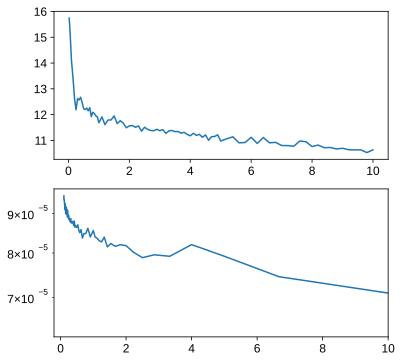

In [355]:
fig, ax = plt.subplots(2, 1, figsize=(6,6))
ax[0].plot(T2022, Rxx2022Tcorr[:, 208]/1000)
ax[1].semilogy(1/T2022, 1/Rxx2022Tcorr[:, 208])
ax[1].set_xlim(-0.2, 10)

## One more full filling data point, fitting the 1.14$^\circ$ data from M05 contacts 20-16 (so covers two areas with slightly different angle (1.05 and 1.14).

PPMS contacts 13-14, Triton contacts 20-16

In [356]:
tdata1 = qc.load_data('../../PPMS/qcodes_data/data/2019-09-24/#003_1p7to10K_contacts13-14_twod_negativegate_20-41-13')
tdata2 = qc.load_data('../../PPMS/qcodes_data/data/2019-09-25/#001_11to30K_contacts13-14_twod_negativegate_01-40-56')
tdata3 = qc.load_data('../../PPMS/qcodes_data/data/2019-09-25/#002_32p5to150K_contacts13-14_twod_negativegate_04-43-57')

In [356]:
# Running this line instead of the above should make it work with the data repository
tdata1 = qc.load_data('PPMS/qcodes_data/data/2019-09-24/#003_1p7to10K_contacts13-14_twod_negativegate_20-41-13')
tdata2 = qc.load_data('PPMS/qcodes_data/data/2019-09-25/#001_11to30K_contacts13-14_twod_negativegate_01-40-56')
tdata3 = qc.load_data('PPMS/qcodes_data/data/2019-09-25/#002_32p5to150K_contacts13-14_twod_negativegate_04-43-57')

In [357]:
Ts2016 = np.concatenate((tdata1.ppms_temperature_set_stable_set[:], tdata2.ppms_temperature_set_stable_set[:], tdata3.ppms_temperature_set_stable_set[:-8]))
gs2016 = np.array(tdata1.k2200_voltage_set[0, :])*-1
Rs2016 = np.vstack((tdata1.lockin1_X[:, :], tdata2.lockin1_X[:, :], tdata3.lockin1_X[:-8, :]))/1e-9

In [358]:
gs2016[69]

-13.1

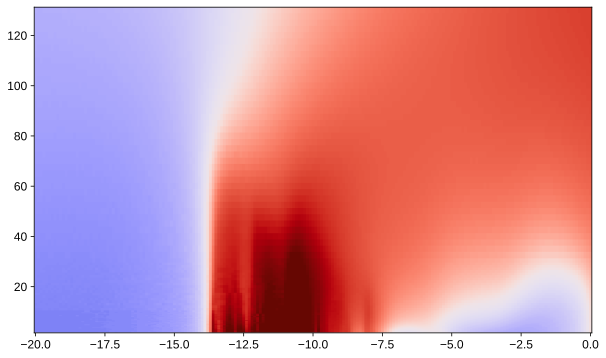

In [359]:
plt.figure(figsize=(10, 6))
plt.pcolormesh(gs2016, Ts2016, Rs2016, norm=npd.DivLogNorm(0.66, vmin=50, vmax=1e5), rasterized=True, cmap=cc.cm.diverging_bwr_20_95_c54)

In [360]:
slt2016, bt2016 = np.polyfit(1/Ts2016[66:84], np.log(1/Rs2016[66:84, 69]), 1)  # taken at -13.1 Vbg

In [361]:
print(slt2016, bt2016)

-192.9178374357085 -6.95822854450013


In [362]:
-slt2016*1.381e-23/1.602e-19*2*1000  # gap size of hole full filling (meV)

33.26086560533251

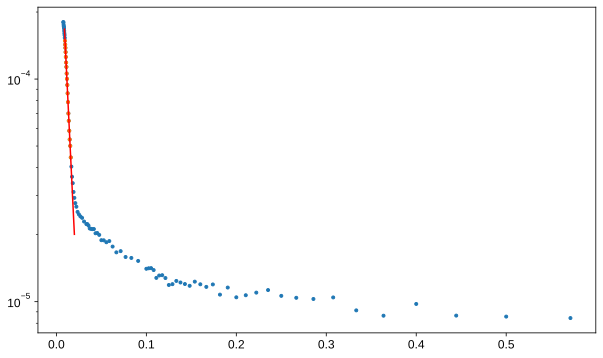

In [364]:
plt.figure(figsize=(10, 6))
plt.semilogy(1/Ts2016, 1/Rs2016[:, 69], '.')
plt.semilogy(1/Ts2016[66:84], 1/Rs2016[66:84, 69], '.')
xtl = np.linspace(0.009, 0.02)
plt.semilogy(xtl, np.exp(xtl*slt2016 + bt2016), 'r')
# pa = plt.axis(pa)

#### Hole side 1.10$^\circ$ full-filling gap: 33.3 meV (electron side is likely a bit larger, given the trend)

# Superconductivity pockets

## Start with comparing M20, 0.88$^\circ$, 0.83$^\circ$, and 0.79$^\circ$

In [365]:
dbase1621 = qc.load_data('data/2019-12-02/#006_M20_14-15_865_21-16_830_T-gatesweep_basetemp_0.4nA_22-28-37')
R1621_base = npd.Rxxfromdata(dbase1621, 0.4e-9, 'lockin830')
g1621_base = dbase1621.srframe_volt_p1_set[:]
V01621 = 0.26212986965138396 + 0.02
Vgatefull1621 = 3.495599272009696
nugate1621 = np.interp(g1621_base, [V01621 - Vgatefull1621*6/4, V01621 + Vgatefull1621*6/4], [-6, 6])

In [366]:
C1514 = 6.6e-4 # This should be the same for all angles. now convert gate voltage to density
# already have V01514 abd V01615 from above
n1514 = C1514/1.602e-19*(tgate_corr - V01514)/10**16  # in 10**12 cm^-2
n1615 = C1514/1.602e-19*(tgate_corr - V01615)/10**16
n1621 = C1514/1.602e-19*(g1621_base - V01621)/10**16

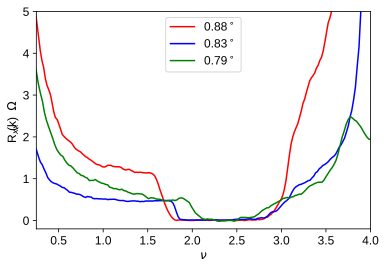

In [367]:
nav=3  # smooth a bit
plt.figure()  # SC pocket resistance vs. filling
plt.plot(npd.mov_average(nugate1514, nav), npd.mov_average(R1514corr[0, :]/1000, nav), color='red', label='0.88$^\circ$')  # 0.88 deg
plt.plot(npd.mov_average(nugate1615, nav), npd.mov_average(R1615corr[0, :]/1000, nav), color='blue', label='0.83$^\circ$')  # 0.83 deg, a little speculative. Need to read the filling from the fan diagram still
plt.plot(npd.mov_average(nugate1621, nav), npd.mov_average(R1621_base/1000, nav), color='green', label='0.79$^\circ$')  # 0.79 deg.
plt.axis((0.2497347507195078,
 4,
 -0.2,
 5))
plt.ylabel('R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.legend()

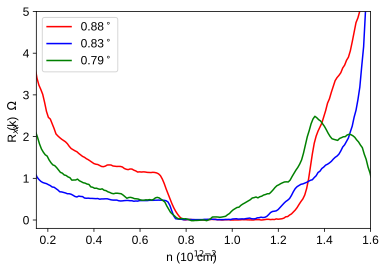

In [368]:
nav=3  # smooth a bit
plt.figure()  # SC pocket resistance vs. filling
plt.plot(npd.mov_average(n1514, nav), npd.mov_average(R1514corr[0, :]/1000, nav), color='red', label='0.88$^\circ$')  # 0.88 deg
plt.plot(npd.mov_average(n1615, nav), npd.mov_average(R1615corr[0, :]/1000, nav), color='blue', label='0.83$^\circ$')  # 0.83 deg, a little speculative. Need to read the filling from the fan diagram still
plt.plot(npd.mov_average(n1621, nav), npd.mov_average(R1621_base/1000, nav), color='green', label='0.79$^\circ$')  # 0.79 deg.
plt.axis((0.15,
 1.6,
 -0.2,
 5))
plt.ylabel('R$_{xx}$ (k$\Omega$)')
plt.xlabel('n (10$^{12}$ cm$^{-2}$)')
plt.legend()

# M05

Ultimately not used because the twist angle was too ambiguous

## Fan diagram

This one is a little bit different because the fan had all these black spots in it. I had to get rid of them with this function

In [369]:
def removeblacklines_2(R, gates, dg, zeropts):
    # zeropts = np.array([-11.6, -6.6, -1.6, 3.4, 8.4, 13.4])  # first find the points at zero field where this problem happens
    newgatepts = np.copy(zeropts)
    # dg = 0.1
    gmax = np.max(gates)
    gmin = np.min(gates)
    reachedge = np.zeros(len(zeropts))

    for j in range(R.shape[0]):
        print('Field #: ', j)
        if j > 0:
            newgatepts = newgatepts + dg
        for i, val in enumerate(newgatepts):
            if val > gmax:
                newgatepts[i] = gmin + dg
                val = newgatepts[i]
                reachedge[i] = 1

            # for each of these gate points, average the two points about the bad point 
            if reachedge[i] == 1:
                ind = npd.val_to_index([val], gates)[0]
                if ind == 0:
                    R[j, ind+1] = 0.5*(R[j, ind+2] + R[j, ind+3])
                    R[j, ind] = 0.5*(R[j, ind+1] + R[j, ind+2])
                elif ind == 1:
                    R[j, ind+1] = 0.5*(R[j, ind+2] + R[j, ind+3])
                    R[j, ind-1] = 0.5*(R[j, ind+1] + R[j, ind+2])
                    R[j, ind] = 0.5*(R[j, ind-1]+R[j, ind+1])
                elif ind == len(gates) - 2:
                    R[j, ind-1] = 0.5*(R[j, ind-2] + R[j, ind-3])
                    R[j, ind+1] = 0.5*(R[j, ind-1] + R[j, ind-2])
                    R[j, ind] = 0.5*(R[j, ind-1]+R[j, ind+1])
                elif ind == len(gates) - 1:
                    R[j, ind-1] = 0.5*(R[j, ind-2] + R[j, ind-3])
                    R[j, ind] = 0.5*(R[j, ind-1] + R[j, ind-2])
                else:
                    R[j, ind+1] = 0.5*(R[j, ind-1] + R[j, ind+2])
                    R[j, ind-1] = 0.5*(R[j, ind-2] + R[j, ind+1])
                    R[j, ind] = 0.5*(R[j, ind-1]+R[j, ind+1])
            else:
                ind = npd.val_to_index([val], gates)[0]
                R[j, ind] = 0.5*(R[j, ind-1]+R[j, ind+1])
    return R

In [370]:
zvals = np.array([-10.5333, -7.2, -3.8666, -0.53333, 2.8, 2.8 + (3+1/3), 2.8 + (3+1/3)*2, 2.8 + (3+1/3)*3, 2.8 + (3+1/3)*4])

In [371]:
d2021fan = qc.load_data('data/2019-10-13/#005_M05_21-20and20-19_LandauFan_attempt3_14-15-09')
g2021fan = d2021fan.srframe_volt_p1_set[0, :]
b2021fan = d2021fan.triton_field_set_stable_set[:-1]
X2021fan_0 = d2021fan.lockin865_X[:-1, :]/0.2e-9
R2021fan = np.sqrt(X2021fan_0**2 + (d2021fan.lockin865_Y[:-1, :]/0.2e-9)**2)

In [372]:
# redefine the Rxxfromdata
def Rxxfromdata_2(X, R, Rswitchohms=50000):

    if len(X.shape) == 1:
        for i, r in enumerate(R):
            if r > Rswitchohms:
                X[i] = r
    elif len(X.shape) == 2:
        for j in range(R.shape[0]):
            for i, r in enumerate(R[j, :]):
                if r > 5*10**4:
                    X[j, i] = r

    return X

In [373]:
X2021fan = removeblacklines_2(X2021fan_0, g2021fan, 1/15, zvals)
Rxx2021fan = Rxxfromdata_2(X2021fan, R2021fan)

Field #:  0
-10.53 is not a value in the array
Plotted -10.53 instead
-3.87 is not a value in the array
Plotted -3.87 instead
-0.53 is not a value in the array
Plotted -0.53 instead
6.13 is not a value in the array
Plotted 6.13 instead
9.47 is not a value in the array
Plotted 9.47 instead
16.13 is not a value in the array
Plotted 16.13 instead
Field #:  1
-10.47 is not a value in the array
Plotted -10.47 instead
-7.13 is not a value in the array
Plotted -7.13 instead
-3.80 is not a value in the array
Plotted -3.80 instead
-0.47 is not a value in the array
Plotted -0.47 instead
2.87 is not a value in the array
Plotted 2.87 instead
6.20 is not a value in the array
Plotted 6.20 instead
9.53 is not a value in the array
Plotted 9.53 instead
12.87 is not a value in the array
Plotted 12.87 instead
Field #:  2
-10.40 is not a value in the array
Plotted -10.40 instead
-7.07 is not a value in the array
Plotted -7.07 instead
-3.73 is not a value in the array
Plotted -3.73 instead
-0.40 is not a v

In [376]:
sl0, b0 = 9.83756187677379, -8.171778529025104
C = sl0*1.602e-19**2/6.626e-34
dBN = 3*8.85e-12/C
V0 = -b0/sl0
V0f = -6.75
print('effective capacitance: {:.4e}'.format(C))
print('effective hBN thickness: {:.1f} nm'.format(dBN*10**9))
print('V0: ', V0)
Vgatefull = V0 - V0f
print('Full filling voltage difference: {}'.format(Vgatefull))
nfull = (Vgatefull)*C/1.602e-19/10**4
print(nfull/10**12) #10**12 cm^-2
a = 0.246e-9

theta = np.sqrt(np.sqrt(3)*nfull*10**4*a**2/8)*180/np.pi
print('theta: ', theta)

effective capacitance: 3.8103e-04
effective hBN thickness: 69.7 nm
V0:  0.8306711186557765
Full filling voltage difference: 7.5806711186557765
1.8030435339268278
theta:  0.8806354541855703


In [377]:
nugate2021 = np.interp(g2021fan, [V0 - Vgatefull*8/4, V0 + Vgatefull*10/4], [-8, 10])

(-3.0, 2.0, 0.0, 10.0)

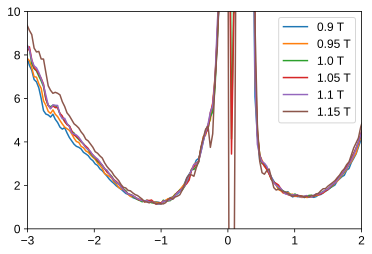

In [378]:
for i in range(6):
    indx = 18 + i
    b = b2021fan[indx]
    plt.plot(nugate2021, Rxx2021fan[indx, :]/1000, label=f'{b} T')
    
plt.legend()
plt.axis((-3, 2, 0, 10))

In [379]:
corrRxx2021fan = np.copy(Rxx2021fan)
corrRxx2021fan[corrRxx2021fan <= 0] = np.min(np.abs(corrRxx2021fan))

indices = [i not in (21, 22) for i in range(len(b2021fan))]  # deleting 1.05, 1.10 T

In [380]:
R2021func = RectBivariateSpline(nugate2021[::-1], b2021fan[indices], np.flip(Rxx2021fan[indices, :], axis=1).T, kx=1, ky=1)

(0.0, 4.0)

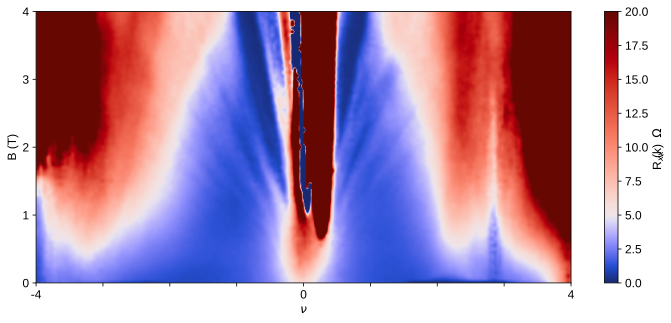

In [381]:
x = np.linspace(-6, 6, 1000)
y = np.linspace(0, 8, 1000)

cdiff = TwoSlopeNorm(vmin=0, vmax=20, vcenter=5)
plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, gaussian_filter(R2021func(x, y).T/1000, (1.1, 1.1)), cmap=cc.cm.diverging_bwr_20_95_c54, norm=cdiff, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('B (T)')
plt.xlim((-4, 4))
plt.yticks(range(0, 5))
plt.xticks(range(-4, 5), [-4, '', '', '', 0, '', '', '', 4])
plt.ylim((0, 4))

# sl, b = (9.83756187677379, 0)
# Vgatefull = 7.5806711186557765
# slfill = sl*Vgatefull/4

# Bl = 3.4
# Bs = 2.75
# for i in [-8, -6, -4, -2, 2, 4, 6, 8]:
#     x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
#     plt.plot(x, (x*slfill + b)/i, color='white', lw=0.6)
# plt.savefig(figfile + 'M05_fanto4T.svg', dpi=300, bbox_inches='tight')

([<matplotlib.axis.YTick at 0x7ff468bb7a90>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

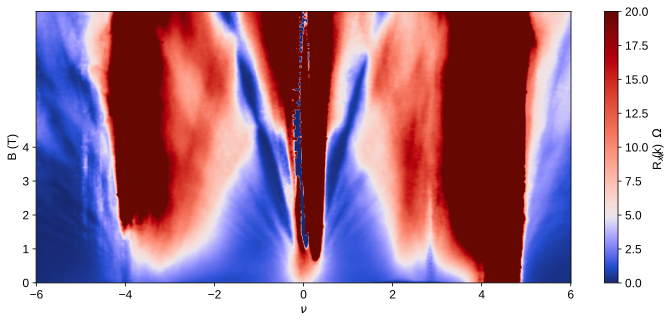

In [382]:
x = np.linspace(-6, 6, 1000)
y = np.linspace(0, 8, 1000)

cdiff = TwoSlopeNorm(vmin=0, vmax=20, vcenter=5)
plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, gaussian_filter(R2021func(x, y).T/1000, (1.1, 1.1)), cmap=cc.cm.diverging_bwr_20_95_c54, norm=cdiff, rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.xlabel(r'$\nu$')
plt.ylabel('B (T)')
# plt.xlim((-4, 4))
plt.yticks(range(0, 5))
# plt.xticks(range(-4, 5), [-4, '', '', '', 0, '', '', '', 4])
# plt.ylim((0, 4))

# sl, b = (9.83756187677379, 0)
# Vgatefull = 7.5806711186557765
# slfill = sl*Vgatefull/4

# Bl = 3.4
# Bs = 2.75
# for i in [-8, -6, -4, -2, 2, 4, 6, 8]:
#     x = np.array([(Bs*i - b)/slfill, (Bl*i - b)/slfill])
#     plt.plot(x, (x*slfill + b)/i, color='white', lw=0.6)
# plt.savefig(figfile + 'M05_fanto8T_full.svg', dpi=300, bbox_inches='tight')

## Additional fan for contacts 20-19

In [383]:
d2019fan = qc.load_data('data/2019-10-13/#005_M05_21-20and20-19_LandauFan_attempt3_14-15-09')
g2019fan = d2021fan.srframe_volt_p1_set[0, 10:]
b2019fan = d2021fan.triton_field_set_stable_set[:-1]
R2019fan = npd.Rxxfromdata(d2021fan, 0.2e-9, instrument='lockin830')[:-1, 10:]

In [384]:
np.min(R2019fan[R2019fan>0])

18.626599999999996

In [385]:
R2019fancorr = np.copy(R2019fan)
R2019fancorr[R2019fan <= 0] = np.min(R2019fan[R2019fan>0])

This one is a bit mixed up as well. It is either something around 0.97 degrees: (this fits the nu>4 fan better, but the half filling insulators aren't on target)

In [386]:
sl0 = 9.83756187677379
V0 = 1.250309168987657 - 0.15
V0f = 10.3
C = sl0*1.602e-19**2/6.626e-34
dBN = 3*8.85e-12/C
print('effective capacitance: {:.4e}'.format(C))
print('effective hBN thickness: {:.1f} nm'.format(dBN*10**9))
print('V0: ', V0)
Vgatefull = V0f - V0
print('Full filling voltage difference: {}'.format(Vgatefull))
nfull = (Vgatefull)*C/1.602e-19/10**4
print(nfull/10**12) #10**12 cm^-2
a = 0.246e-9

theta = np.sqrt(np.sqrt(3)*nfull*10**4*a**2/8)*180/np.pi
print('theta: ', theta)

nugate2019_1 = np.interp(g2019fan, [V0 - Vgatefull*8/4, V0 + Vgatefull*8/4], [-8, 8])

effective capacitance: 3.8103e-04
effective hBN thickness: 69.7 nm
V0:  1.1003091689876572
Full filling voltage difference: 9.199690831012344
2.1881232950683733
theta:  0.970127810366781


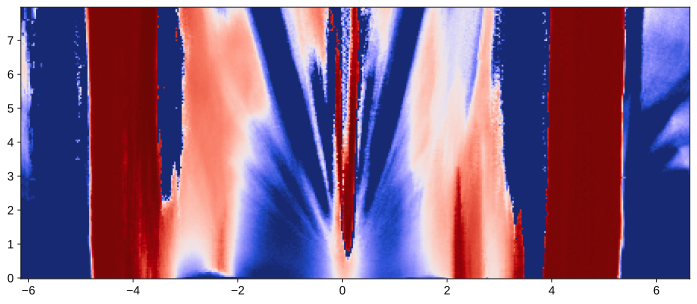

In [387]:
plt.figure(figsize=(12, 5))
plt.pcolormesh(nugate2019_1, b2019fan, R2019fancorr, cmap=cc.cm.diverging_bwr_20_95_c54, norm=npd.DivLogNorm(0.3, 1000, 2e5), rasterized=True)

Or it's something closer to 1.03 degrees (this one fits better with the insulators.

In [388]:
Vgatefull = 10.4
nfull = (Vgatefull)*C/1.602e-19/10**4
print(nfull/10**12) #10**12 cm^-2
a = 0.246e-9

theta = np.sqrt(np.sqrt(3)*nfull*10**4*a**2/8)*180/np.pi
print('theta: ', theta)

nugate2019_2 = np.interp(g2019fan, [V0 - Vgatefull*8/4, V0 + Vgatefull*8/4], [-8, 8])

2.473613807976951
theta:  1.0314757162607469


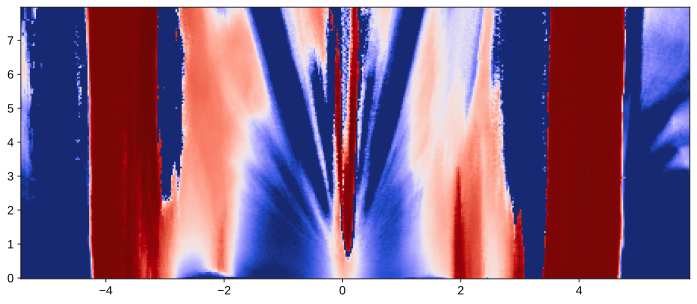

In [389]:
plt.figure(figsize=(12, 5))
plt.pcolormesh(nugate2019_2, b2019fan, R2019fancorr, cmap=cc.cm.diverging_bwr_20_95_c54, norm=npd.DivLogNorm(0.3, 1000, 2e5), rasterized=True)

## T dependence

In [390]:
m05Tb = qc.load_data('data/2020-01-12/#005_M05_21-20_basetemp_-1mT_1nA_15-10-53')
m05T1 = qc.load_data('data/2020-01-13/#003_M05_21-20_865_1nAexcitation_to1K_-1mT_12-12-20')
m05T2 = qc.load_data('data/2020-01-13/#004_M05_21-20_865_1nAexcitation_1p05to1p4K_-1mT_17-31-12')
m05T3 = qc.load_data('data/2020-01-13/#005_M05_21-20_865_1nAexcitation_to1p45to2K_-1mT_19-38-48')
m05T4 = qc.load_data('data/2020-01-13/#006_M05_21-20_865_1nAexcitation_to2p2to10K_-1mT_23-43-24')
m05T5 = qc.load_data('data/2020-01-14/#001_M05_21-20_865_1nAexcitation_to11to30K_-1mT_11-03-42')
m05T6 = qc.load_data('data/2020-01-15/#001_M05_21-20_865_1nAexcitation_to30to40K_-1mT_08-20-52')

Tsm05 = np.concatenate(([0.025], m05T1.triton_pid_setpoint_set[:], m05T2.triton_pid_setpoint_set[:], m05T3.triton_pid_setpoint_set[:], m05T4.triton_pid_setpoint_set[:], m05T5.triton_pid_setpoint_set[:], m05T6.triton_pid_setpoint_set[1:]))
gm05T = m05Tb.srframe_volt_p1_set[:]
V0T = V0 + 0.34
num05T = np.interp(gm05T, [V0T - Vgatefull*6/4, V0T + Vgatefull*6/4], [-6, 6])
Rm05T = np.vstack((npd.Rxxfromdata(m05Tb, 1e-9), npd.Rxxfromdata(m05T1, 1e-9), npd.Rxxfromdata(m05T2, 1e-9), npd.Rxxfromdata(m05T3, 1e-9), npd.Rxxfromdata(m05T4, 1e-9), npd.Rxxfromdata(m05T5, 1e-9), npd.Rxxfromdata(m05T6, 1e-9)[1:, :]))

In [391]:
RTm05func = RectBivariateSpline(num05T, Tsm05, Rm05T.T, kx=1, ky=1)

([<matplotlib.axis.YTick at 0x7ff467fd4370>,
 [Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, '')])

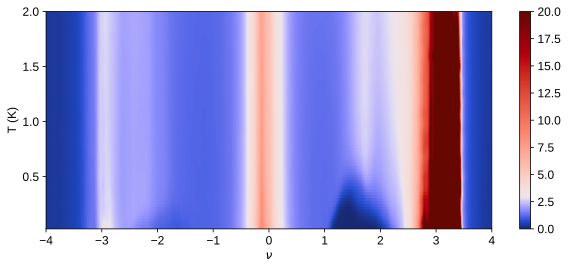

In [394]:
x = np.linspace(-6, 6, 1000)
y = np.linspace(0.025, 40, 1500)

plt.figure(figsize=(10, 4))
plt.pcolormesh(x, y, gaussian_filter(RTm05func(x, y).T, (1.2, 1.2))/1000, cmap=cc.cm.diverging_bwr_20_95_c54, norm=TwoSlopeNorm(vmin=0, vmax=20, vcenter=3), rasterized=True)
plt.xlim(-4, 4)
plt.ylim(0.025, 2)
plt.colorbar()
plt.xlabel('$\\nu$')
plt.ylabel('T (K)')
plt.yticks([0.5, 1, 1.5, 2])
# plt.savefig(figfile + 'M05_Tto2K.svg', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'T (K)')

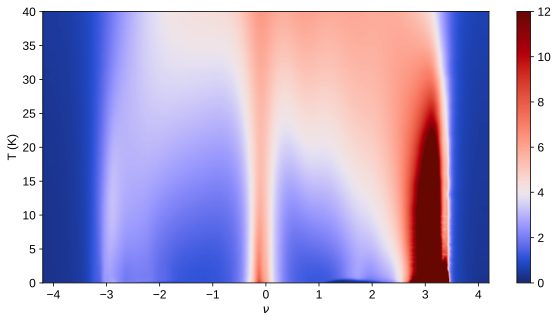

In [393]:
x = np.linspace(-6, 6, 1000)
y = np.linspace(0.025, 40, 800)

plt.figure(figsize=(10, 5))
plt.pcolormesh(x, y, gaussian_filter(RTm05func(x, y).T, (1.2, 1.2))/1000, cmap=cc.cm.diverging_bwr_20_95_c54, norm=TwoSlopeNorm(vmin=0, vmax=12, vcenter=4), rasterized=True)
plt.xlim(-4.2, 4.2)
plt.colorbar()
plt.xlabel('$\\nu$')
plt.ylabel('T (K)')
# plt.yticks([0.5, 1, 1.5, 2])
# plt.savefig(figfile + 'M05_Tto40K.svg', dpi=300, bbox_inches='tight')

## M05 0.87$^\circ$ Near CNP

In [395]:
num05T[112]

-0.09242660345679177

(-0.2, 10.0)

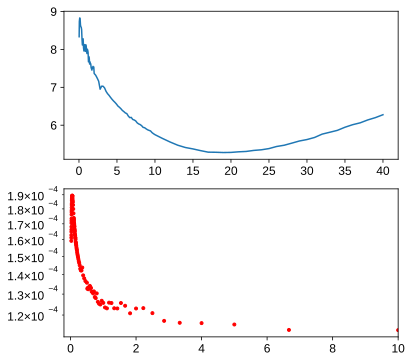

In [396]:
fig, ax = plt.subplots(2, 1, figsize=(6, 6))
ax[0].plot(Tsm05, Rm05T[:, 111]/1000)
ax[1].semilogy(1/Tsm05, 1/Rm05T[:, 111], '.r')
ax[1].set_xlim(-0.2, 10)

## Fraunhofer

In [397]:
# at 5.1V
m05fd = qc.load_data('data/2020-01-12/#007_M05_21-20_865_Fraunhofer_vbg=5.1V_AC1nAdvdi_baseT_23-22-02')
m05b = m05fd.triton_field_set_stable_set[:]
m05I = m05fd.srframe_volt_p5_set[0, :]*10  # in nA
m05R = m05fd.lockin865_X[:, :]/1e-9

Text(0, 0.5, 'B (mT)')

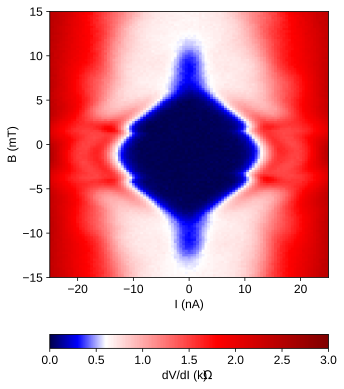

In [399]:
plt.figure(figsize=(5, 7))
plt.pcolormesh(m05I, m05b*1000, m05R/1000, rasterized=True, cmap='seismic', norm=TwoSlopeNorm(vmin=0, vmax=3, vcenter=0.6))
plt.axis((-25, 25, -15, 15))
plt.colorbar(orientation='horizontal', label='dV/dI (k$\Omega$)')
plt.xlabel('I (nA)')
plt.ylabel('B (mT)')
# plt.savefig(figfile + 'M05_fraunhofer_5p1V.svg', dpi=300, bbox_inches='tight')

# Other Fraunhofers

## Different fraunhofers for M20

### 0.87 degrees

In [400]:
dfraun3 = qc.load_data('data/2019-12-02/#004_M20_14-15_865_21-16_830_Bsweep_vbg=2.3V_AC0.5nAdvdi_baseT_16-48-56')
dvdi1415 = dfraun3.lockin865_X[:, :]/0.5e-9 #converted in resistence 
bfraun1415 = dfraun3.triton_field_set_stable_set[:]*1000 + 1.9
ifraun1415 = dfraun3.srframe_volt_p5_set[0, :]*10

In [401]:
# looked it up, and this is correct:
vgate1415 = 2.3
Vgatefull1514 = 4.232980388741174
V01514 = 0.25876000000000016 - 0.03
nufraun1514 = np.interp(vgate1415, [V01514 - Vgatefull1514*6/4, V01514 + Vgatefull1514*6/4], [-6, 6])
print('nu = {}'.format(nufraun1514))

nu = 1.957240345841484


In [402]:
2.5*2/3

1.6666666666666667

Text(0, 0.5, 'B (mT)')

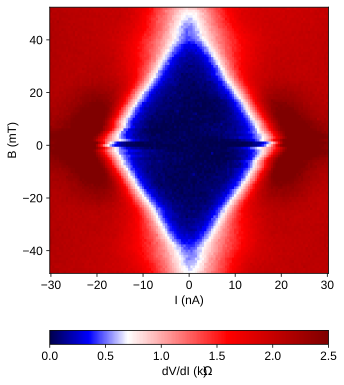

In [404]:
plt.figure(figsize=(5, 7))
plt.pcolormesh(ifraun1415, bfraun1415, dvdi1415/1000, rasterized=True, cmap='seismic', norm=TwoSlopeNorm(vmin=0, vmax=2.5, vcenter=0.7))
plt.colorbar(orientation='horizontal', label='dV/dI (k$\Omega$)')
plt.xlabel('I (nA)')
plt.ylabel('B (mT)')
# plt.axis((10, 25, -10, 10))

### 0.79 degrees

In [405]:
dfraun2 = qc.load_data('data/2019-12-04/#004_M20_21-16_865_16-15_830_Bsweep_vbg=2.3V_AC0.5nAdvdi_baseT_17-25-59')
dvdi2116 = dfraun2.lockin865_X[:, :]/0.5e-9
bfraun2116 = dfraun2.triton_field_set_stable_set[:]*1000 + 1.6
ifraun2116 = dfraun2.srframe_volt_p5_set[0, :]*10

In [406]:
# also checked this.
vgate2116 = 2.3
Vgatefull = 3.495599272009696
V0 = 0.26212986965138396 + 0.03
nufraun2116 = np.interp(vgate2116, [V0 - Vgatefull*6/4, V0 + Vgatefull*6/4], [-6, 6])
print(nufraun2116)

2.2975976067122215


Text(0, 0.5, 'B (mT)')

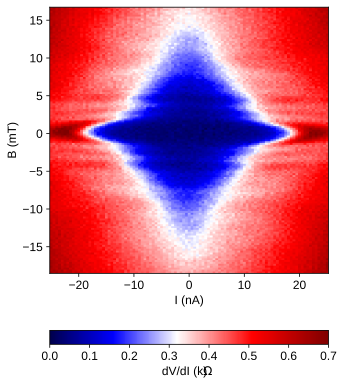

In [407]:
plt.figure(figsize=(5, 7))
plt.pcolormesh(ifraun2116, bfraun2116, dvdi2116/1000, rasterized=True, cmap='seismic', norm=TwoSlopeNorm(vmin=0, vmax=0.7, vcenter=0.32))
plt.colorbar(orientation='horizontal', label='dV/dI (k$\Omega$)')
plt.xlabel('I (nA)')
plt.ylabel('B (mT)')
# plt.axis((-25, -15, -10, 10))

### 0.83 degrees

In [408]:
mfraun1 = qc.load_data('data/2019-12-10/#001_M20_16-15_865_16-45_830_Bsweep_vbg=2.3V_AC0.5nAdvdi_baseT_01-56-24')
mfI1 = mfraun1.srframe_volt_p5_set[0, :]*10 # in nA
mfB1 = mfraun1.triton_field_set_stable_set[:]*1000 + 0.6
mfR1 = mfraun1.lockin865_X[:, :]/0.5e-9

#inset
mfraun2 = qc.load_data('data/2019-12-10/#002_M20_15-16_865_16-45_830_Bsweep_vbg=2.3V_AC0.5nAdvdi_baseT_zoominaround0_10-09-20')
mfI2 = mfraun2.srframe_volt_p5_set[0, :]*10 # in nA
mfB2 = mfraun2.triton_field_set_stable_set[:]*1000 + 0.6
mfR2 = mfraun2.lockin865_X[:, :]/0.5e-9

In [409]:
len(mfB1)

151

In [410]:
Vgate3 = 2.3
Vgatefull1615 = 3.938
V01615 = V01514 + 0.02
fillingfraun1615 = np.interp(Vgate3, [V01615 - Vgatefull1615*6/4, V01615 + Vgatefull1615*6/4], [-6, 6])
print(fillingfraun1615)

2.083534789233113


In [411]:
mf1func = RectBivariateSpline(mfI1[::-1], mfB1[::-1], np.flip(np.flip(mfR1, axis=1), axis=0).T, kx=1, ky=1)

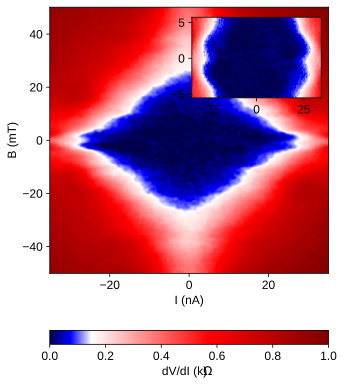

In [412]:
x = np.linspace(-35, 35, 300)
y = np.linspace(-50, 50, 400)
plt.figure(figsize=(5, 7))
plt.pcolormesh(x, y, gaussian_filter(mf1func(x, y).T, (1.2, 1.2))/1000, rasterized=True, cmap='seismic', norm=TwoSlopeNorm(vmin=0, vmax=1, vcenter=0.15))
# plt.axis((-25, 25, -15, 15))
plt.colorbar(orientation='horizontal', label='dV/dI (k$\Omega$)')
plt.xlabel('I (nA)')
plt.ylabel('B (mT)')

ax = plt.axes([0.52, 0.7, 0.36, 0.16])
ax.pcolormesh(mfI2, mfB2, mfR2/1000, rasterized=True, cmap='seismic', norm=TwoSlopeNorm(vmin=0, vmax=1, vcenter=0.15))
plt.savefig(figfile + 'M20_0p83_fraunhofer_withinset.svg', dpi=300, bbox_inches='tight')

In [413]:
mfraun3 = qc.load_data('data/2019-12-04/#004_M20_21-16_865_16-15_830_Bsweep_vbg=2.3V_AC0.5nAdvdi_baseT_17-25-59')
mfI3 = mfraun3.srframe_volt_p5_set[0, :]*10 # in nA
mfB3 = mfraun3.triton_field_set_stable_set[:]
mfR3 = mfraun3.lockin830_X[:, :]/0.5e-9

Text(0, 0.5, 'B (mT)')

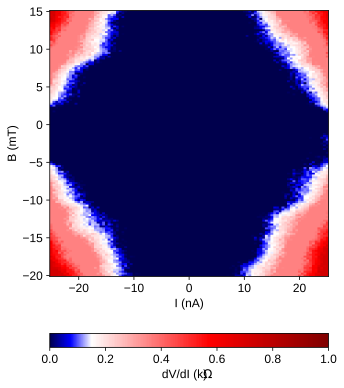

In [414]:
# I'll put this here just in case someone complains about the resistance not being zero in the previous plot.
plt.figure(figsize=(5, 7))
plt.pcolormesh(mfI3, mfB3*1000, mfR3/1000, rasterized=True, cmap='seismic', norm=TwoSlopeNorm(vmin=0, vmax=1, vcenter=0.15))
# plt.axis((-25, 25, -15, 15))
plt.colorbar(orientation='horizontal', label='dV/dI (k$\Omega$)')
plt.xlabel('I (nA)')
plt.ylabel('B (mT)')

0.87 degrees

In [415]:

mfraun4 = qc.load_data('data/2019-12-02/#004_M20_14-15_865_21-16_830_Bsweep_vbg=2.3V_AC0.5nAdvdi_baseT_16-48-56')
mfI4 = mfraun4.srframe_volt_p5_set[0, :]*10 # in nA
mfB4 = mfraun4.triton_field_set_stable_set[:]
mfR4 = mfraun4.lockin865_X[:, :]/0.5e-9

In [416]:
mf4func = RectBivariateSpline(mfI4[::-1], mfB4[::-1]*1000, np.flip(np.flip(mfR4, axis=1), axis=0).T, kx=1, ky=1)

(-30.0, 30.0, -15.0, 15.0)

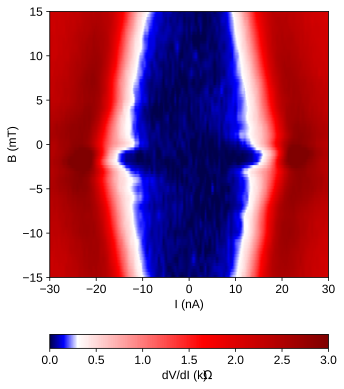

In [417]:
x = np.linspace(-30, 30, 300)
y = np.linspace(-50, 50, 300)

plt.figure(figsize=(5, 7))
plt.pcolormesh(x, y, mf4func(x, y).T/1000, rasterized=True, cmap='seismic', norm=TwoSlopeNorm(vmin=0, vmax=3, vcenter=0.3))
# plt.axis((-25, 25, -15, 15))
plt.colorbar(orientation='horizontal', label='dV/dI (k$\Omega$)')
plt.xlabel('I (nA)')
plt.ylabel('B (mT)')
plt.axis((-30, 30, -15, 15))
# plt.savefig(figfile + 'M20_0p87_zoomfraunhofer.svg', dpi=300, bbox_inches='tight')

## Different fraunhofers for M08

First the electron-side fraunhofer pattern

The fig1 fraunhofer

In [418]:
dfraun3837 = qc.load_data('data/2019-10-07/#003_M08_Rxx38-37_Rxy38-44_Bsweep_vbg=-4.2V_AC0.5nAdvdi_baseT_coarse_19-36-45')
dvdi3837 = dfraun3837.lockin865_X[:, :]/0.5e-9
bfraun3837 = dfraun3837.triton_field_set_stable_set[:]*1000 + 1.4
ifraun3837 = dfraun3837.srframe_volt_p5_set[0, :]*10

Find the filling factor with this:

In [419]:
Vgatefull = 8.081768748385855
V0temp = 0.65
# filling3837_T = np.interp(Tgates3837, [V0temp - Vgatefull*6/4, V0temp + Vgatefull*6/4], [-6, 6])

In [420]:
Vgate0 = -4.2
filling0 = np.interp(Vgate0, [V0temp - Vgatefull*6/4, V0temp + Vgatefull*6/4], [-6, 6])
print(filling0)

-2.4004646264933895


Text(0, 0.5, 'B (mT)')

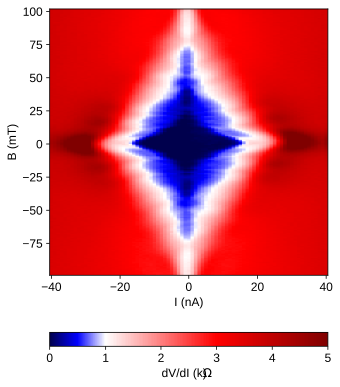

In [422]:
plt.figure(figsize=(5, 7))
plt.pcolormesh(ifraun3837, bfraun3837, dvdi3837/1000, rasterized=True, cmap='seismic', norm=TwoSlopeNorm(vmin=0, vmax=5, vcenter=1))
plt.colorbar(orientation='horizontal', label='dV/dI (k$\Omega$)')
plt.xlabel('I (nA)')
plt.ylabel('B (mT)')
# plt.axis((-25, -15, -10, 10))

Extended Data Fig Fraunhofers

In [423]:
Vgate1 = 3.85
filling1 = np.interp(Vgate1, [V0temp - Vgatefull*6/4, V0temp + Vgatefull*6/4], [-6, 6])
print(filling1)  # this is nu for this device

1.5838117123255353


In [424]:
d8fraun1 = qc.load_data('data/2019-10-08/#007_M08_Rxx38-37_Rxy38-44_Bsweep_vbg=3.85V_AC0.1nAdvdi_baseT_coarse_15-22-32')

d8fI1 = d8fraun1.srframe_volt_p5_set[0, :]*10
d8fB1 = d8fraun1.triton_field_set_stable_set[:]*1000
d8fR1 = d8fraun1.lockin865_X[:, :]/0.1e-9

In [425]:
d8fRfunc = RectBivariateSpline(d8fI1[::-1], d8fB1[::-1], np.flip(np.flip(d8fR1, axis=1), axis=0).T, kx=1, ky=1)

Text(0, 0.5, 'B (mT)')

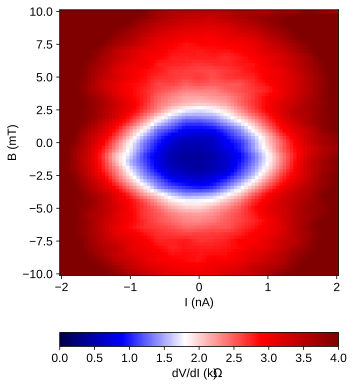

In [427]:
x = np.linspace(-2, 2, 80)
y = np.linspace(-10, 10, 80)

plt.figure(figsize=(5, 7))
plt.pcolormesh(x, y, d8fRfunc(x, y).T/1000, rasterized=True, cmap='seismic', norm=TwoSlopeNorm(vmin=0, vmax=4, vcenter=1.8))
plt.colorbar(orientation='horizontal', label='dV/dI (k$\Omega$)')
plt.xlabel('I (nA)')
plt.ylabel('B (mT)')
# plt.savefig(figfile + 'M08_fraunhofer_elsidenu=1p58_seismic.svg', dpi=300, bbox_inches='tight')

Now hole side

In [428]:
Vgate2 = -3.6
filling2 = np.interp(Vgate2, [V0temp - Vgatefull*6/4, V0temp + Vgatefull*6/4], [-6, 6])
print(filling2)  # this is nu for this device

-2.1034999304323514


In [429]:
d8fraun2 = qc.load_data('data/2019-10-08/#001_M08_Rxx38-37_Rxy38-44_Bsweep_vbg=-3.6V_AC0.5nAdvdi_baseT_coarse_02-34-19')
d8fI2 = d8fraun2.srframe_volt_p5_set[0, :]*10
d8fB2 = d8fraun2.triton_field_set_stable_set[:]*1000
d8fR2 = d8fraun2.lockin865_X[:, :]/0.5e-9

In [430]:
d8fR2func = RectBivariateSpline(d8fI2[::-1], d8fB2[::-1], np.flip(np.flip(d8fR2, axis=1), axis=0).T, kx=1, ky=1)

Text(0, 0.5, 'B (mT)')

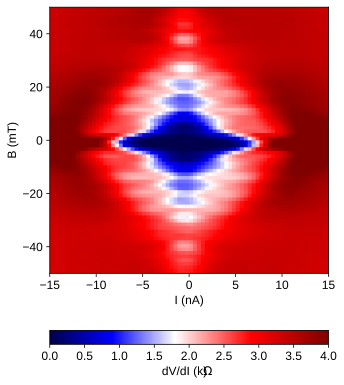

In [431]:
x = np.linspace(-25, 25, 120)
y = np.linspace(-80, 80, 120)

plt.figure(figsize=(5, 7))
plt.pcolormesh(x, y, d8fR2func(x, y).T/1000, rasterized=True, cmap='seismic', norm=TwoSlopeNorm(vmin=0, vmax=4, vcenter=1.8))
plt.colorbar(orientation='horizontal', label='dV/dI (k$\Omega$)')
plt.axis((-15, 15, -50, 50))
plt.xlabel('I (nA)')
plt.ylabel('B (mT)')
# plt.savefig(figfile + 'M08_fraunhofer_holesidenu=-2p10_seismic.svg', dpi=300, bbox_inches='tight')

In [432]:
Vgate3 = -4.4
filling3 = np.interp(Vgate3, [V0temp - Vgatefull*6/4, V0temp + Vgatefull*6/4], [-6, 6])
print(filling3)  # this is nu for this device

-2.499452858513736


In [433]:
d8fraun3 = qc.load_data('data/2019-10-08/#008_M08_Rxx38-37_Rxy38-44_Bsweep_vbg=-4.4V_AC0.5nAdvdi_baseT_coarse_16-31-25')
d8fI3 = d8fraun3.srframe_volt_p5_set[0, :]*10
d8fB3 = d8fraun3.triton_field_set_stable_set[:]*1000
d8fR3 = d8fraun3.lockin865_X[:, :]/0.5e-9

In [434]:
d8fR3func = RectBivariateSpline(d8fI3[::-1], d8fB3[::-1], np.flip(np.flip(d8fR3, axis=1), axis=0).T, kx=1, ky=1)

Text(0, 0.5, 'B (mT)')

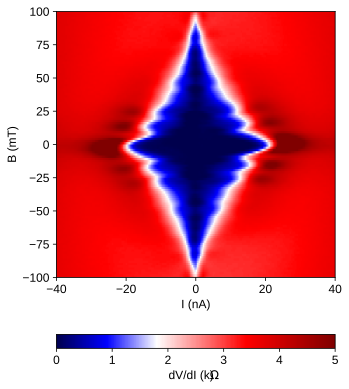

In [435]:
x = np.linspace(-40, 40, 200)
y = np.linspace(-100, 100, 120)

plt.figure(figsize=(5, 7))
plt.pcolormesh(x, y, d8fR3func(x, y).T/1000, rasterized=True, cmap='seismic', norm=TwoSlopeNorm(vmin=0, vmax=5, vcenter=1.8))
plt.colorbar(orientation='horizontal', label='dV/dI (k$\Omega$)')
plt.axis((-40, 40, -100, 100))
plt.xlabel('I (nA)')
plt.ylabel('B (mT)')
# plt.savefig(figfile + 'M08_fraunhofer_holesidenu=-2p50_seismic.svg', dpi=300, bbox_inches='tight')

## Fraunhofer for M12

In [436]:
# despite the name of this dataset, this is M12, both lockins are measuring the same contacts
d12fraun1 = qc.load_data('data/2019-11-11/#002_M08_12-13_865_22-20_830_Bsweep_vbg=-4.03V_AC0.2nAdvdi_baseT_coarse_16-05-47')

d12fI1 = d12fraun1.srframe_volt_p5_set[0, :]*10
d12fB1 = d12fraun1.triton_field_set_stable_set[:]*1000
d12fR1 = d12fraun1.lockin865_X[:, :]/0.2e-9

d12fR2 = d12fraun1.lockin830_X[:, :]/0.2e-9

The filling factor from the voltage:

In [437]:
Vgfull2022 = 6.38454649743731
V0ind = np.argmax(Rxx2022Tcorr[40, 200:220])
V0 = gateT2022[200 + V0ind]
vgatef = -4.03
fillingfraun = np.interp(vgatef, [V0 - Vgfull2022*7/4, V0 + Vgfull2022*7/4], [-7, 7])
print(fillingfraun)

-2.775451632643388


In [438]:
d12fR2func = RectBivariateSpline(d12fI1[::-1], d12fB1[::-1], np.flip(np.flip(d12fR2, axis=1), axis=0).T, kx=1, ky=1)

In [439]:
## lockin830 looks better
# x = np.linspace(-30, 30, 200)
# y = np.linspace(-100, 100, 120)

# plt.figure(figsize=(5, 7))
# plt.pcolormesh(x, y, d12fR1func(x, y).T/1000, rasterized=True, cmap='seismic', norm=TwoSlopeNorm(vmin=0, vmax=4.5, vcenter=1.8))
# plt.colorbar(orientation='horizontal', label='dV/dI (k$\Omega$)')
# # plt.axis((-40, 40, -100, 100))
# plt.xlabel('I (nA)')
# plt.ylabel('B (mT)')
# plt.savefig(figfile + 'M12_fraunhofer_holeside.svg', dpi=300, bbox_inches='tight')

In [440]:
len(d12fB1)

201

Text(0, 0.5, 'B (mT)')

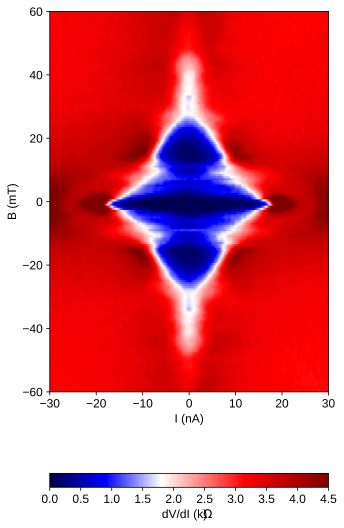

In [442]:
x = np.linspace(-30, 30, 250)
y = np.linspace(-100, 100, 300)

plt.figure(figsize=(5, 10))
plt.pcolormesh(x, y, d12fR2func(x, y).T/1000, rasterized=True, cmap='seismic', norm=TwoSlopeNorm(vmin=0, vmax=4.5, vcenter=1.8))
plt.colorbar(orientation='horizontal', label='dV/dI (k$\Omega$)')
plt.axis((-30, 30, -60, 60))
plt.xlabel('I (nA)')
plt.ylabel('B (mT)')
# plt.savefig(figfile + 'M12_fraunhofer_holeside.svg', dpi=300, bbox_inches='tight')

Note that, in some of the plots of R in gate vs. field, we find interesting peaks. However, we don't understand it.

#  Low-field Hall effect measurements

## 0.97

I need to try extracting something from a single field direction. Just 200 mT - 0 mT

In [443]:
d3844 = qc.load_data('data/2019-10-06/#003_0to8TtwodSweep_0.5nAexcM08_Rxx38-37_Rxy38-44_basetemp_161fieldpts_16-35-30')
g3844 = d3844.srframe_volt_p1_set[0, :]
b3844 = d3844.triton_field_set_stable_set[:]
Rxy3844 = d3844.lockin830_X[:, :]/0.5e-9

b3844

array([0.  , 0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 ,
       0.55, 0.6 , 0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95, 1.  , 1.05,
       1.1 , 1.15, 1.2 , 1.25, 1.3 , 1.35, 1.4 , 1.45, 1.5 , 1.55, 1.6 ,
       1.65, 1.7 , 1.75, 1.8 , 1.85, 1.9 , 1.95, 2.  , 2.05, 2.1 , 2.15,
       2.2 , 2.25, 2.3 , 2.35, 2.4 , 2.45, 2.5 , 2.55, 2.6 , 2.65, 2.7 ,
       2.75, 2.8 , 2.85, 2.9 , 2.95, 3.  , 3.05, 3.1 , 3.15, 3.2 , 3.25,
       3.3 , 3.35, 3.4 , 3.45, 3.5 , 3.55, 3.6 , 3.65, 3.7 , 3.75, 3.8 ,
       3.85, 3.9 , 3.95, 4.  , 4.05, 4.1 , 4.15, 4.2 , 4.25, 4.3 , 4.35,
       4.4 , 4.45, 4.5 , 4.55, 4.6 , 4.65, 4.7 , 4.75, 4.8 , 4.85, 4.9 ,
       4.95, 5.  , 5.05, 5.1 , 5.15, 5.2 , 5.25, 5.3 , 5.35, 5.4 , 5.45,
       5.5 , 5.55, 5.6 , 5.65, 5.7 , 5.75, 5.8 , 5.85, 5.9 , 5.95, 6.  ,
       6.05, 6.1 , 6.15, 6.2 , 6.25, 6.3 , 6.35, 6.4 , 6.45, 6.5 , 6.55,
       6.6 , 6.65, 6.7 , 6.75, 6.8 , 6.85, 6.9 , 6.95, 7.  , 7.05, 7.1 ,
       7.15, 7.2 , 7.25, 7.3 , 7.35, 7.4 , 7.45, 7.

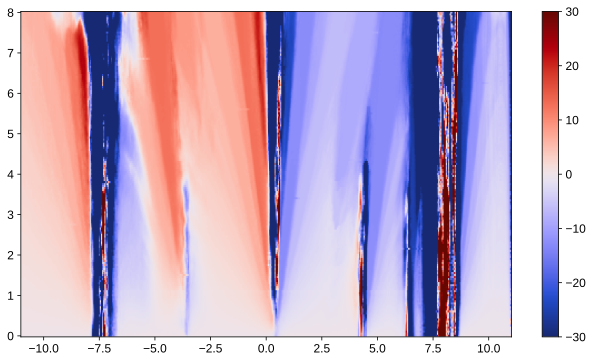

In [446]:
plt.figure(figsize=(11, 6))
plt.pcolormesh(g3844, b3844, Rxy3844/1000, cmap=cc.cm.diverging_bwr_20_95_c54, norm=TwoSlopeNorm(0, -30, 30), rasterized=True)
plt.colorbar()
# plt.xlim(-1, 1)

In [447]:
nH3844 = -500e-3/(1.602e-19*gaussian_filter((Rxy3844[10, :] - Rxy3844[0, :]), 1))/10**16
nH3844_7 = -7/(1.602e-19*gaussian_filter((Rxy3844[-21, :] - Rxy3844[0, :]), 1))/10**16

V03837 = 0.35
gfull3837 = 8.081768748385855
filling3837 = np.interp(g3844, [V03837 - 6/4*gfull3837, V03837 + 6/4*gfull3837], [-6, 6])

In [448]:
len(filling3837)

441

(-0.1, 0.1)

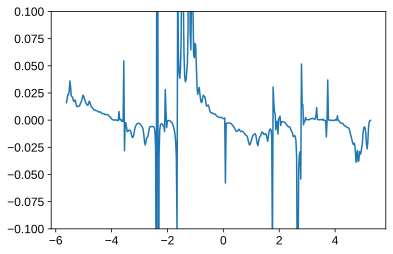

In [449]:

plt.figure()
plt.plot(filling3837, 1/gaussian_filter((Rxy3844[1, :] - Rxy3844[0, :]), 1))
plt.ylim(-.1, .1)

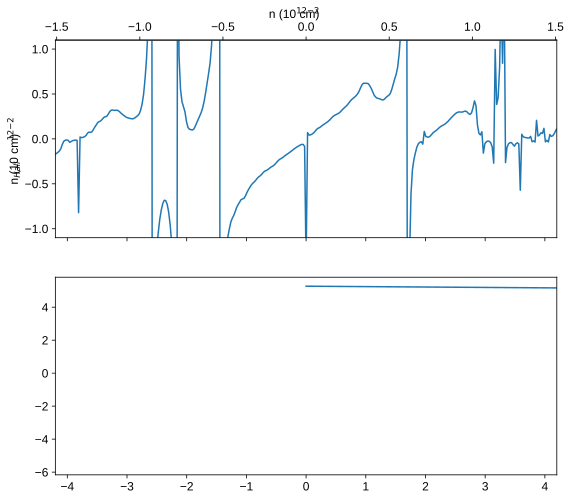

In [450]:
fig, ax = plt.subplots(2, 1, figsize=(9, 8), sharex=True)

def nuton(nu):
    return nu*1.4361284978831588/4  # returns density in 10^12 cm^-2

def ntonu(n):
    return n*4/1.4361284978831588

ax[0].plot(filling3837, nH3844)
ax[0].set_ylabel('n$_{Hall}$ (10$^{12}$ cm$^{-2}$)')
ax[0].set_ylim(-1.1, 1.1)
ax[0].set_xlim(-4.2, 4.2)
axt = ax[0].secondary_xaxis('top', functions=(nuton, ntonu))
axt.set_xlabel('n (10$^{12}$ cm$^{-2}$)')

ax[1].plot(filling3837, )

(-4.2, 4.2)

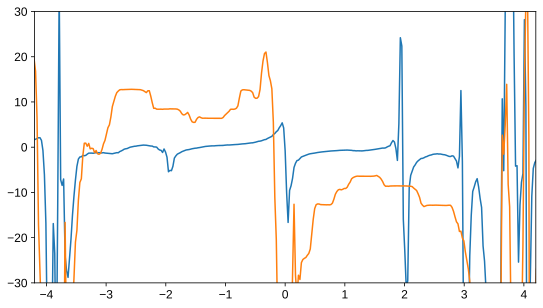

In [451]:
plt.figure(figsize=(9, 5))
plt.plot(filling3837, Rxy3844[10, :]/1000)
plt.plot(filling3837, Rxy3844[-21, :]/1000)
plt.ylim(-30, 30)
plt.xlim(-4.2, 4.2)

(-4.2, 4.2)

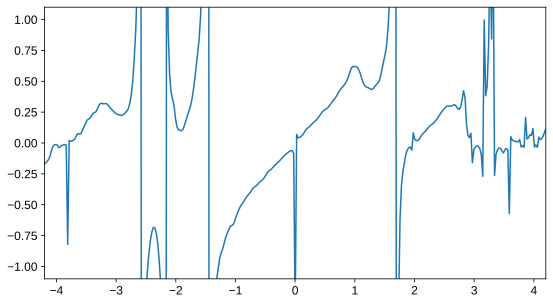

In [452]:
plt.figure(figsize=(9, 5))
plt.plot(filling3837, nH3844)
# plt.plot(filling3837, nH3844_7)
plt.ylim(-1.1, 1.1)
plt.xlim(-4.2, 4.2)

## 1.04 degrees

Only a single field direction here too 200 mT - 0

In [453]:
d2212 = qc.load_data('data/2019-11-10/#001_M12_22_20and22_12xy_LandauFan_5nA_-8Tto0T_14-20-38')

g2212 = d2212.srframe_volt_p1_set[0, :]
b2212 = d2212.triton_field_set_stable_set[:]
Rxy2212 = d2212.lockin830_X[:, :]/5e-9

b2212

array([-8. , -7.9, -7.8, -7.7, -7.6, -7.5, -7.4, -7.3, -7.2, -7.1, -7. ,
       -6.9, -6.8, -6.7, -6.6, -6.5, -6.4, -6.3, -6.2, -6.1, -6. , -5.9,
       -5.8, -5.7, -5.6, -5.5, -5.4, -5.3, -5.2, -5.1, -5. , -4.9, -4.8,
       -4.7, -4.6, -4.5, -4.4, -4.3, -4.2, -4.1, -4. , -3.9, -3.8, -3.7,
       -3.6, -3.5, -3.4, -3.3, -3.2, -3.1, -3. , -2.9, -2.8, -2.7, -2.6,
       -2.5, -2.4, -2.3, -2.2, -2.1, -2. , -1.9, -1.8, -1.7, -1.6, -1.5,
       -1.4, -1.3, -1.2, -1.1, -1. , -0.9, -0.8, -0.7, -0.6, -0.5, -0.4,
       -0.3, -0.2, -0.1,  0. ])

In [454]:
nH2212 = 1/1.602e-19*200e-3/gaussian_filter((Rxy2212[-1, :] - Rxy2212[-3, :]), 1)/10**16

(-2.0, 2.0)

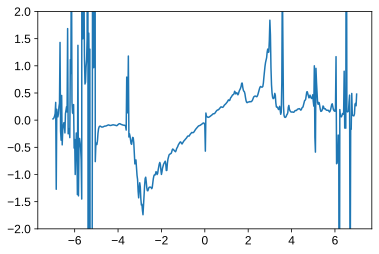

In [455]:
plt.figure()
plt.plot(g2212, nH2212)
plt.ylim(-2, 2)

## 0.79-0.83 degree measurements

### a failed attempt at an Rxy dataset.

It looks like this data was the result of a problem with the measurement setup

In [456]:
# disregard this dataset. Look at the one below

d1645p = qc.load_data('data/2019-12-10/#009_M20_16-45_865_21-45_830_Rxy-vbgsweep_2nA_200mT_20-02-14')
d1645n = qc.load_data('data/2019-12-10/#010_M20_16-45_865_21-45_830_Rxy-vbgsweep_2nA_-200mT_22-13-13')

g1645H = d1645p.srframe_volt_p1_set[:]
Rxy1645Hp = d1645p.lockin865_X[:]/2e-9
Rxy1645Hn = d1645n.lockin865_X[:]/2e-9
Rxy2145Hp = d1645p.lockin830_X[:]/2e-9
Rxy2145Hn = d1645n.lockin830_X[:]/2e-9

nH = 1/1.602e-19*200e-3/gaussian_filter((Rxy1645Hp - Rxy1645Hn), 1)/10**16
nH2145 = 1/1.602e-19*400e-3/gaussian_filter((Rxy2145Hp-Rxy2145Hn), 1)/10**16

Vgatefull = 3.495599272009696
V0 = 0.26212986965138396 + 0.03
nu1645 = np.interp(g1645H, [V0 - Vgatefull*6/4, V0 + Vgatefull*6/4], [-6, 6])

Text(0, 0.5, 'n$_{Hall}$ (10$^{12}$ cm$^{-2}$)')

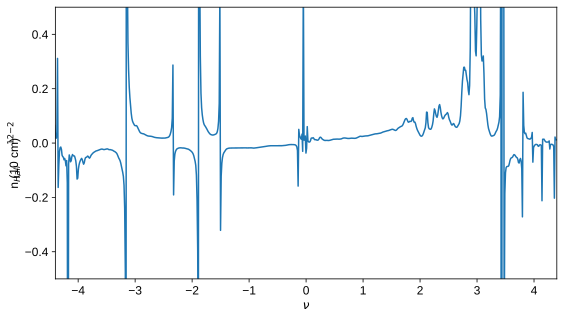

In [457]:
plt.figure(figsize=(9, 5))  # disregard this dataset
plt.plot(nu1645, nH)
plt.ylim(-0.5, 0.5)
plt.xlim(-4.4, 4.4)
plt.xlabel(r'$\nu$')
plt.ylabel('n$_{Hall}$ (10$^{12}$ cm$^{-2}$)')
# plt.savefig(figfile + 'nHall0p79deg_200mT_strange.png', dpi=300, bbox_inches='tight')

(-4.4, 4.4)

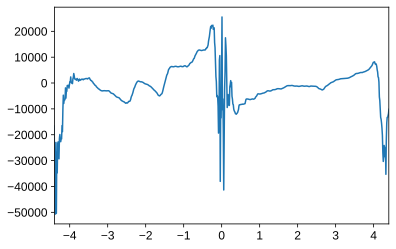

In [458]:
plt.figure()  # this doesn't look right.
plt.plot(nu1645, Rxy1645Hn)
# plt.ylim(-0.2, 0.2)
plt.xlim(-4.4, 4.4)

Perhaps there were problems with this given scan. It's not obvious why it decided to introduce sign changes in Rxy at this point but not before. See below for an example that looks more believable

### From the Rxy fan diagram (so lower resolution but higher field.)

In [460]:
drxy = qc.load_data('data/2019-12-05/#007_M20_865_21-45_830_16-45_Rxy_twodfan_0p5nA_22-32-09')  # note that at around 5T down, 21-45 was switched to 15-16

Rxy = drxy.lockin830_X[:, :]/0.5e-9
gxy = drxy.srframe_volt_p1_set[0, :]
Bxy = drxy.triton_field_set_stable_set[:]

In [461]:
Bxy[-11]  # use 0.5 T

0.5

In [462]:
esqh = 1.602e-19**2/6.626e-34

In [463]:
# Vgatefull = 3.8880000000000003  # is this from 0.83 degrees?
Vgatefull = 3.495599272009696
V0 = 0.296
nuxy = np.interp(gxy, [V0 - 6/4*Vgatefull, V0 + 6/4*Vgatefull], [-6, 6])

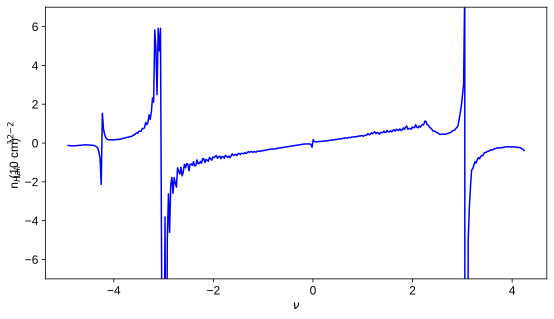

In [464]:
plt.figure(figsize=(9, 5))
plt.plot(nuxy, -0.5/(1.602e-19*gaussian_filter(Rxy[-11] - Rxy[-1], 1))/10**16, 'b')
# plt.plot(nuxy, -0.2/(1.602e-19*gaussian_filter(Rxy[-5] - Rxy[-1], 1))/10**16) # 0.2T
# plt.plot(nuxy, -1/(1.602e-19*gaussian_filter(Rxy[-21] - Rxy[-1], 1))/10**16) # 1T. They both agree with 0.5T
plt.ylim(-7, 7)
plt.xlabel(r'$\nu$')
plt.ylabel('n$_{Hall}$ (10$^{12}$ cm$^{-2}$)')
plt.savefig(figfile + 'nHall0p79deg_500mT.png', dpi=300, bbox_inches='tight')

Text(0, 0.5, 'R$_{xy}$ (k$\\Omega$)')

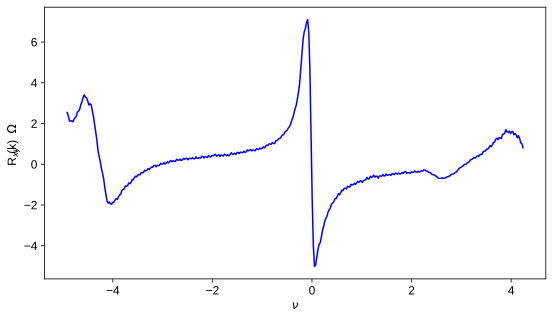

In [465]:
plt.figure(figsize=(9, 5))
plt.plot(nuxy, gaussian_filter(Rxy[-11]- Rxy[-1], 1)/1000, 'b')
# plt.plot(nuxy, -0.2/(1.602e-19*gaussian_filter(Rxy[-5] - Rxy[-1], 1))/10**16) # 0.2T
# plt.plot(nuxy, -1/(1.602e-19*gaussian_filter(Rxy[-21] - Rxy[-1], 1))/10**16) # 1T. They both agree with 0.5T
# plt.ylim(-1.7, 1.7)
plt.xlabel(r'$\nu$')
plt.ylabel('R$_{xy}$ (k$\Omega$)')
# plt.savefig(figfile + 'Rxy0p79deg_500mT.png', dpi=300, bbox_inches='tight')

In [466]:
fieldsfan1621[-6]

0.25

In [467]:
fieldsfan1621[-21]

1.0

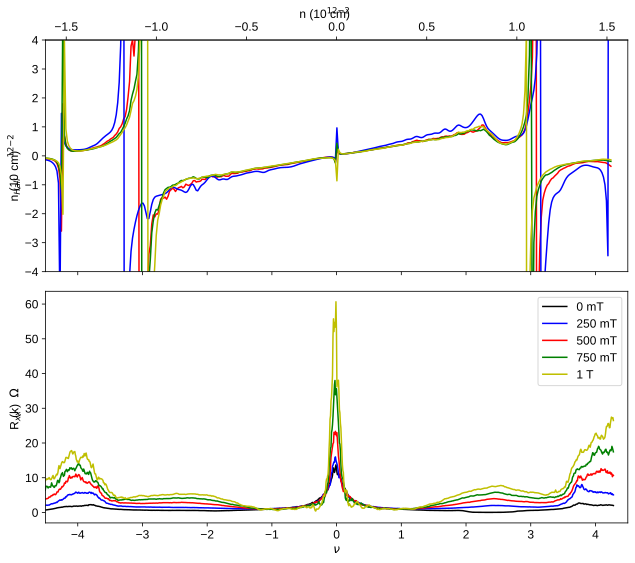

In [468]:
#Rxx measurements for the same general area (0.79 degrees)
fig, ax = plt.subplots(2, 1, figsize=(9, 8), sharex=True)
ax[0].plot(nuxy, -0.5/(1.602e-19*gaussian_filter(Rxy[-11] - Rxy[-1], 1.3))/10**16, 'r')
ax[0].plot(nuxy, -0.25/(1.602e-19*gaussian_filter(Rxy[-6] - Rxy[-1], 2))/10**16, 'b')
ax[0].plot(nuxy, -0.75/(1.602e-19*gaussian_filter(Rxy[-16] - Rxy[-1], 1.3))/10**16, 'g')
ax[0].plot(nuxy, -1/(1.602e-19*gaussian_filter(Rxy[-21] - Rxy[-1], 1.3))/10**16, 'y')
ax[0].set_ylabel('n$_{Hall}$ (10$^{12}$ cm$^{-2}$)')
ax[0].set_ylim(-4, 4)

def nuton(nu):
    return nu*1.4361284978831588/4  # returns density in 10^12 cm^-2

def ntonu(n):
    return n*4/1.4361284978831588

axt = ax[0].secondary_xaxis('top', functions=(nuton, ntonu))
axt.set_xlabel('n (10$^{12}$ cm$^{-2}$)')
ax[1].plot(filling1621, Rxx1621_2[-1, :]/1000, 'k')  # run the 0.87, 0.79 degree landau fans before this
ax[1].plot(filling1621, Rxx1621_2[-6, :]/1000, 'b')
ax[1].plot(filling1621, Rxx1621_2[-11, :]/1000, 'r')
ax[1].plot(filling1621, Rxx1621_2[-16, :]/1000, 'g')
ax[1].plot(filling1621, Rxx1621_2[-21, :]/1000, 'y')
ax[1].set_ylabel('R$_{xx}$ (k$\Omega$)')
ax[1].set_xlabel(r'$\nu$')
ax[1].set_xlim(-4.5, 4.5)
ax[1].legend(['0 mT', '250 mT', '500 mT', '750 mT', '1 T'])
plt.tight_layout()
# plt.savefig(figfile + 'M20_0p79deg_nhall_Rxx_fewfields.svg', dpi=300, bbox_inches='tight')

# Newer double-sided WSe$_2$ device, W5 0.80$^\circ$

## Electrodes 39-38

### Landau fan

In [469]:
dw5fan2 = qc.load_data('data/2020-02-03/#015_W5_865_39-38Rxx_830_38-37Rxx_baseT_2nA_B-Vgsweep_17-50-07')
gw5fan2 = dw5fan2.srframe_volt_p1_set[0, :]
bw5fan2 = dw5fan2.triton_field_set_stable_set[:]
R3938fan2 = npd.Rxxfromdata(dw5fan2, 2e-9, instrument='lockin865')
# R3837fan2 = npd.Rxxfromdata(dw5fan2, 2e-9, instrument='lockin830')

In [470]:
V0 = 0.34
sl = 12.2
b = -V0*sl
Vfn = -4.87
C = sl*1.602e-19**2/6.626e-34
dBN = 3*8.85e-12/C
print('effective capacitance: {:.4e}'.format(C))
print('effective hBN thickness: {:.1f} nm'.format(dBN*10**9))

Vfp = 5.33
Vfn = -4.87
# actually, take these values from the peaks at somewhat high field, and they seem more consistent
Vgatefull = (Vfp - Vfn)/2  # take the average of the positive and negative sides, since they vary slightly
print('Full filling voltage difference: {}'.format(Vgatefull))
nfull = Vgatefull*C/1.602e-19/10**4
print(nfull/10**12) #10**12 cm^-2
a = 0.246e-9

theta = np.sqrt(np.sqrt(3)*nfull*10**4*a**2/8)*180/np.pi
print('theta: ', theta)

effective capacitance: 4.7253e-04
effective hBN thickness: 56.2 nm
Full filling voltage difference: 5.1
1.504322970117718
theta:  0.8043843328776603


In [471]:
nugate3938 = np.interp(gw5fan2, [V0 - Vgatefull*6/4, V0 + Vgatefull*6/4], [-6, 6])

In [472]:
bw5fan2[21]

1.05

(0.0, 2.0, 0.0, 5000.0)

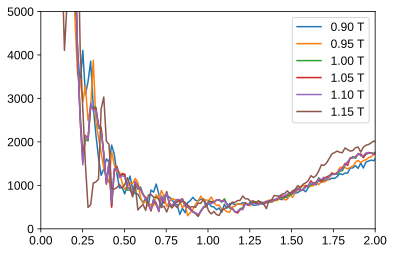

In [473]:
plt.figure()  # ok get rid of 1.05, 1.10 (indices 21, 22)
for i in range(6):
    plt.plot(nugate3938, R3938fan2[18+i, :], label='{:.2f} T'.format(bw5fan2[18+i]))
    
plt.legend()
plt.axis((0, 2, 0, 5000))

In [474]:
indices = [i not in (21, 22) for i in range(len(bw5fan2))]  # delete 1.05, 1.10
R3938fan2func = RectBivariateSpline(nugate3938, bw5fan2[indices], R3938fan2[indices, :].T, kx=1, ky=1)

In [475]:
nugate3938[-1]

5.223529411764707

(0.0, 4.0)

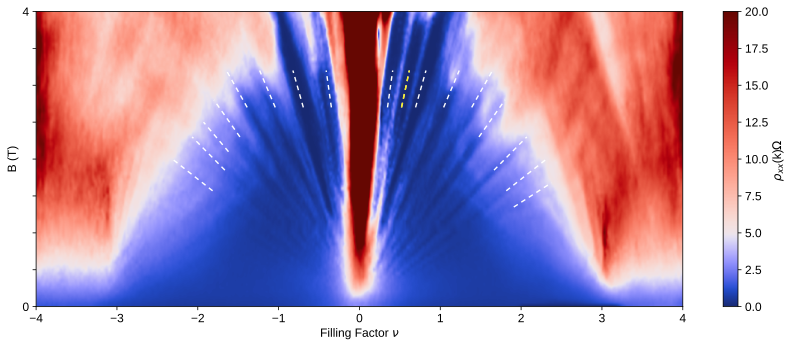

In [476]:
x = np.linspace(-5.75, 5.22, 1000)
y = np.linspace(0, 7, 1000)
R3938int = gaussian_filter(R3938fan2func(x, y).T, (0.8, 0.8))/1000

plt.figure(figsize=(12, 5))
plt.pcolormesh(x, y, R3938int, cmap=cc.cm.diverging_bwr_20_95_c54, norm=TwoSlopeNorm(5, 0, 20), rasterized=True)
plt.colorbar(label=r'$\rho$' + '$_{xx}$ (k$\Omega$)')
plt.xlabel(r'Filling Factor $\nu$')
plt.ylabel('B (T)')
plt.yticks(np.arange(0, 4.5, 0.5), [0] + ['']*7 + [4])
# ax.set_title('39-38')
# p2 = ax[1].pcolormesh(gw5fan2, bw5fan2, R3837fan2/1000, cmap=cc.cm.linear_kryw_5_100_c64, norm=TwoSlopeNorm(8, -2, 50))
# plt.colorbar(p2, ax=ax[1])
# ax[1].set_title('38-37')
plt.tight_layout()

sl = 12.2*Vgatefull/4
b = 0

Bl = 3.2
Bs = 2.7
LW = 1.4
dashes = (3.4, 3)
oddcolor = tuple(np.array([255, 243, 15])/255)
for i in [-8, -6, -4, -2, 2, 3, 4, 6, 8]:
    x = np.array([(Bs*i - b)/sl, (Bl*i - b)/sl])
    plt.plot(x, (x*sl + b)/i, color='white', lw=LW, dashes=dashes)
    
for i in [3]:
    x = np.array([(Bs*i - b)/sl, (Bl*i - b)/sl])
    plt.plot(x, (x*sl + b)/i, color=oddcolor, lw=LW, dashes=dashes)

Bl = 2.8
Bs = 2.3
for i in [-10, 10]:
    x = np.array([(Bs*i - b)/sl, (Bl*i - b)/sl])
    plt.plot(x, (x*sl + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 2.5
Bs = 2.1
for i in [-12]:
    x = np.array([(Bs*i - b)/sl, (Bl*i - b)/sl])
    plt.plot(x, (x*sl + b)/i, color='white', lw=LW, dashes=dashes)

Bl = 2.3
Bs = 1.85
for i in [-14, 14]:
    x = np.array([(Bs*i - b)/sl, (Bl*i - b)/sl])
    plt.plot(x, (x*sl + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 2.0
Bs = 1.57
for i in [-18, 18]:
    x = np.array([(Bs*i - b)/sl, (Bl*i - b)/sl])
    plt.plot(x, (x*sl + b)/i, color='white', lw=LW, dashes=dashes)
    
Bl = 1.68
Bs = 1.35
for i in [22]:
    x = np.array([(Bs*i - b)/sl, (Bl*i - b)/sl])
    plt.plot(x, (x*sl + b)/i, color='white', lw=LW, dashes=dashes)
    
# [-18, -15, -14, -12, -10, -8, -6, -4, -2, -1, 2, 3, 4, 6, 8, 10, 14, 18, 22]
    
# # negative full filling
# Vfn = -4.87
# bfn = -Vfn*sl

# for i in [-9, -7, -5, 2, 4, 6, 8]:
#     x = np.array([(Bs*i - bfn)/sl, (Bl*i - bfn)/sl])
#     ax.plot(x, (x*sl + bfn)/i, color='white', lw=0.5)

# # why is this filling different from negative full filling?
# Vfp = 5.33
# bfp = -Vfp*sl

# for i in [-10, -6, -4, -2, 2, 3, 4, 6, 8]:
#     x = np.array([(Bs*i - bfp)/sl, (Bl*i - bfp)/sl])
#     ax.plot(x, (x*sl + bfp)/i, color='white', lw=0.5)
    
# Vfph = (5.33-V0)/2 + V0
# bfph = -Vfph*sl

# for i in [1, 3, 5]:  # should this be on the maxima (even) or minima (odd)? 
#     x = np.array([(Bs*i - bfph)/sl, (Bl*i - bfph)/sl])
#     ax.plot(x, (x*sl + bfph)/i, color='white', lw=0.5)

# maybe... A little greater than 3/4 filling, it seems
# Vfp3q = 4.12
# bfp3q = -Vfp3q*sl

# for i in [-7, -4, -3, -2, -1]:
#     x = np.array([(Bs*i - bfp3q)/sl, (Bl*i - bfp3q)/sl])
#     ax.plot(x, (x*sl + bfp3q)/i, color='white', lw=0.5)
    
# ax.vlines((-4.9, 5.45), 0, 7, color='white', lw = 0.7)

# ax.vlines((V0 - Vgatefull, V0, V0 + Vgatefull), 0, 7, color='black', lw=0.9)
    
plt.xlim(-4, 4)
plt.ylim(0, 4)
# ax[0].axis((0.3302532331144912, 6.954736397141387, 0.45718093968676854, 6.944018660446515))

# plt.savefig(figfile + 'W5_0p8_Fandiagram_to4T_guidelines.svg', dpi=300, bbox_inches='tight')

## T dependence

In [477]:
def SCdomepts(x, R, T, Tidx, xidxstart, xidxstop):
    print('Normalizing temperature', T[Tidx])
    xx = []
    yy = []
    for i in np.arange(xidxstart, xidxstop):
        norm_T = R[:,i]/R[Tidx,i]
        ss = -1
        for j in np.arange(norm_T.shape[0]):
            if norm_T[j]>0.5:
                ss=1
                break
        if ss>0:
            xx.append(x[i])
            yy.append(T[j])

    f = interp1d( xx[::2], yy[::2], kind = 'linear')
    xnew = np.linspace(xx[0],xx[-2], 100)
    return xnew, f(xnew)

In [478]:
dT0 = qc.load_data('data/2020-02-24/#004_W5_basetemp_0p5nA_865_40-39_830_39-38_12-31-17')
dT1 = qc.load_data('data/2020-02-24/#005_W5_basetemp_0p5nA_865_40-39_830_39-38_gateTsweepto1K_0p5nA_16-49-36')
dT2 = qc.load_data('data/2020-02-24/#006_W5_basetemp_865_40-39_830_39-38_gateTsweep1p1to1p4K_0p5nA_22-57-43')
dT3 = qc.load_data('data/2020-02-25/#001_W5_basetemp_865_40-39_830_39-38_gateTsweep1p5to2K_0p5nA_00-19-25')

In [479]:
# electrodes 30-39
temps3938 = np.concatenate(([0.025], dT1.triton_pid_setpoint_set[:], dT2.triton_pid_setpoint_set[:], dT3.triton_pid_setpoint_set[:]))
RxxT3938 = np.vstack((npd.Rxxfromdata(dT0, 0.5e-9, 'lockin830'), npd.Rxxfromdata(dT1, 0.5e-9, 'lockin830'), npd.Rxxfromdata(dT2, 0.5e-9, 'lockin830'), npd.Rxxfromdata(dT3, 0.5e-9, 'lockin830')))
gatesT3938 = dT0.srframe_volt_p1_set[:]
V0 = 0.34 - 0.05
Vgatefull = 5.175000000000001
nugateT3938 = np.interp(gatesT3938, [V0 - 6/4*Vgatefull, V0 + 6/4*Vgatefull], [-6, 6])
RxxT3938_func = RectBivariateSpline(nugateT3938, temps3938, RxxT3938.T, kx=1, ky=1)

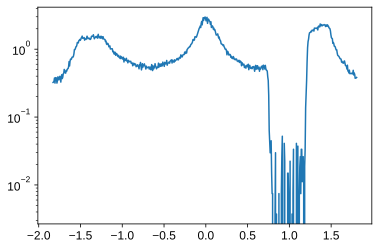

In [480]:
nfull = 1.504322970117718
# base temp sweep
nT3938 = np.interp(gatesT3938, [V0 - Vgatefull*6/4, V0 + Vgatefull*6/4], [-6/4*nfull, 6/4*nfull])
plt.figure()
plt.semilogy(nT3938, RxxT3938[0, :]/1000)


# np.savetxt(BaseTfile + 'W5_0p80_RxxvsN.txt', np.vstack((nT3938, RxxT3938[0, :])), fmt='%.8e', header='electron density (in 10^12 cm^-2) vs Rxx at base temp')

Normalizing temperature 2.0


Text(2.4, 0.12, 'SC')

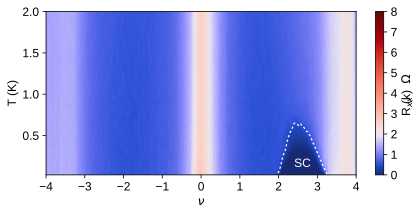

In [481]:
x = np.linspace(-4.86, 4.79, 1501)
y = np.linspace(0.025, 2, 800)
RxxT3938_int = gaussian_filter(RxxT3938_func(x, y).T, (0.8, 0.8))

plt.figure(figsize=(2*3.14961, 3.14961))
plt.pcolormesh(x, y, RxxT3938_int/1000, cmap=cc.cm.diverging_bwr_20_95_c54, norm=TwoSlopeNorm(vmin=0, vcenter=2, vmax=8), rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.ylabel('T (K)')
plt.xlabel('$\\nu$')
plt.xlim(-4, 4)
plt.yticks([0.5, 1, 1.5, 2])
plt.xticks(np.arange(-4, 5))
plt.tight_layout()

LW = 1.3
d = (1.7, 1.9)
# electron-side SC pocket############################### using normal temp of 
scx, scy = SCdomepts(nugateT3938, RxxT3938, temps3938, 30, 443, 530)
plt.plot(scx, gaussian_filter(scy, 1.3), linewidth=LW, color='white', linestyle='dashed', dashes=d)
plt.text(2.4, 0.12, 'SC', color='w')
##################################################

# plt.savefig(figfile + 'W5_0p8_3938_lowTdependence.svg', dpi=300, bbox_inches='tight')

In [482]:
nugateT3938[475]

2.4811594202898544

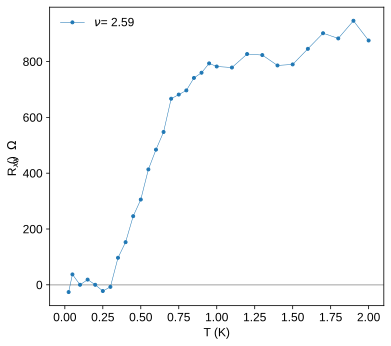

In [483]:
plt.figure(figsize=(6, 5.5))
indx = 482

l1 = plt.plot(temps3938, RxxT3938[:, indx], '.-', lw=0.5, label='$\\nu$ = {:.2f}'.format(nugateT3938[indx]))
xmin, xmax = -0.1, 2.1
plt.legend(frameon=False, loc='upper left')
plt.xlim(xmin, xmax)


plt.xlabel('T (K)')
plt.ylabel('R$_{xx}$ ($\Omega$)')
plt.hlines(0, xmin, xmax, color='gray', alpha=0.5)
# plt.savefig(figfile + 'W5_0p8_SCTlinecut.svg', dpi=300, bbox_inches='tight')

Tc determination

In [484]:
nugateT3938[474]

2.465700483091787

(-0.1, 2.0, -0.1, 1.0)

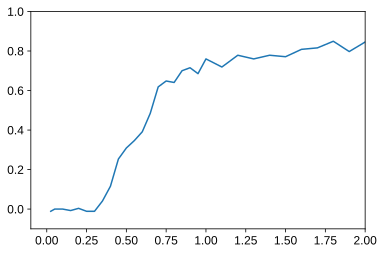

In [485]:
plt.figure()
plt.plot(temps3938, RxxT3938[:, 474]/1000) # use this one (blue)
# plt.plot(temps3938, RxxT3938[:, 484]/1000)
plt.axis((-0.1, 2, -0.1, 1))

In [486]:
def halfTc(temps, Rxx, n1, m1, n2, m2, pad=0.25):
    plt.plot(temps[n1:m1], Rxx[n1:m1])
    sl1, b1 = np.polyfit(temps[n1:m1], Rxx[n1:m1], 1)
    x1 = np.linspace(temps[n1] - pad, temps[m1] + pad, 3)
    plt.plot(x1, sl1*x1 + b1, 'k--', lw=0.7)

    plt.plot(temps[n2:m2], Rxx[n2:m2])
    sl2, b2 = np.polyfit(temps[n2:m2], Rxx[n2:m2], 1)
    x2 = np.linspace(temps[n2] - pad, temps[m2] + pad, 3)
    plt.plot(x2, sl2*x2 + b2, 'k--', lw=0.7)
    
    RN = (b1*sl2 - b2*sl1)/(sl2 - sl1)
    Tc = np.interp(RN/2, Rxx[n1:m1+5], temps[n1:m1+5])
    Tc10 = np.interp(RN*0.1, Rxx[n1-5:m1+5], temps[n1-5:m1+5])
    Tc90 = np.interp(RN*0.9, Rxx[n1:m1+8], temps[n1:m1+8])
    return Tc, Tc10, Tc90, RN/2


0.5397972823946359 0.36797978138225046 0.6968428478487328 0.33885215916659517


(-0.1, 2.0, -0.1, 1.0)

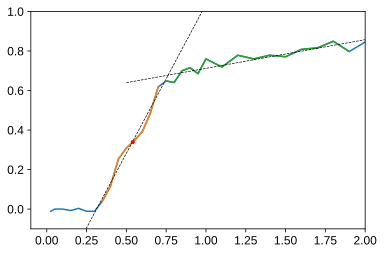

In [487]:
plt.figure()

xmin, xmax = -0.1, 2
ymin, ymax = -0.1, 1
# for i in range(9):
plt.plot(np.ma.masked_outside(temps3938, xmin, xmax), np.ma.masked_outside(RxxT3938[:, 474]/1000, ymin, ymax))

Tc, Tc10, Tc90, Rhalf = halfTc(temps3938, RxxT3938[:, 474]/1000, 7, 15, 15, 30)
plt.plot([Tc], [Rhalf], '.r')
print(Tc, Tc10, Tc90, Rhalf)

plt.axis((xmin, xmax, ymin, ymax))

### attempting to blend the PPMS and triton data

In [488]:
dTw5_1 = qc.load_data('../../PPMS/qcodes_data/data/2020-01-12/#002_W5_lockin1_14-3_lockin2_4-5_gsweep_1.8K_10nA_15-00-08')  # different gate points
dTw5_2 = qc.load_data('../../PPMS/qcodes_data/data/2020-01-12/#003_W5_lockin1_14-3_lockin2_4-5_Temp2to20K_15nA_15-09-42')
dTw5_3 = qc.load_data('../../PPMS/qcodes_data/data/2020-01-12/#004_W5_lockin1_14-3_lockin2_4-5_Temp22to118_15nA_19-50-02')
dTw5_4 = qc.load_data('../../PPMS/qcodes_data/data/2020-01-14/#001_W5_lockin1_14-3_lockin2_4-5_Temp120to240_15nA_10-47-06')  # different gate points

In [488]:
# Running this line instead of the above should make it work with the data repository
dTw5_1 = qc.load_data('PPMS/qcodes_data/data/2020-01-12/#002_W5_lockin1_14-3_lockin2_4-5_gsweep_1.8K_10nA_15-00-08')  # different gate points
dTw5_2 = qc.load_data('PPMS/qcodes_data/data/2020-01-12/#003_W5_lockin1_14-3_lockin2_4-5_Temp2to20K_15nA_15-09-42')
dTw5_3 = qc.load_data('PPMS/qcodes_data/data/2020-01-12/#004_W5_lockin1_14-3_lockin2_4-5_Temp22to118_15nA_19-50-02')
dTw5_4 = qc.load_data('PPMS/qcodes_data/data/2020-01-14/#001_W5_lockin1_14-3_lockin2_4-5_Temp120to240_15nA_10-47-06')  # different gate points

In [488]:
Ts_w5 = np.concatenate(([1.8], dTw5_2.ppms_temperature_set_stable_set[:], dTw5_3.ppms_temperature_set_stable_set[:]))
gw5T = dTw5_2.srdc_volt_set[0, :]
# use 14-03 (ppms) and 39-38 (triton)
Rxx1403T = np.vstack((npd.Rxxfromdata(dTw5_2, 15e-9, instrument='lockin1'), npd.Rxxfromdata(dTw5_3, 15e-9, instrument='lockin1')))
Rxx0405T = np.vstack((npd.Rxxfromdata(dTw5_2, 15e-9, instrument='lockin2'), npd.Rxxfromdata(dTw5_3, 15e-9, instrument='lockin2')))

In [489]:
Ts_w5.shape

(69,)

In [490]:
Rxx1403T.shape

(68, 641)

In [491]:
# assuming the same as the fridge landau fan on 39-38
Vgatefull = 5.1
V01 = 0.25
nugateT = np.interp(gw5T, [V01 - Vgatefull*9/4, V01 + Vgatefull*9/4], [-9, 9])

Rxx1403Tfunc = RectBivariateSpline(nugateT, Ts_w5[1:], Rxx1403T.T)
Rxx1403Tsamenu = Rxx1403Tfunc(nugateT3938, Ts_w5[2:]).T
Tcomb = np.concatenate((temps3938, Ts_w5[2:]))
Rxxcomb = np.vstack((RxxT3938, Rxx1403Tsamenu))

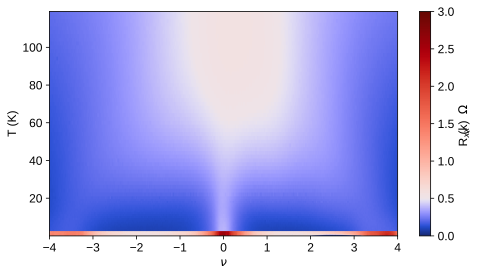

In [493]:
# the scale is strange. Doesn't correspond between the PPMS and Triton. about a factor of 7-10 off.
plt.figure(figsize=(7, 4))
plt.pcolormesh(nugateT3938, Tcomb, Rxxcomb/1000, cmap=cc.cm.diverging_bwr_20_95_c54, norm=TwoSlopeNorm(vmin=0, vcenter=0.5, vmax=3), rasterized=True)
plt.colorbar(label='R$_{xx}$ (k$\Omega$)')
plt.ylabel('T (K)')
plt.xlabel('$\\nu$')
plt.xlim(-4, 4)
# plt.yticks([0.5, 1, 1.5, 2])
plt.xticks(np.arange(-4, 5))
plt.tight_layout()

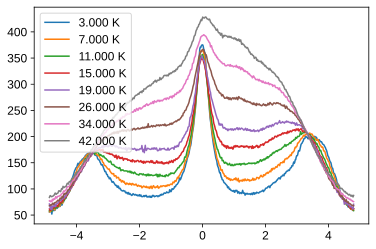

In [494]:
plt.figure()

for i in range(8):
    indx = 4*i
    plt.plot(nugateT3938, Rxx1403Tsamenu[indx, :], label='{:.3f} K'.format(Ts_w5[2:][indx]))
    
plt.legend()

Fit the electron-side peaks

In [495]:
# Just nu = +1 for this one
temps = Ts_w5[2:]
        
window = 15
ind1, ind2 = npd.val_to_index([0.92, 1.5], nugateT3938)      
startT1, endT1 = 12, len(temps)-37
T1 = []
nu1peakind = []
nu1peak = []
nu1peakR = []
for i in range(startT1, endT1):
    try:
        R = gaussian_filter(Rxx1403Tsamenu[i, ind1:ind2]/1000, 0.6)
        nu1init = nugateT3938[ind1:ind2]
        sl, b = np.polyfit(nu1init, R, 1)
        Rsub = R - (sl*nu1init + b)
        pind = int(find_peaks(Rsub, prominence=0.003, distance=30)[0][0] + ind1)
        nu1peakind.append(pind)
#         nu1peak.append(nu1init[pind-ind1])
#         nu1peakR.append(R[pind-ind1]*1000)
        T1.append(temps[i])
#         nu1init2 = nugateT3938[pind-window:pind+window]
#         R2 = Rxx1403Tsamenu[i, pind-window:pind+window]
#         sl2, b2 = np.polyfit(nu1init2, R2, 1)
#         Rsub2 = R2 - (sl2*nu1init2 + b2)
#         a, b, c = np.polyfit(nu1init2, gaussian_filter(Rsub2, 1.4), 2)
        a, b, c = np.polyfit(nugateT3938[pind-window:pind+window], gaussian_filter(Rxx1403Tsamenu[i, pind-window:pind+window], 1.4), 2)
        xpeak = -b/(2*a)
        nu1peak.append(xpeak)
        nu1peakR.append(a*xpeak**2 + b*xpeak + c)
    except:
        print('problem with', i, pind)

0.92 is not a value in the array
Plotted 0.92 instead
1.50 is not a value in the array
Plotted 1.51 instead


(-0.5, 3.5)

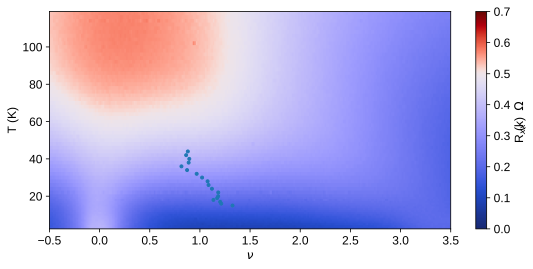

In [496]:
fig, ax = plt.subplots(1, 1, figsize=(9, 4))
norm = TwoSlopeNorm(0.5, 0, 0.7)
p = ax.pcolormesh(nugateT3938, temps, Rxx1403Tsamenu/1000, norm=norm, cmap=cc.cm.diverging_bwr_20_95_c54, rasterized=True)
ax.set_ylabel('T (K)')
ax.set_xlabel('$\\nu$')
fig.colorbar(p, ax=ax, label='R$_{xx}$ (k$\Omega$)')
# ax.plot(nu2peak, T2, '.')
ax.plot(nu1peak, T1, '.')
ax.set_xlim(-0.5, 3.5)

(-2.0, 4.0, 0.07, 0.6)

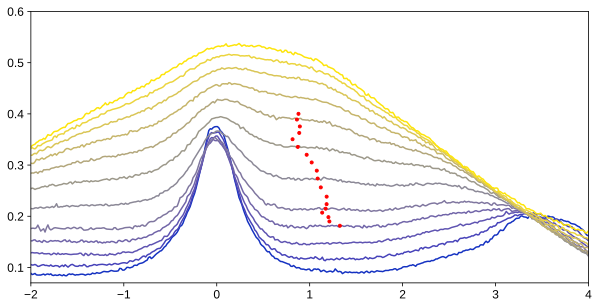

In [497]:
N = 12
colors = plt.get_cmap('cet_bjy')([i/(N-1) for i in range(N)])

fig, ax = plt.subplots(1, 1, figsize=(10, 5))
for i in range(N):
    indx = i*4
    ax.plot(nugateT3938, gaussian_filter(Rxx1403Tsamenu[indx, :]/1000, 0.3), color=colors[i], label='{:.2f} K'.format(temps[indx]))


ax.plot(nu1peak, np.array(nu1peakR)/1000, '.r')
# ax.plot(nu2peak, np.array(nu2peakR)/1000, '.r')
ax.axis((-2, 4, 0.07, 0.6))
# l = plt.legend()

In [498]:
# np.savetxt(Peakfile+'W5_0p80_nu1peaks.txt', np.vstack((T1, nu1peak, nu1peakR)).T, fmt='%.8e', header='columns: Temperatures (K), nu, Resistance (ohms)')

d$\rho$/dT

In [499]:
Ts_w5[2]

3.0

In [500]:
R1403func = RectBivariateSpline(nugateT3938, temps, Rxx1403Tsamenu.T, kx=1, ky=1)

In [501]:
nulin = np.linspace(-4.2, 4.2, 1001)
Tlin = np.linspace(3, 40, 280)
dT = Tlin[1] - Tlin[0]
R1403lin = Rxx1403Tfunc(nulin, Tlin).T
R1403deriv = np.gradient(gaussian_filter(R1403lin, (2, 2)), dT, axis=0)
sqs = 24.9/11.19

1.50 is not a value in the array
Plotted 1.50 instead
1.80 is not a value in the array
Plotted 1.80 instead
xints: [679, 714]
15.00 is not a value in the array
Plotted 14.94 instead
38.00 is not a value in the array
Plotted 38.01 instead
yints: [90, 264]
-2.00 is not a value in the array
Plotted -2.00 instead
-1.60 is not a value in the array
Plotted -1.60 instead
xints: [262, 310]
15.00 is not a value in the array
Plotted 14.94 instead
38.00 is not a value in the array
Plotted 38.01 instead
yints: [90, 264]


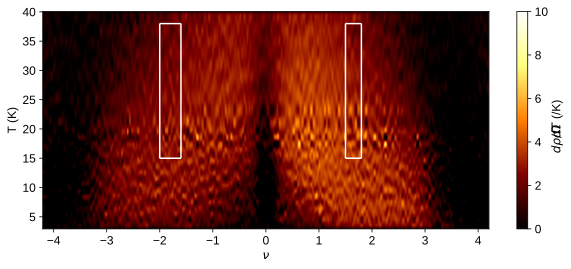

In [502]:
plt.figure(figsize=(10, 4))
plt.pcolormesh(nulin, Tlin, R1403deriv/sqs, cmap='afmhot', vmin=0, vmax=10, rasterized=True)
plt.colorbar(label='$d\\rho/dT$ ($\Omega$/K)')
plt.xlabel('$\\nu$')
plt.ylabel('T (K)')
plotbox(1.5, 1.8, 15, 38, nulin, Tlin, color='white')
plotbox(-2, -1.6, 15, 38, nulin, Tlin, color='white')

In [503]:
# electrons
np.average(R1403deriv[90:264, 679:714]/sqs), np.std(R1403deriv[90:264, 679:714]/sqs, ddof=1)

(2.9683562797361462, 0.6985689401440869)

In [504]:
# holes
np.average(R1403deriv[90:264, 262:310]/sqs), np.std(R1403deriv[90:264, 262:310]/sqs, ddof=1)

(2.4481319499256813, 0.4611943980129469)

## W5 fraunhofer-like pattern

In [505]:
df3938 = qc.load_data('data/2020-02-08/#012_W5_830_40-39_865_39-38_vbg3p4V_FraunhoferbaseT_0p5nA_22-13-39')  #3.4 Vbg
dvdi3938 = df3938.lockin865_X[:, :]/0.5e-9
curr3938 = df3938.srframe_volt_p5_set[0, :]*10
bf3938 = df3938.triton_field_set_stable_set[:]

In [506]:
V0 = 0.34
Vgatefull = 5.1
Vfraun3938 = 3.4
nufraun3938 = np.interp(Vfraun3938, [V0 - Vgatefull, V0 + Vgatefull], [-4, 4])
print(nufraun3938)

2.4000000000000012


Text(0, 0.5, 'B (mT)')

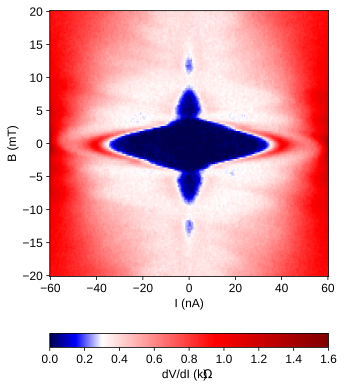

In [508]:
plt.figure(figsize=(5, 7))
plt.pcolormesh(curr3938, bf3938*1000, gaussian_filter(dvdi3938, (0.5, 0.5))/1000, cmap='seismic', norm=TwoSlopeNorm(vmin=0, vmax=1.6, vcenter=0.3), rasterized=True)
plt.colorbar(orientation='horizontal', label='dV/dI (k$\Omega$)')
plt.xlabel('I (nA)')
plt.ylabel('B (mT)')

# plt.savefig(figfile+'M05_0p8_3938_fraunhofer.svg', dpi=300, bbox_inches='tight')

# All angles CNP T-dependence

Also need to run through 

In [509]:
nugateT3938[315]

0.007729468599033673

In [514]:
temps = np.concatenate(([0.025], dtemp_1.triton_pid_setpoint_set, dtemp_2.triton_pid_setpoint_set[:], dtemp_3.triton_pid_setpoint_set, dtemp_4.triton_pid_setpoint_set[:], dtemp_5.triton_pid_setpoint_set, dtemp_6.triton_pid_setpoint_set[:], dtemp_7.triton_pid_setpoint_set[:]))

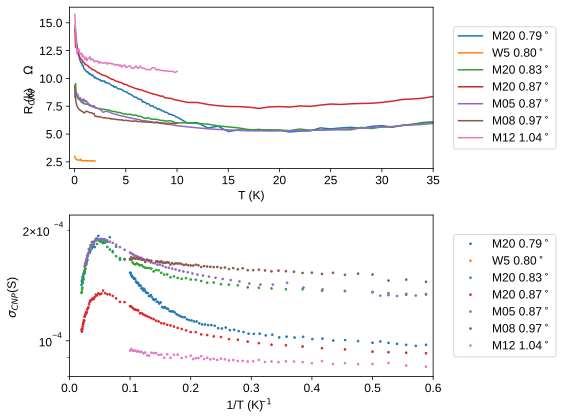

In [516]:
msize = 3.5
fig, ax = plt.subplots(2, 1, figsize=(8, 6))
ax[0].plot(T2116, RxxT2116corr[:, 239]/1000, label='M20 0.79$^\circ$')
ax[0].plot(temps3938, RxxT3938[:, 313]/1000, label='W5 0.80$^\circ$')
ax[0].plot(temps, R1615corr[:, 262]/1000, label='M20 0.83$^\circ$')
ax[0].plot(temps, R1514corr[:, 262]/1000, label='M20 0.87$^\circ$')
ax[0].plot(Tsm05, Rm05T[:, 111]/1000, label='M05 0.87$^\circ$')
ax[0].plot(Tall3837, R3837_all_2[:, 215]/1000, label='M08 0.97$^\circ$')
ax[0].plot(T2022, Rxx2022Tcorr[:, 208]/1000, label='M12 1.04$^\circ$')
ax[0].legend(bbox_to_anchor=(1.04, 0.5), loc='center left')
ax[0].set_xlim(-0.5, 35)
ax[0].set_xlabel('T (K)')
ax[0].set_ylabel('R$_{CNP}$ (k$\Omega$)')

ax[1].semilogy(1/T2116, 1/RxxT2116corr[:, 239], '.', label='M20 0.79$^\circ$', ms=msize)
ax[1].semilogy(1/temps3938, 1/RxxT3938[:, 313], '.', label='W5 0.80$^\circ$', ms=msize)
ax[1].semilogy(1/temps, 1/R1615corr[:, 262], '.', label='M20 0.83$^\circ$', ms=msize)
ax[1].semilogy(1/temps, 1/R1514corr[:, 262], '.', label='M20 0.87$^\circ$', ms=msize)
ax[1].semilogy(1/Tsm05, 1/Rm05T[:, 111], '.', label='M05 0.87$^\circ$', ms=msize)
ax[1].semilogy(1/Tall3837, 1/R3837_all_2[:, 215], '.', label='M08 0.97$^\circ$', ms=msize)
ax[1].semilogy(1/T2022, 1/Rxx2022Tcorr[:, 208], '.', label='M12 1.04$^\circ$', ms=msize)
ax[1].set_xlim(0, 0.6)
ax[1].set_ylim(8e-5, 2.2e-4)
ax[1].set_xlabel('1/T (K$^{-1}$)')
ax[1].set_ylabel('$\sigma_{CNP}$ (S)')
ax[1].legend(bbox_to_anchor=(1.04, 0.5), loc='center left')

plt.tight_layout()

# plt.savefig(figfile + 'alldevices_CNPTdependence.svg', dpi=300, bbox_inches='tight')